In [16]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import PIL
import tensorflow as tf
import gc

from tensorflow.keras.models import Sequential
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Activation, MaxPooling2D, BatchNormalization, LeakyReLU
from tensorflow.keras.layers import Convolution2D
from tensorflow.keras.layers import AveragePooling2D
from tensorflow.keras.layers import UpSampling2D
from tensorflow.keras.layers import Reshape
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Input
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.optimizers import SGD
from utils import *
from deep_prior_networks import *
import tensorflow.keras.backend as K
from glob import glob
import sigpy as sp
import sigpy.mri as mr
import ipdb
import cv2

In [2]:
config = tf.ConfigProto( device_count = {'GPU': 1 , 'CPU': 56} ) 
config.gpu_options.allow_growth=True
sess = tf.Session(config=config) 
K.set_session(sess)

[[-0.00687822  0.00251125 -0.012745   ... -0.00317923 -0.01673397
  -0.02525257]
 [ 0.00556544  0.00496424 -0.00449156 ...  0.00839488  0.00216777
   0.00804468]
 [ 0.00190705 -0.00636549  0.00200749 ... -0.00455054  0.00174494
   0.02197361]
 ...
 [-0.0072114   0.00739723  0.00743667 ... -0.00213037 -0.00613134
  -0.00454196]
 [ 0.00334521 -0.00897029 -0.00200945 ...  0.00271241 -0.02243437
  -0.01204164]
 [ 0.00691409 -0.01401529 -0.00566125 ...  0.01734439  0.00106629
   0.00438841]]
[[-0.32648234 -0.28780139 -0.3506512  ... -0.31124397 -0.3670842
  -0.40217751]
 [-0.27521931 -0.27769603 -0.31665025 ... -0.26356314 -0.28921641
  -0.26500581]
 [-0.29029045 -0.3243701  -0.2898767  ... -0.31689324 -0.29095829
  -0.20762408]
 ...
 [-0.32785491 -0.26767305 -0.26751059 ... -0.30692305 -0.32340548
  -0.31685788]
 [-0.28436582 -0.33510086 -0.3064249  ... -0.2869727  -0.39056761
  -0.34775364]
 [-0.26966344 -0.35588429 -0.32146889 ... -0.22669467 -0.29375409
  -0.28006821]]


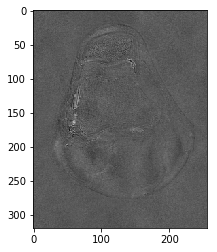

-1.0 1.0


(320, 256, 1)

In [3]:

img = get_image_old2('./data/test_img_slices/19_100.ra') # same - for linux
minv = np.min(img[:, :, 0])
maxv = np.max(img[:, :, 0])
normalized_img = np.expand_dims(-1 + (2 * (np.array(img[:, :, 0] - minv) / (maxv - minv))), 2)

minv = np.min(img[:, :, 1])
maxv = np.max(img[:, :, 1])
normalized_img = np.expand_dims(-1 + (2 * (np.array(img[:, :, 1] - minv) / (maxv - minv))), 2)

plt.imshow(normalized_img[:, :, 0], cmap='gray')
#plt.imshow(img[:, :,1], cmap='gray')
print(img[:, :,1])
print(normalized_img[:, :, 0])
plt.show()
minv = np.min(normalized_img[:, :, 0])
maxv = np.max(normalized_img[:, :, 0])
print(minv, maxv)
image_shape = normalized_img.shape  
image_shape

In [2]:
preprocess = lambda x : x / 127 - 1
deprocess  = lambda x :((x + 1) * 127).astype(np.uint8)
def get_image_normalized(index, plot=False):
    data = glob("./data/test_img_slices/*.ra")
    img = get_image_old2('./data/test_img_slices/19_{}.ra'.format(index)) # same - for linux
    minv = np.min(img[:, :, 0])
    maxv = np.max(img[:, :, 0])
    normalized_img = np.expand_dims(-1 + (2 * (np.array(img[:, :, 0] - minv) / (maxv - minv))), 2)
    if plot:
        plt.imshow(normalized_img[:, :, 0], cmap='gray')
        plt.show()
    minv = np.min(normalized_img[:, :, 0])
    maxv = np.max(normalized_img[:, :, 0])
    #print(minv, maxv)
    return normalized_img

def get_batch_normalized(indices):
    return np.array([get_image_normalized(ind) for ind in indices])

def get_brain_normalized():
    image = cv2.imread('./Notes/brain.png')
    return preprocess(image)[:, :, 0:1]

def get_subsampled_normalized(normalized_img, subs, plot=False):
    mask_files = glob("./masks/gen_masks/{}_0*".format(subs))
    mask_files = [np.fft.fftshift(np.load(m)) for m in mask_files]
    mask = mask_files[0]
    new_img = np.fft.ifft2(np.multiply(np.fft.fft2(normalized_img[:, :, 0]), mask)).astype(float)
    minv = np.min(new_img)
    maxv = np.max(new_img)
    normalized_new_img = np.expand_dims(-1 + (2 * (new_img - minv) / (maxv - minv)), 2)
    if plot:
        plt.imshow(normalized_new_img[:, :, 0], cmap='gray')
        plt.show()
    #print(np.min(normalized_new_img))
    #print(np.max(normalized_new_img))
    return normalized_new_img

In [19]:
mask_files = glob("./masks/gen_masks/{}_0*".format(4))
mask_files = [np.fft.fftshift(np.load(m)) for m in mask_files]
mask = mask_files[0]
mask.shape

(320, 256)

In [3]:
def recon_loss_L1_2chan_fixed2(y_true, y_pred):
    mask_files = glob("./masks/gen_masks/4_0*")
    mask_files = [np.fft.fftshift(np.load(m)) for m in mask_files]
    mask = tf.cast(mask_files[0] , dtype=tf.complex64)
    y_pred = tf.cast(tf.squeeze(y_pred, axis=0), dtype=tf.complex64)
    fft_img = tf.fft2d(y_pred[:, :, 0] + 1j*y_pred[:, :, 1])
    masked = tf.multiply(fft_img, mask)
    ifft = tf.ifft2d(masked)
    
    #squeeze_ifft = tf.cast(tf.stack([tf.real(ifft), tf.imag(ifft)], axis=2) , tf.complex64)
    squeeze_ytrue =tf.cast( tf.squeeze(y_true, axis=0) , dtype=tf.complex64)
    
   # ipdb.set_trace()
    squeeze_ifft = ifft
    imag_ytrue = squeeze_ytrue[: ,: , 0] + 1j * squeeze_ytrue[: ,: , 1]

    
    
    subtract = tf.cast(squeeze_ifft - squeeze_ytrue , tf.complex64)
    conj = tf.cast(tf.real(subtract), dtype=tf.complex64) -  1j * tf.cast(tf.imag(subtract), dtype=tf.complex64)
    loss = K.mean(tf.real(tf.multiply(subtract , conj)) , axis=-1)
    return loss






In [4]:
def recon_loss_L1_2chan_fixed(y_true, y_pred):
    mask_files = glob("./masks/gen_masks/4_0*")
    mask_files = [np.fft.fftshift(np.load(m)) for m in mask_files]
    mask = tf.cast(mask_files[0] , dtype=tf.complex64)
    y_pred = tf.cast(tf.squeeze(y_pred, axis=0), dtype=tf.complex64)
    fft_img = tf.fft2d(y_pred[:, :, 0] + 1j*y_pred[:, :, 1])
    masked = tf.multiply(fft_img, mask)
    ifft = tf.ifft2d(masked)
    squeeze_ifft = tf.cast(tf.stack([tf.real(ifft), tf.imag(ifft)], axis=2) , tf.complex)
    squeeze_ytrue = tf.cast(tf.squeeze(y_true, axis=0) , tf.complex64)

    subtract = tf.cast(squeeze_ifft - squeeze_ytrue , tf.complex64)
    conj = tf.cast(tf.real(subtract), dtype=tf.complex64) -  1j * tf.cast(tf.imag(subtract), dtype=tf.complex64)
    loss = K.mean(tf.real(tf.multiply(subtract , conj)) , axis=-1)
    print(loss.shape)
    return loss
    
def recon_loss_L1_2chan(y_true, y_pred):
    mask_files = glob("./masks/gen_masks/4_0*")
    mask_files = [np.fft.fftshift(np.load(m)) for m in mask_files]
    mask = mask_files[0]
    y_pred = tf.cast(tf.squeeze(y_pred, axis=0), dtype=tf.complex64)
    fft_img = tf.fft2d(y_pred[:, :, 0] + 1j*y_pred[:, :, 1])
    masked = tf.multiply(fft_img, mask)
    ifft = tf.ifft2d(masked)
    squeeze_ifft = tf.stack([tf.real(ifft), tf.imag(ifft)], axis=2)
    squeeze_ytrue = tf.squeeze(y_true, axis=0)
    return K.mean(K.abs(squeeze_ifft - squeeze_ytrue), axis=-1)    
    
    return loss # + 0.0000000001 * tf.norm(tf.reshape(squeeze_ifft, [-1]), ord=1) #+ 0.0000001 * tf.image.total_variation(tf.expand_dims(squeeze_ifft, -1))
def recon_loss_L1(y_true, y_pred):
    mask_files = glob("./masks/gen_masks/4_0*")
    mask_files = [np.fft.fftshift(np.load(m)) for m in mask_files]
    mask = mask_files[0]
    y_pred = tf.squeeze(y_pred, axis=[0, 3])
    fft_img = tf.fft2d(tf.cast(y_pred, dtype=tf.complex64))
    masked = tf.multiply(fft_img, mask)
    ifft = tf.cast(tf.ifft2d(masked), dtype=tf.float32)
    squeeze_ifft = ifft #tf.squeeze(ifft, axis=0)
    squeeze_ytrue = tf.squeeze(y_true, axis=[0, 3])
    return K.mean(K.abs(squeeze_ifft - squeeze_ytrue), axis=-1) # + 0.0000000001 * tf.norm(tf.reshape(squeeze_ifft, [-1]), ord=1) #+ 0.0000001 * tf.image.total_variation(tf.expand_dims(squeeze_ifft, -1))
                           
def recon_loss_L2_2chan(y_true, y_pred):
    mask_files = glob("./masks/gen_masks/4_0*")
    mask_files = [np.fft.fftshift(np.load(m)) for m in mask_files]
    mask = mask_files[0]
    y_pred = tf.cast(tf.squeeze(y_pred, axis=0), dtype=tf.complex64)
    fft_img = tf.fft2d(y_pred[:, :, 0] + 1j*y_pred[:, :, 1])
    masked = tf.multiply(fft_img, mask)
    ifft = tf.ifft2d(masked)
    squeeze_ifft = tf.stack([tf.real(ifft), tf.imag(ifft)], axis=2)
    squeeze_ytrue = tf.squeeze(y_true, axis=0)
    return K.mean(K.square(squeeze_ifft - squeeze_ytrue), axis=-1) # + 0.0000000001 * tf.norm(tf.reshape(squeeze_ifft, [-1]), ord=1) #+ 0.0000001 * tf.image.total_variation(tf.expand_dims(squeeze_ifft, -1))

L1_loss = lambda x, y : (abs(x - y)).mean(axis=None)
L2_loss = lambda x, y : ((x - y)**2).mean(axis=None)
    

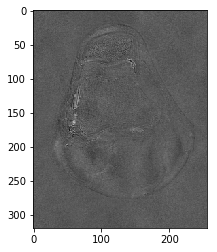

In [24]:
img = get_image_old2('./data/test_img_slices/19_{}.ra'.format(100))
plt.imshow(img[: , :, 1] , cmap='gray')

In [5]:
def get_image_normalized_2chan(index, plot=False):
    data = glob("./data/test_img_slices/*.ra")
    img = get_image_old2('./data/test_img_slices/19_{}.ra'.format(index)) # same - for linux
    minv = np.min(img[:, :, 0])
    maxv = np.max(img[:, :, 0])
    normalized_img = np.zeros((320, 256, 2))
    
    normalized_img_real = -1 + (2 * (np.array(img[:, :, 0] - minv) / (maxv - minv)))
    normalized_img[:, :, 0] = normalized_img_real
    
    
    minv = np.min(img[:, :, 1])
    maxv = np.max(img[:, :, 1])
    
    normalized_img_imag = -1 + (2 * (np.array(img[:, :, 1] - minv) / (maxv - minv)))
    normalized_img[:, :, 1] = normalized_img_imag
    
    
    #normalized_img[:, :, 1] = img[:, :, 1]
    if plot:
        plt.imshow(np.sqrt(normalized_img[:, :, 0] ** 2 + normalized_img[:, :, 1] ** 2), cmap='gray')
        plt.show()
    minv = np.min(normalized_img[:, :, 0])
    maxv = np.max(normalized_img[:, :, 0])
    #print(minv, maxv)
    return normalized_img

def get_batch_normalized_2chan(indices):
    return np.array([get_image_normalized_2chan(ind) for ind in indices])


def get_subsampled_normalized_2chan(normalized_img, subs, plot=False):
    mask_files = glob("./masks/gen_masks/{}_0*".format(subs))
    mask_files = [np.fft.fftshift(np.load(m)) for m in mask_files]
    mask = mask_files[0]
    new_img = np.fft.ifft2(np.multiply(np.fft.fft2(normalized_img[:, :, 0]), mask))
    minv = np.min(np.real(new_img))
    maxv = np.max(np.real(new_img))
    normalized_new_img = np.zeros((320, 256, 2))
    normalized_new_img_real = -1 + (2 * (np.real(new_img) - minv) / (maxv - minv))
    normalized_new_img[:, :, 0] = normalized_new_img_real
    normalized_new_img[:, :, 1] = np.imag(new_img) 
    if plot:
        plt.imshow(np.sqrt(normalized_new_img[:, :, 0] ** 2 + normalized_new_img[:, :, 1] ** 2), cmap='gray')
        plt.show()
    #print(np.min(normalized_new_img))
    #print(np.max(normalized_new_img))
    return normalized_new_img


In [6]:

def get_subsampled_normalized_2chan2(normalized_img, subs, plot=False):
    mask_files = glob("./masks/gen_masks/{}_0*".format(subs))
    mask_files = [np.fft.fftshift(np.load(m)) for m in mask_files]
    mask = mask_files[0]   
    
    fft_img = np.fft.fft2(normalized_img[:, :, 0] + 1j * normalized_img[:, :, 1])
    masked_img = np.multiply(fft_img , mask)
    new_img = np.fft.ifft2(masked_img)
    minv = np.min(np.real(new_img))
    maxv = np.max(np.real(new_img))
    normalized_new_img = np.zeros((320, 256, 2))
    normalized_new_img_real = -1 + (2 * (np.real(new_img) - minv) / (maxv - minv))
    normalized_new_img[:, :, 0] = np.real(new_img)
    normalized_new_img[:, :, 1] = np.imag(new_img)
    
    
    
    if plot:
        plt.imshow(np.sqrt(normalized_new_img[:, :, 0] ** 2 + normalized_new_img[:, :, 1] ** 2), cmap='gray')
        plt.show()
    #print(np.min(normalized_new_img))
    #print(np.max(normalized_new_img))
    return normalized_new_img


In [32]:

def train_network_2chan(network, noise, y, epochs, iterations, ground_truth, losses, jitter_schedule = [0], plot=False, batch_size=1):
    #base_image = np.expand_dims(noise, 0) 
    base_image = np.expand_dims(noise, 0) if np.shape(noise)[0] == 320 else noise
    y_image = np.expand_dims(y, 0) if np.shape(noise)[0] == 320 else y
    fit_params = {
        'x': base_image,
        'y': y_image, 
        'epochs': epochs,
        'batch_size': batch_size,
        'verbose': 0
    }
    if plot:
        plt.axis('off')
        plt.title('Iteration 0')
        plt.imshow(np.sqrt(base_image[0, :, :, 0]**2 + base_image[0, :, :, 1]**2), cmap='gray')
        plt.show()
        plt.imshow(np.sqrt(y_image[0, :, :, 0]**2 + y_image[0, :, :, 1]**2), cmap='gray')
        plt.show()
        
    results = np.empty(base_image.shape)
    all_losses = [[] for _ in range(len(losses))]
    
    if len(jitter_schedule) == 1:
        jitter = jitter_schedule[0]
        jitter_schedule = [jitter] * iterations

    noise_size = (batch_size, 320, 256, 2)
    for i in range(iterations):
        fit_params['x'] += jitter_schedule[i] * (np.random.random(size = noise_size) * 2 - 1) #(1, ) + np.shape(noise)
        network.fit(**fit_params)
        output = network.predict(base_image)
        results = np.append(results, output, axis=0)
        for j in range(len(losses)):
            all_losses[j].append(losses[j](output, ground_truth))

        print(all_losses[-1][-1])
        if plot:
            plt.axis('off')
            plt.title('Iteration '+ str((i+1)*fit_params['epochs']))
           
            plt.imshow(np.sqrt(output[0][:, :, 0] ** 2 + output[0][:, :, 1] ** 2), cmap='gray')
            plt.show()
           
            get_subsampled_normalized_2chan2( output[0] , 4 , True)
            
            plt.show()
    return results, all_losses, fit_params['x']

In [49]:
mask_files = glob("./masks/gen_masks/4_0*")
mask_files = [np.fft.fftshift(np.load(m)) for m in mask_files]
mask_files[0]

array([[1.+0.j, 1.+0.j, 1.+0.j, ..., 1.+0.j, 1.+0.j, 1.+0.j],
       [1.+0.j, 1.+0.j, 1.+0.j, ..., 1.+0.j, 1.+0.j, 1.+0.j],
       [1.+0.j, 1.+0.j, 1.+0.j, ..., 1.+0.j, 1.+0.j, 1.+0.j],
       ...,
       [1.+0.j, 1.+0.j, 1.+0.j, ..., 1.+0.j, 1.+0.j, 1.+0.j],
       [1.+0.j, 1.+0.j, 1.+0.j, ..., 1.+0.j, 1.+0.j, 1.+0.j],
       [1.+0.j, 1.+0.j, 1.+0.j, ..., 1.+0.j, 1.+0.j, 1.+0.j]])

In [28]:
trials = 1
all_results = [[] for i in range(4)] # same image, diff image, 2 diff, 4 diff
for i in range(trials):
    noisy = np.random.random(size=(320, 256, 2)) * 2 - 1
    test_noise = np.random.random(size=(320, 256, 2)) * 2 - 1
    epochs = 20
    epochs1 = 20
    iters1 = 3
    iters = 3#50

    batch_size = 1
    print('start ' , i)
    noise = np.array([noisy for _ in range(batch_size)])
    jit_sched = [0.1 if k < iters // 2 else 0.01 for k in range(iters1)]
    
    normalized_img = get_batch_normalized_2chan([100])
    normalized_subsample_img = get_subsampled_normalized_2chan(get_image_normalized_2chan(100), 4)
    
    autoencoder = define_network_4_2chan(verbose=False)
    autoencoder.compile(Adam(1e-3), loss = recon_loss_L1_2chan_fixed)
    results, losses1, new_noise = train_network_2chan(autoencoder, noise, normalized_subsample_img, epochs1, iters1, normalized_img, [L1_loss , L2_loss], jitter_schedule=jit_sched, plot=True, batch_size=batch_size)
    plt.plot(losses1)
    
#     normalized_img = get_batch_normalized_2chan([100])
#     normalized_new_img = get_subsampled_normalized_2chan(get_image_normalized_2chan(100), 4)
    
#     autoencoder = define_network_4_2chan(verbose=False)
#     autoencoder.compile(Adam(1e-3), loss = recon_loss_L1_2chan)
#     results, losses2, new_noise = train_network_2chan(autoencoder, noise, normalized_img, epochs1, iters1, normalized_img, [L1_loss , L2_loss], jitter_schedule=jit_sched, plot=True, batch_size=batch_size)
#     plt.plot(losses2)
    
    
    
#     autoencoder.compile(Adam(1e-3), loss = recon_loss_L1_2chan)
#     jit_sched = [0.1 if k < iters // 2 else 0.01 for k in range(iters)]
#     normalized_img = get_image_normalized_2chan(100)
#     results, losses, _ = train_network_2chan(autoencoder, test_noise, normalized_new_img, epochs, iters, normalized_img, [L1_loss, L2_loss], jitter_schedule=jit_sched, plot=False)
  

#     autoencoder.compile(Adam(1e-4), loss = recon_loss_L1_2chan)
#     results, losses, _ = train_network_2chan(autoencoder, test_noise, normalized_new_img, epochs, iters, normalized_img, [L1_loss, L2_loss], jitter_schedule=jit_sched, plot=False)
#     all_results[0].append((results, losses))
    
    del autoencoder
    gc.collect()


start  0


NameError: name 'recon_loss_L1_2chan_fixed' is not defined

In [54]:
losses1

[[0.04311729891099407,
  0.03210989676757287,
  0.029867071727185186,
  0.028344467499059695,
  0.026842777746386694,
  0.02622528552930965,
  0.02542316235840527,
  0.024832251926932176,
  0.024650891781352446,
  0.02417368992077095,
  0.023876487279516828,
  0.023672347999372716,
  0.023499016143955807,
  0.023282623376286667,
  0.023301881357032546,
  0.02297291746472576,
  0.022881724408555456,
  0.022758158615373645,
  0.02259048151066375,
  0.023092764355168483,
  0.022425113712159016,
  0.02230078761662447,
  0.022183937901804524,
  0.022101148294291207,
  0.022036966432534975],
 [0.005506889621419542,
  0.003278841143670817,
  0.0028771094353602857,
  0.002524475730288937,
  0.0021690756697300287,
  0.0020443159007353237,
  0.001918877128237908,
  0.0018263225260313684,
  0.0017975446287459723,
  0.0017260931367186448,
  0.0016789088581406967,
  0.0016512738530925504,
  0.0016203116491220449,
  0.0015779519013245143,
  0.0015816685181350605,
  0.0015204987774650688,
  0.0014981

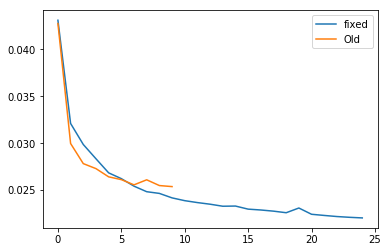

In [57]:
plt.plot(losses1[0] , label = "fixed")
plt.plot(losses2[0] , label = "Old")
plt.legend()

In [8]:
def recon_loss_L1_2chan_fixed3(y_true, y_pred):
    mask_files = glob("./masks/gen_masks/4_0*")
    mask_files = [np.fft.fftshift(np.load(m)) for m in mask_files]
    mask = tf.cast(mask_files[0] , dtype=tf.complex64)
    y_pred = tf.cast(tf.squeeze(y_pred, axis=0), dtype=tf.complex64)
    fft_img = tf.fft2d(y_pred[:, :, 0] + 1j*y_pred[:, :, 1])
    masked = tf.multiply(fft_img, mask)
    ifft = tf.ifft2d(masked)    
    squeeze_ytrue =tf.cast( tf.squeeze(y_true, axis=0) , dtype=tf.complex64)

    #New conjugate loss function
    imag_ytrue = squeeze_ytrue[: ,: , 0] + 1j * squeeze_ytrue[: ,: , 1]
    subtract = tf.cast(ifft - imag_ytrue , tf.complex64)
    conj = tf.cast(tf.real(subtract), dtype=tf.complex64) -  1j * tf.cast(tf.imag(subtract), dtype=tf.complex64)
    loss = tf.real(tf.multiply(subtract , conj))
    
    print("ifft" , ifft.shape)
    print("imag_ytrue" , imag_ytrue.shape)
    print("squeeze_ytrue" , squeeze_ytrue.shape)
    print("loss" , loss.shape)
    
    
    return loss

In [22]:
normalized_img.shape

(1, 320, 256, 2)

In [38]:
np.max(normalized_img[0 , : , : , 1] )

1.0

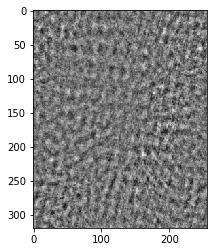

In [43]:
plt.imshow(normalized_new_img[: , : , 1] , cmap='gray')


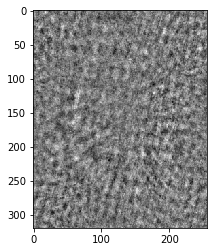

In [86]:
plt.imshow(normalized_new_img[: , : , 1] , cmap='gray')


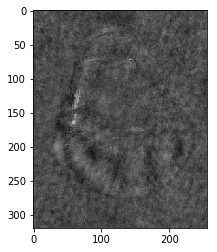

In [90]:
plt.imshow(normalized_new_img[: , : , 1] , cmap='gray')


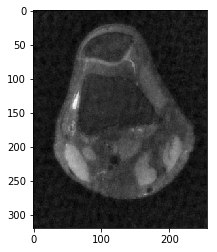

In [95]:
plt.imshow(normalized_new_img[: , : , 0] , cmap='gray')


In [35]:
normalized_new_img = get_subsampled_normalized_2chan2(get_image_normalized_2chan(100), 4)
normalized_img = get_batch_normalized_2chan([100])

np.array([normalized_new_img]).shape
#normalized_new_img.shape
#normalized_img.shape

(1, 320, 256, 2)

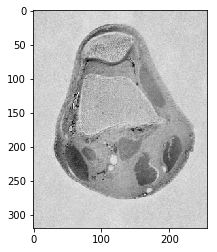

In [42]:
plt.imshow(np.sqrt(normalized_img[0,:,:,0] ** 2 + normalized_img[0,:,:,1] ** 2)   , cmap='gray')

start 1
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_136 (Conv2D)          (None, 320, 256, 8)       152       
_________________________________________________________________
max_pooling2d_32 (MaxPooling (None, 160, 128, 8)       0         
_________________________________________________________________
activation_136 (Activation)  (None, 160, 128, 8)       0         
_________________________________________________________________
conv2d_137 (Conv2D)          (None, 160, 128, 8)       584       
_________________________________________________________________
activation_137 (Activation)  (None, 160, 128, 8)       0         
_________________________________________________________________
conv2d_138 (Conv2D)          (None, 160, 128, 16)      1168      
_________________________________________________________________
max_pooling2d_33 (MaxPooling (None, 80, 64, 16)        0         
__

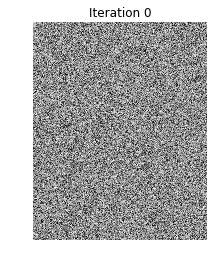

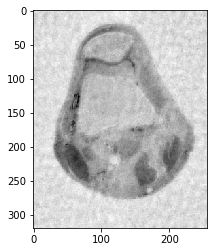

0.04947987298384417


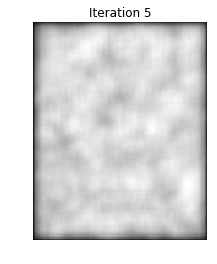

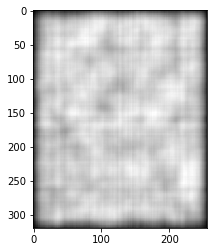

0.0602111370423843


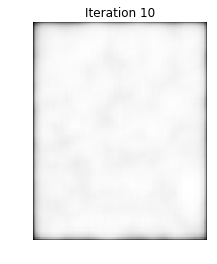

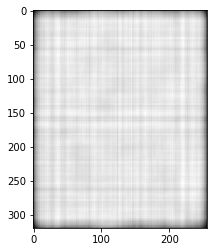

0.04910108078888136


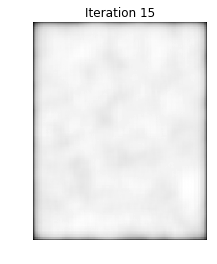

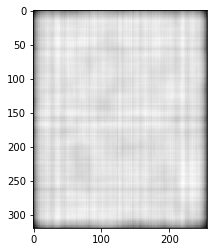

0.03174842874825714


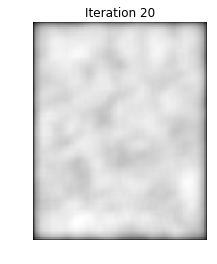

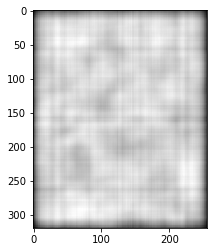

0.033365736545323064


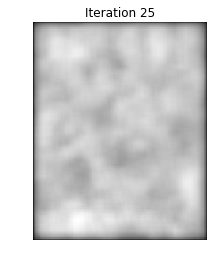

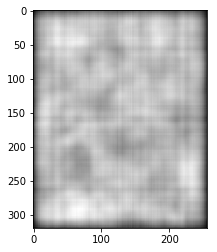

0.026277124673172475


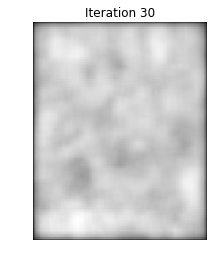

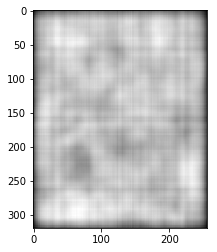

0.02530846086149342


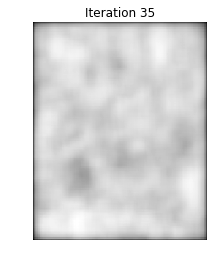

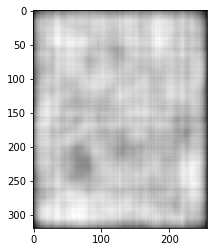

0.02157468241151172


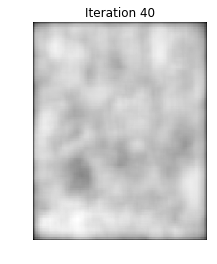

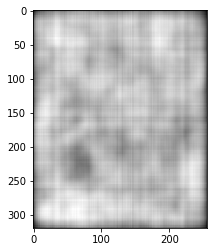

0.01958570532091016


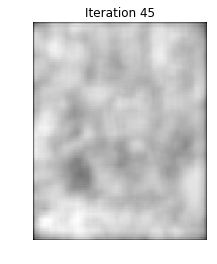

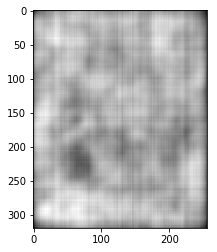

0.016861481763539528


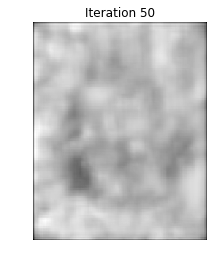

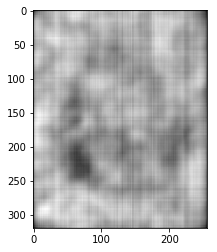

0.015129419299328636


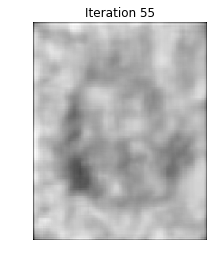

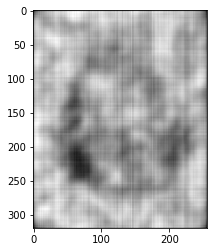

0.013108822802579297


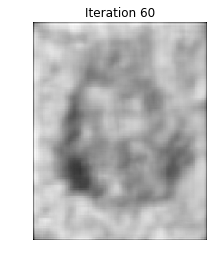

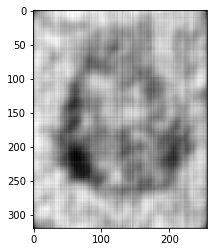

0.011391683194687013


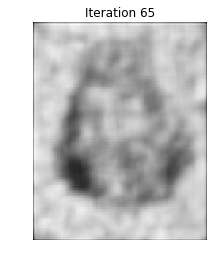

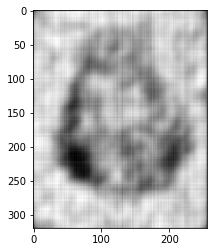

0.010070637758994362


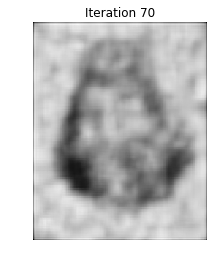

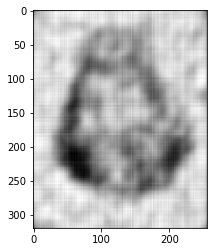

0.008925784163361353


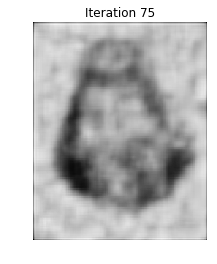

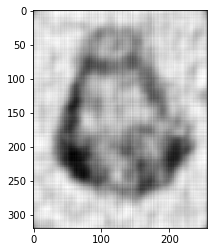

0.00787368827981196


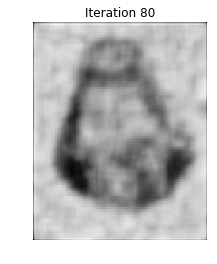

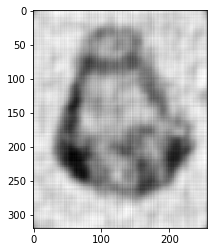

0.0071629897935414095


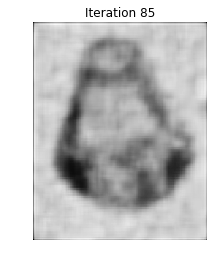

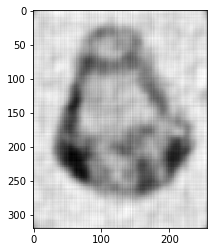

0.006711063643777731


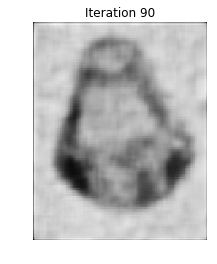

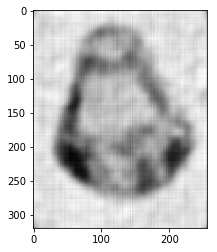

0.006405786872493607


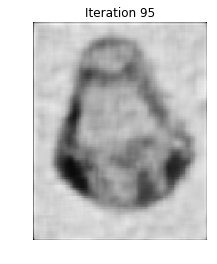

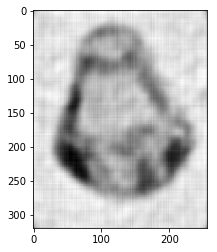

0.00611680077385468


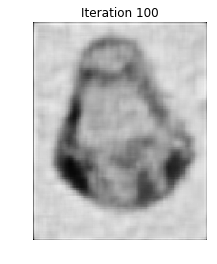

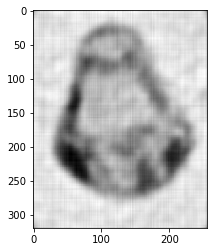

0.005935035499159616


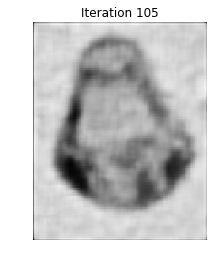

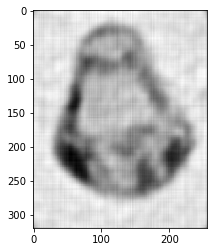

0.005821582578448134


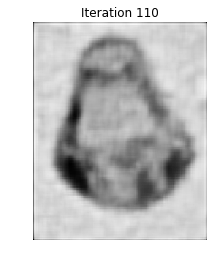

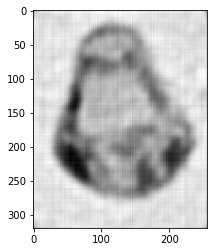

0.005641416664884249


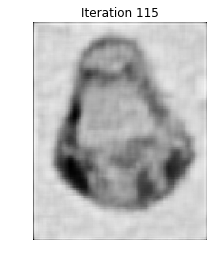

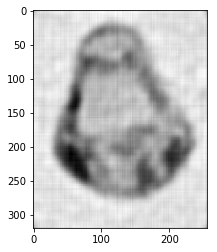

0.005610266788084675


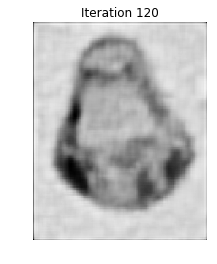

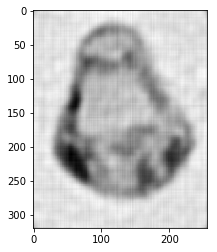

0.005426999842086154


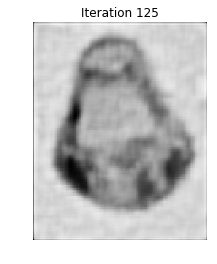

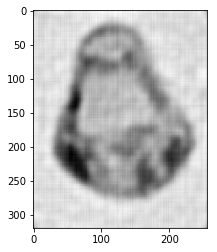

0.0053271339250779105


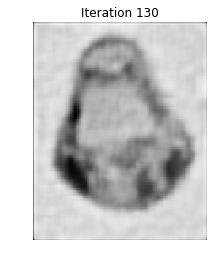

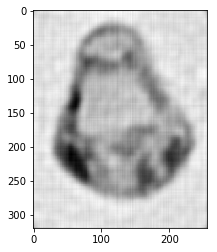

0.005292320408367041


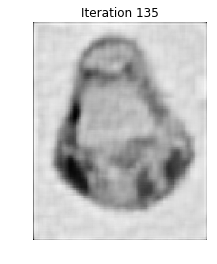

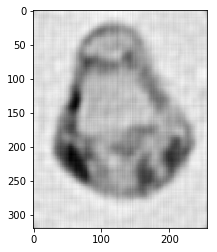

0.005207502677754131


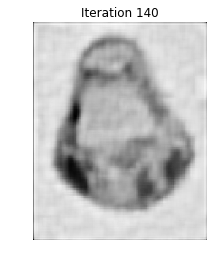

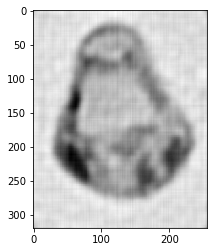

0.0051130946064862764


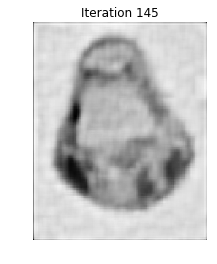

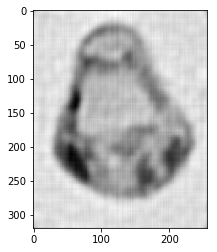

0.0050106162462002675


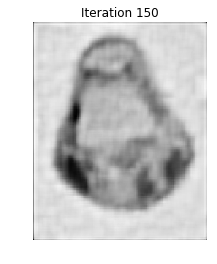

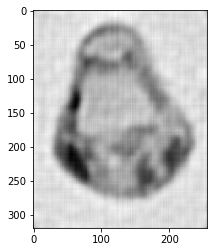

0.004940901742260228


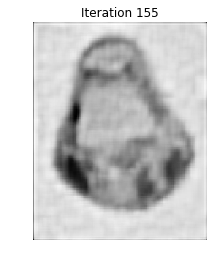

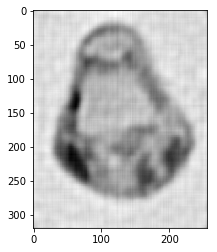

0.004852684157517499


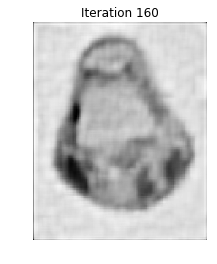

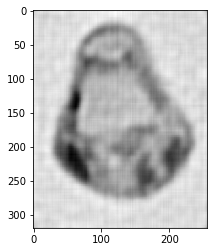

0.004875808533622964


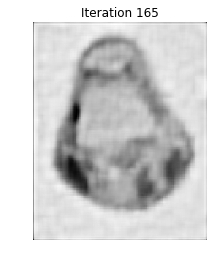

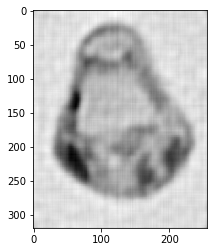

0.004813354681818801


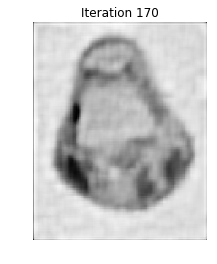

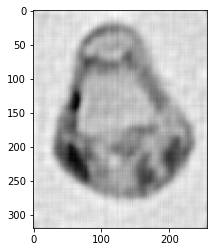

0.004937975137390901


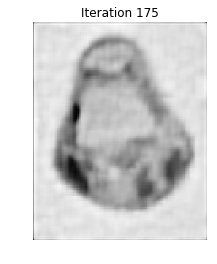

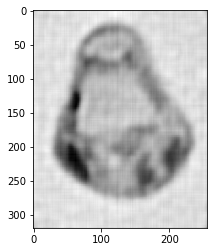

0.004590964367033564


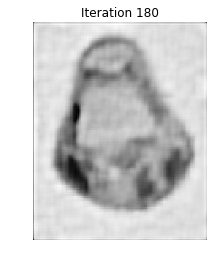

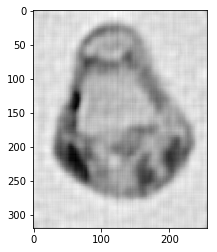

0.004593725215503099


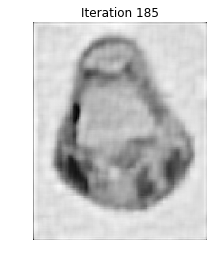

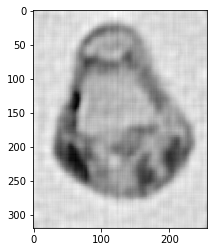

0.004471661714258913


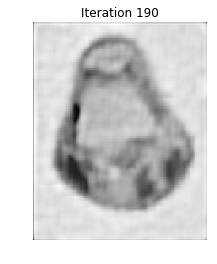

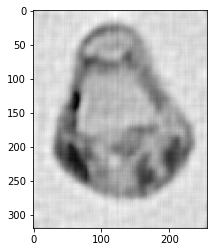

0.004441351544890111


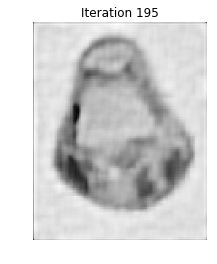

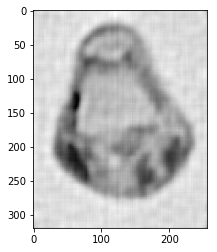

0.0043873238724101565


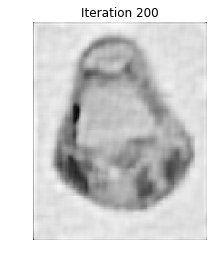

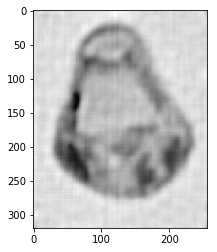

0.004333501686190802


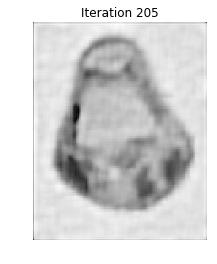

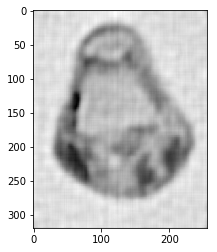

0.004286288046548932


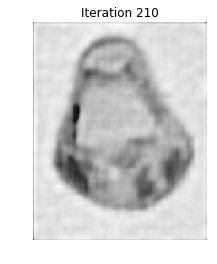

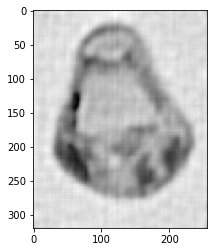

0.004242053669095814


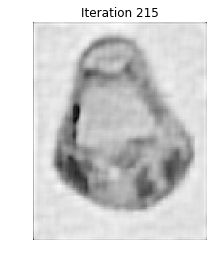

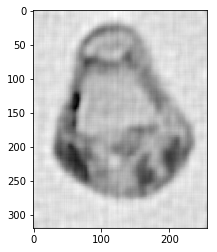

0.004191322431564731


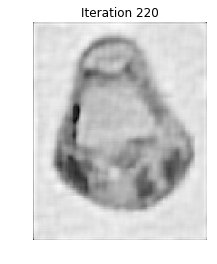

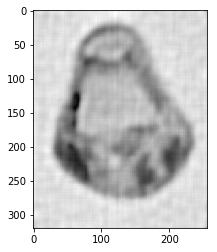

0.0041486151928374956


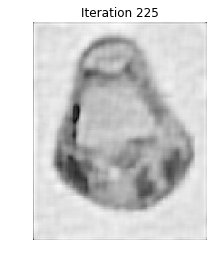

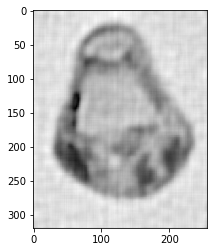

0.004206808802626196


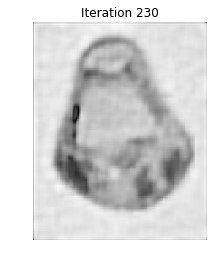

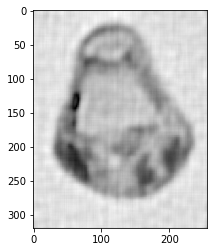

0.004159557480382176


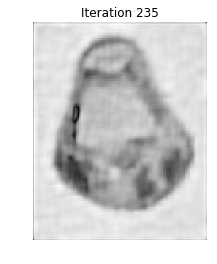

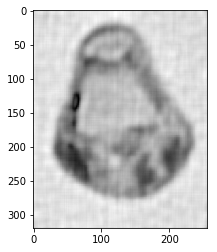

0.004074980116109277


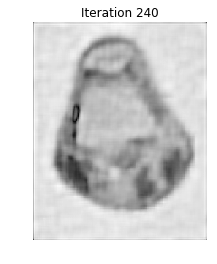

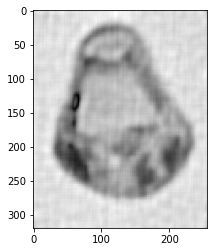

0.004005984179816334


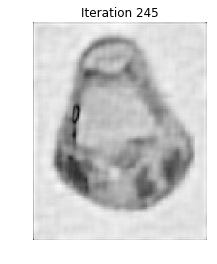

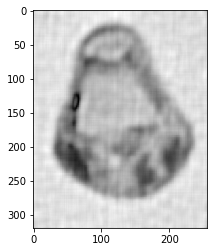

0.003963903887217844


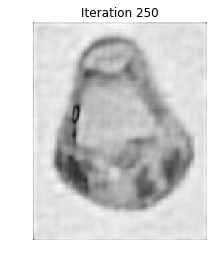

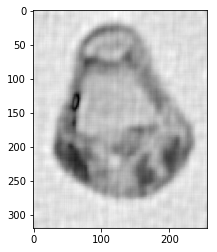

0.003938547703849209


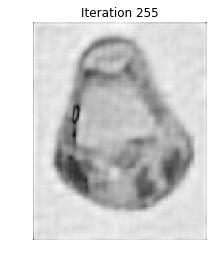

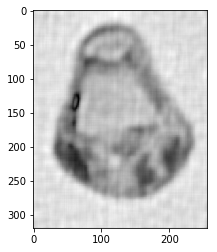

0.003910538323730414


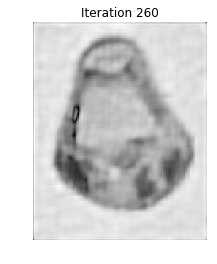

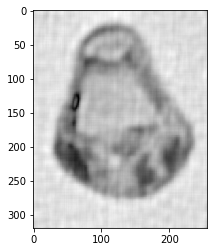

0.0038520249989490206


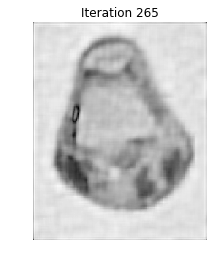

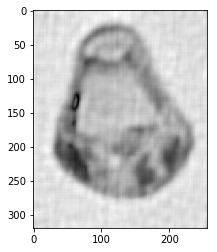

0.0038749211682647506


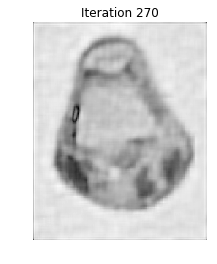

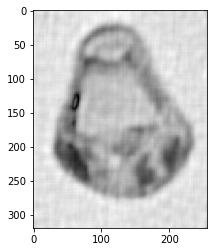

0.003949392128253486


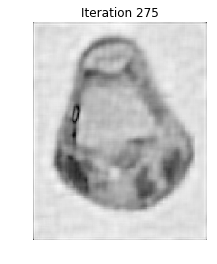

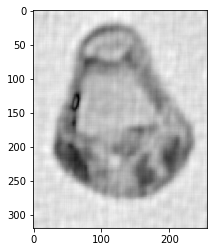

0.003782227386064854


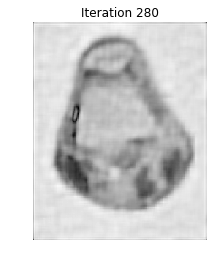

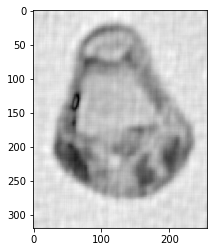

0.003857980107748484


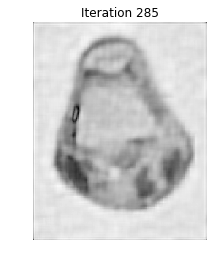

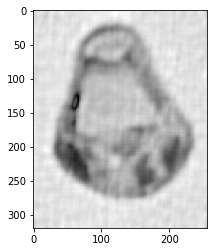

0.0037477889393771


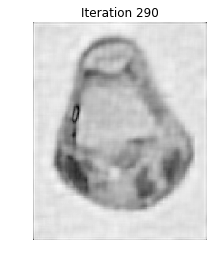

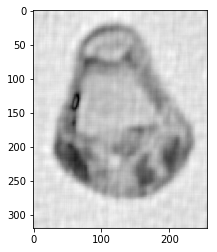

0.0038321880045766358


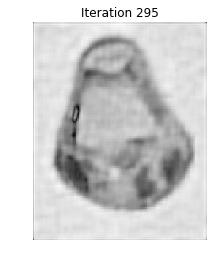

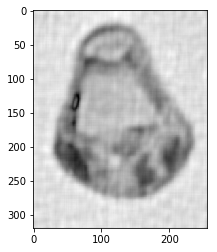

0.0036953249944975536


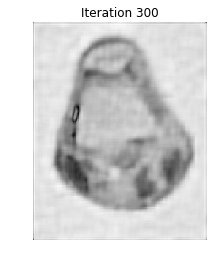

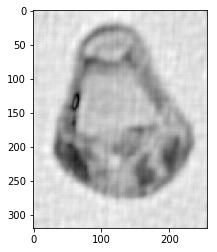

0.003788473296787738


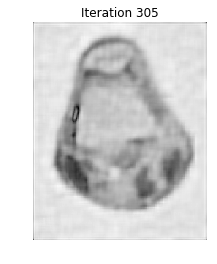

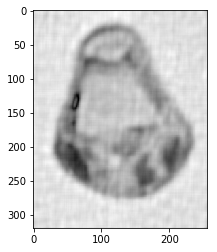

0.003675043630963459


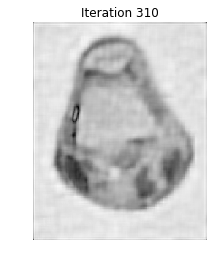

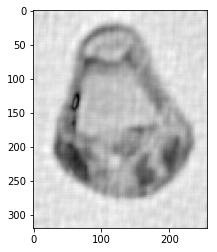

0.0037099414719495216


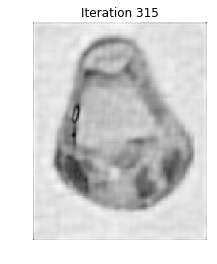

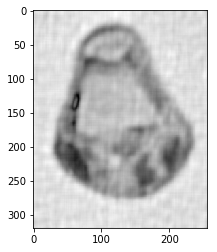

0.003710318985663032


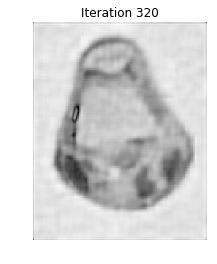

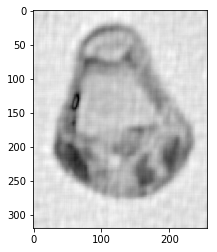

0.003643393959191566


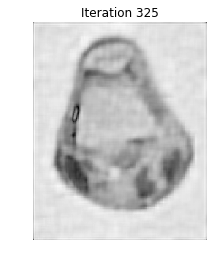

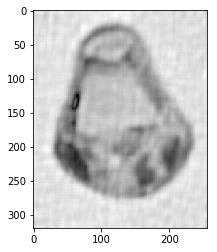

0.003685896537094239


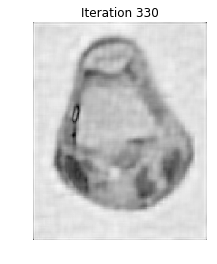

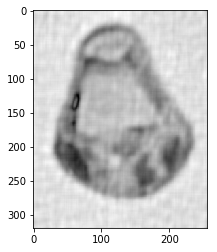

0.003585621233101453


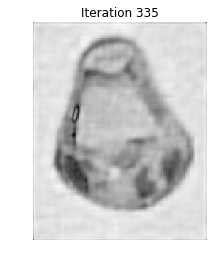

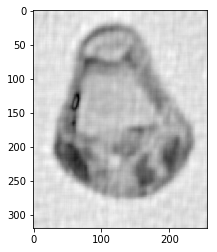

0.003690076625801521


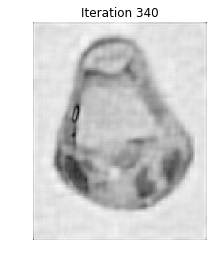

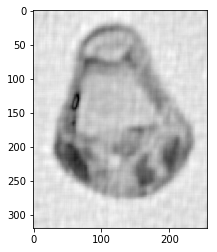

0.003545711526250853


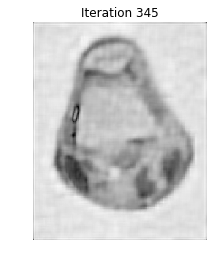

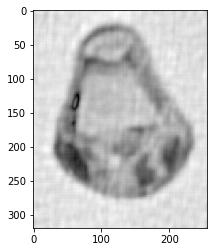

0.00362543319725697


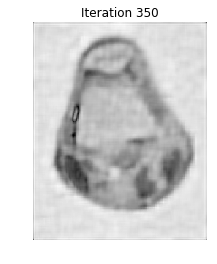

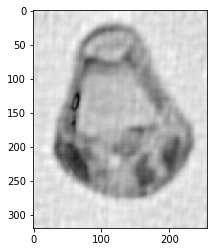

0.0035196823429147353


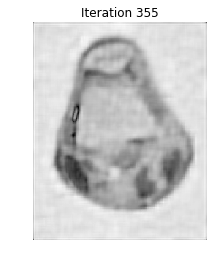

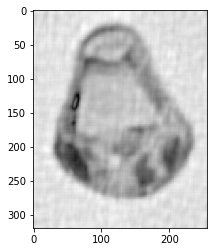

0.0035945918839490353


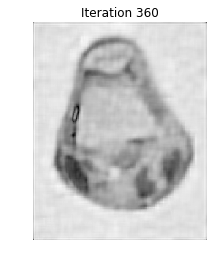

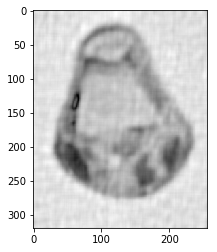

0.003559316193121757


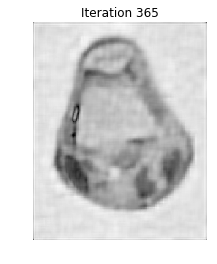

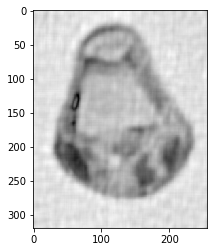

0.003542230146276263


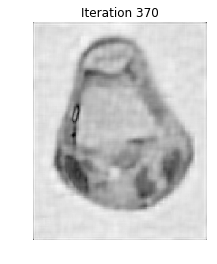

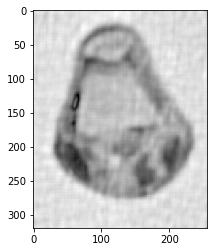

0.0035048465064541233


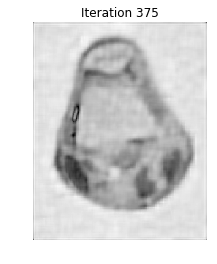

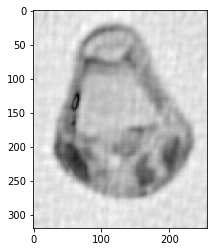

0.003520469643758354


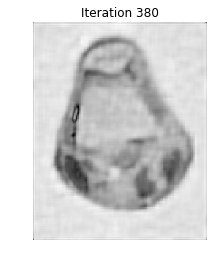

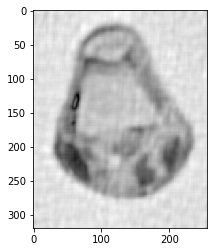

0.0034772946859627967


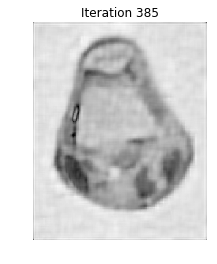

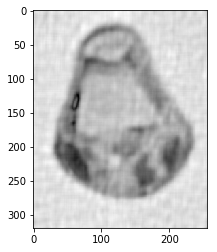

0.003464480906302658


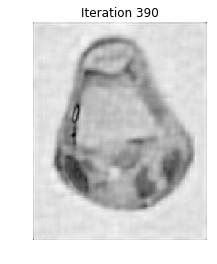

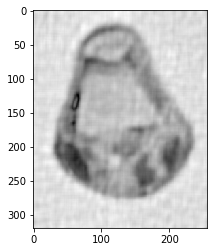

0.003521314206415261


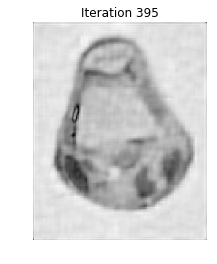

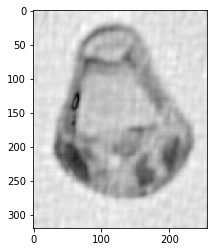

0.003403477735761176


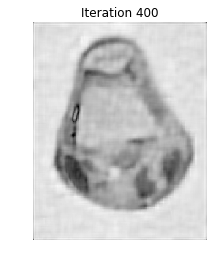

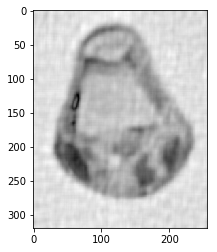

0.0034797233359186628


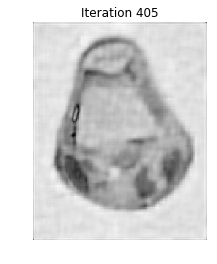

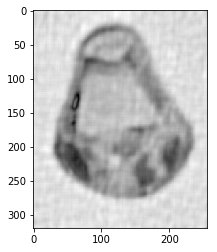

0.0034651849806376783


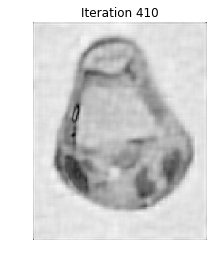

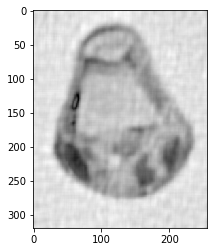

0.0034119193189789494


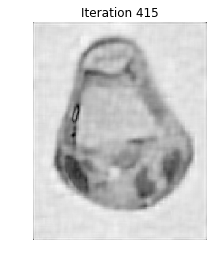

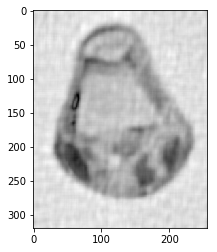

0.003436592845466032


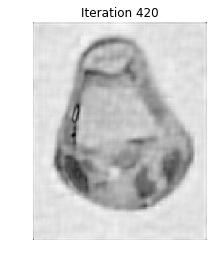

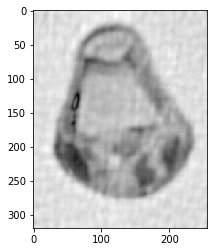

0.00337646271360363


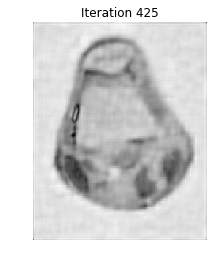

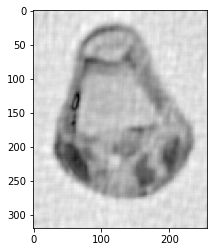

0.003474144166563862


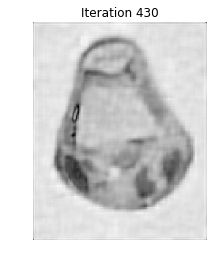

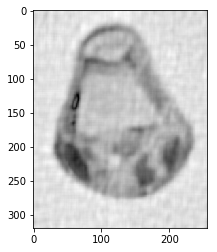

0.0033383171316115124


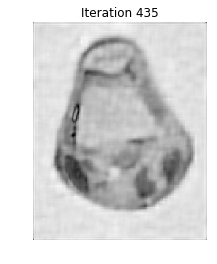

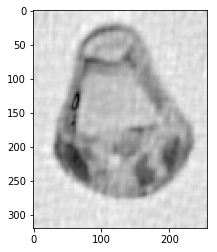

0.0034377158147255423


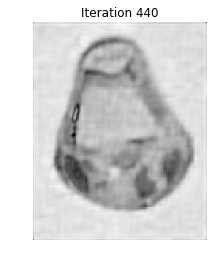

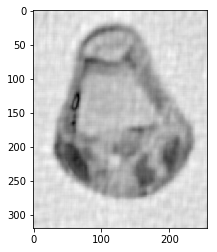

0.003325197859776503


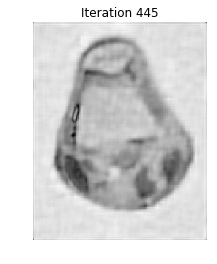

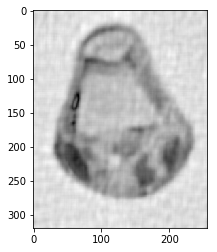

0.0034412434051823496


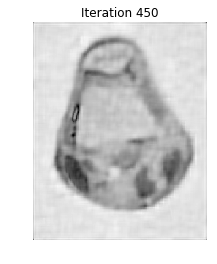

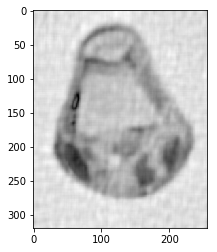

0.0033100735777674703


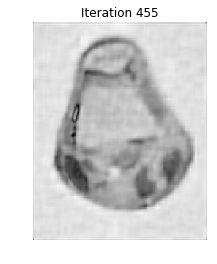

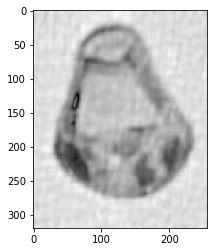

0.0033753708073391868


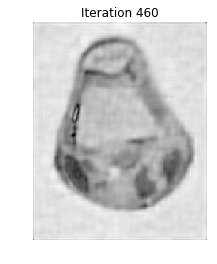

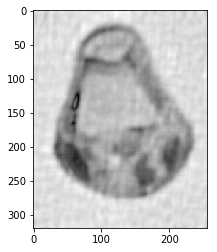

0.003305527245635061


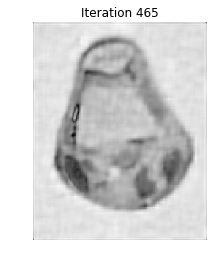

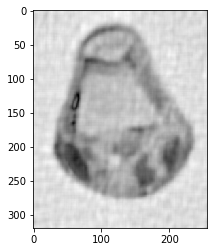

0.0033672430417064766


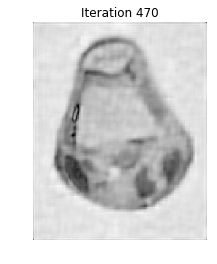

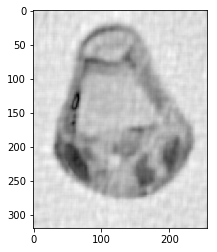

0.003274625970417013


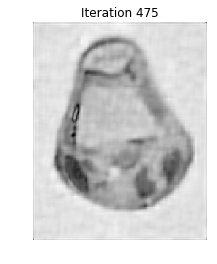

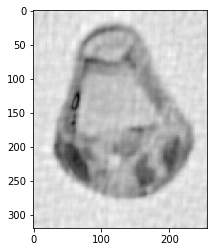

0.0033435990630804693


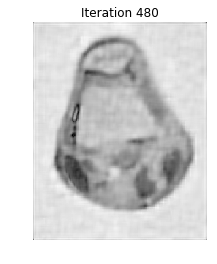

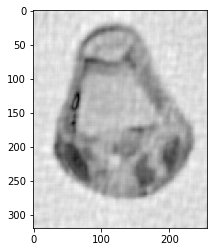

0.003255087606454013


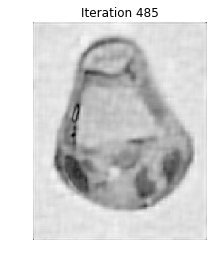

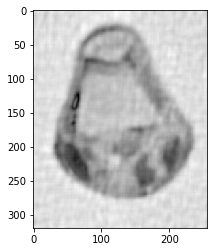

0.0032885181629484445


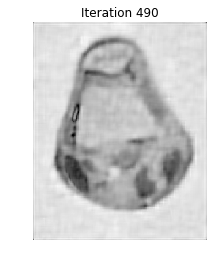

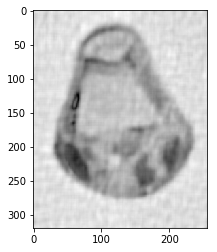

0.0033732087390341663


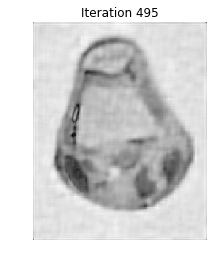

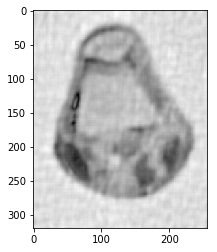

0.0032314737090798824


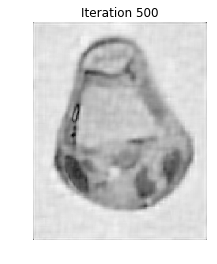

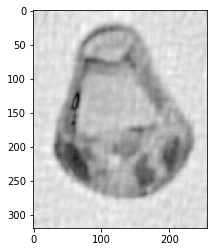

0.0033289561651254538


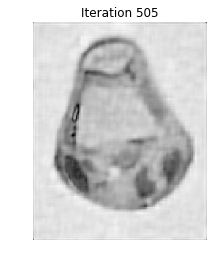

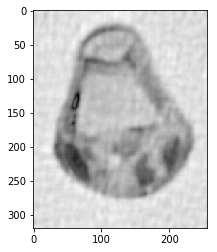

0.0032187395522513713


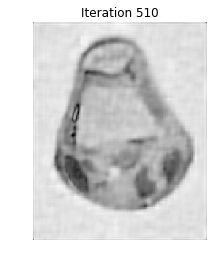

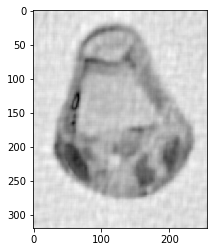

0.0032850513902792935


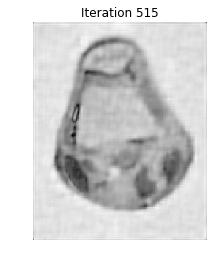

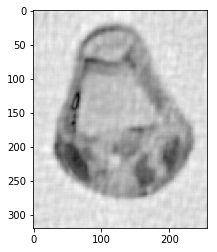

0.003202300766243575


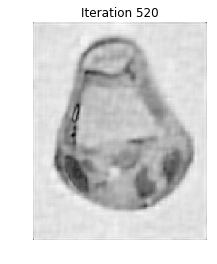

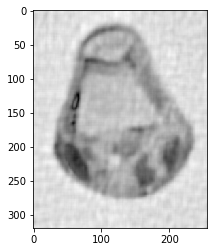

0.0032583571518068483


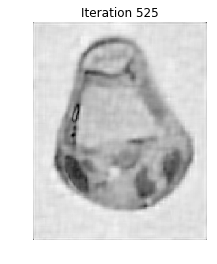

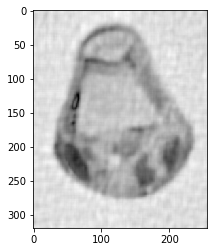

0.0032256414211607595


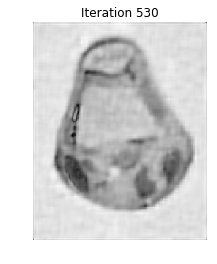

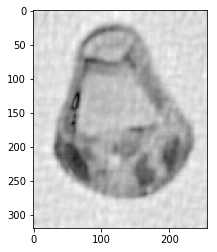

0.0031852862411200457


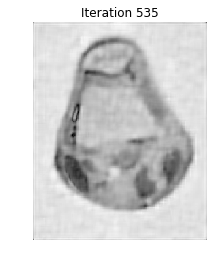

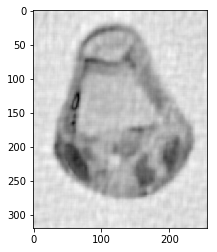

0.003243540760369318


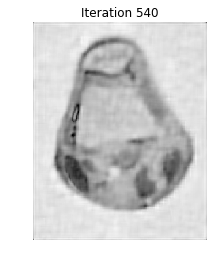

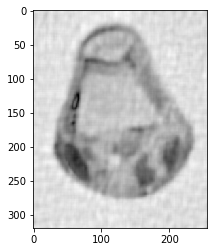

0.0034026570432914294


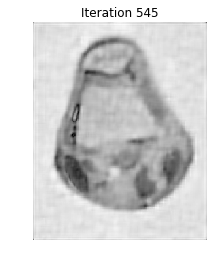

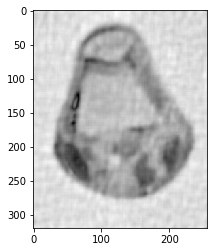

0.003230226873385312


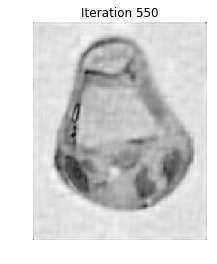

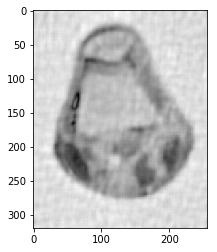

0.003165640111073569


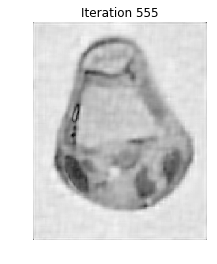

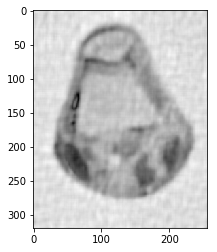

0.0032056776342306486


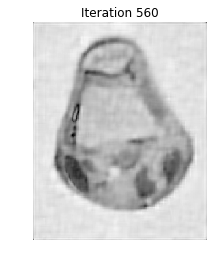

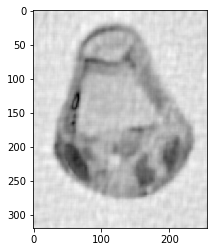

0.0032036046889918424


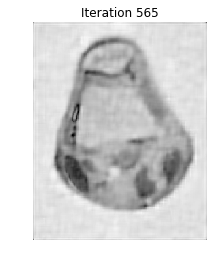

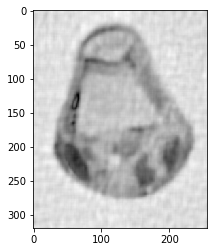

0.0031523981700875723


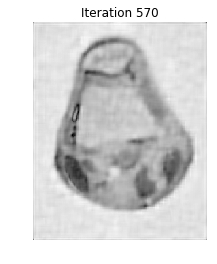

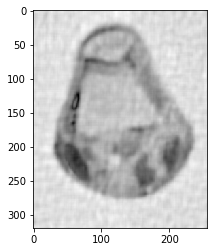

0.0031563175648886437


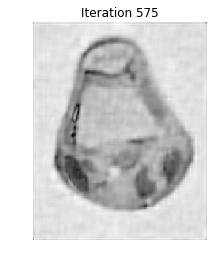

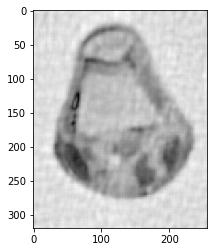

0.003139979269393061


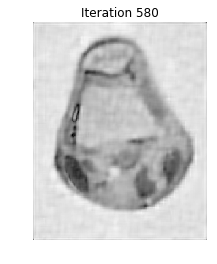

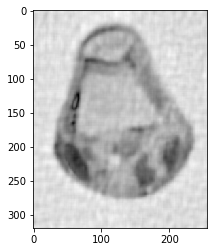

0.0031679128614124615


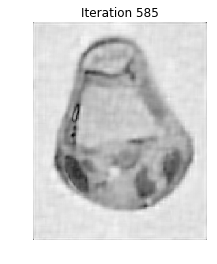

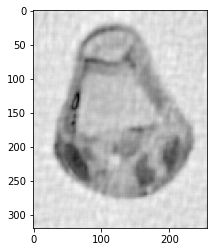

0.00319732892234538


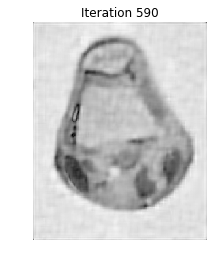

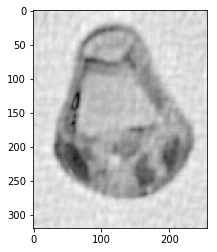

0.0031172660640214262


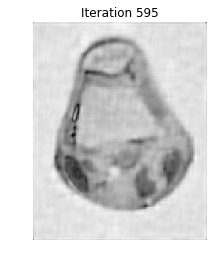

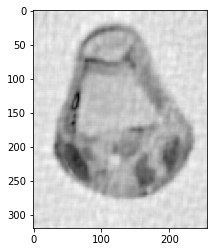

0.0031559533785379965


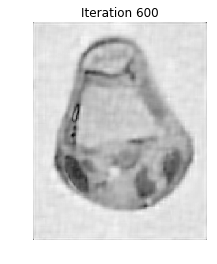

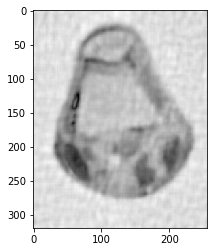

0.003219900131346984


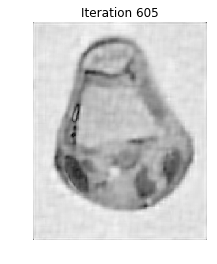

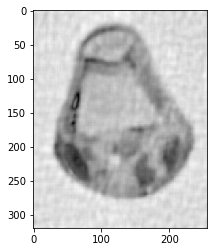

0.003101149157899965


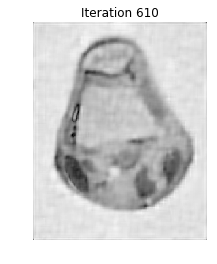

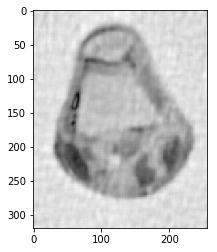

0.0031846409604854783


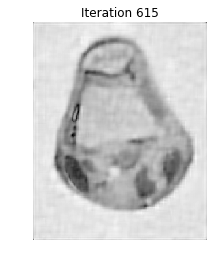

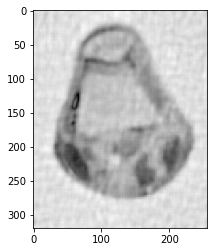

0.0030934424632116566


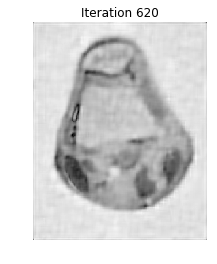

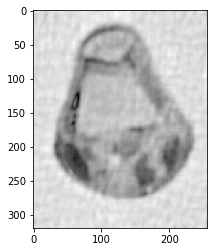

0.0031464235430280958


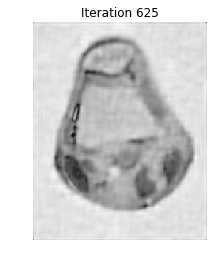

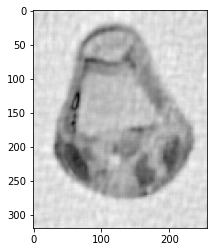

0.003087827719685362


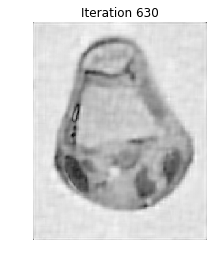

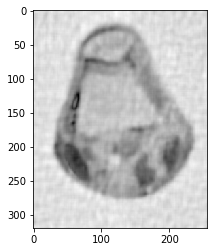

0.003098753218737827


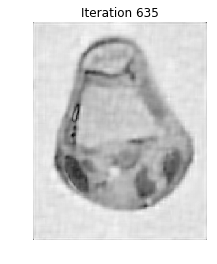

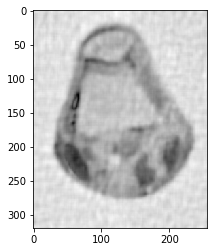

0.0031495090641278077


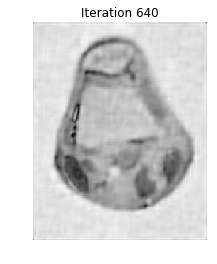

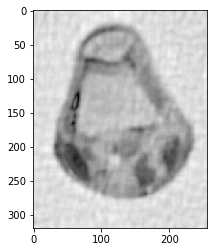

0.0031444617469706714


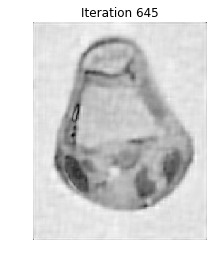

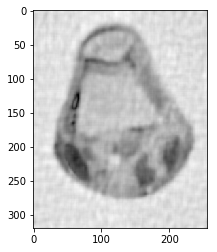

0.003090139315256637


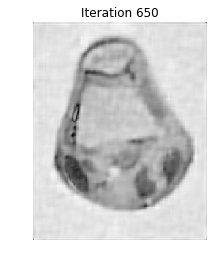

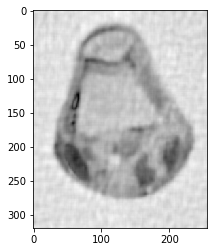

0.0031250566804236673


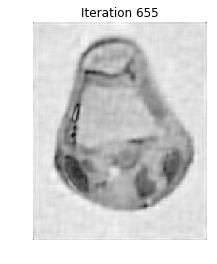

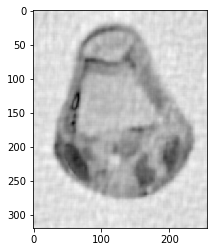

0.003062629895427803


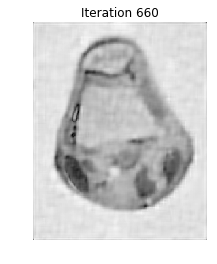

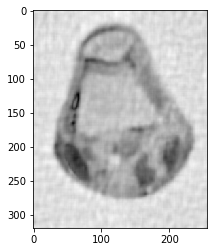

0.0031134615451793414


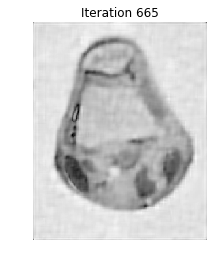

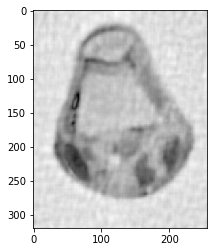

0.003059434800824286


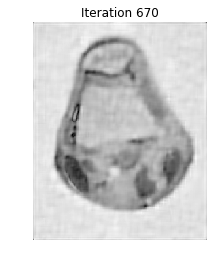

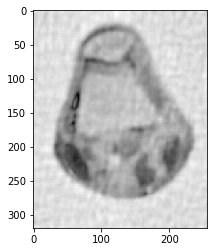

0.0030622796442254935


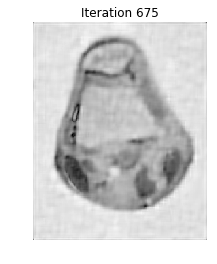

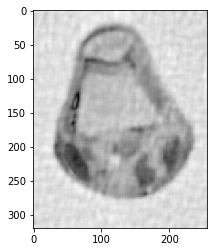

0.0030910657112972733


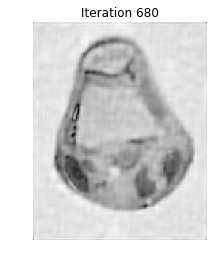

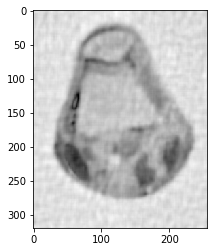

0.003095466341065676


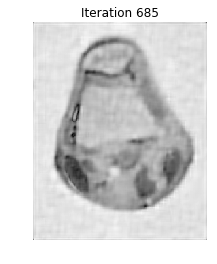

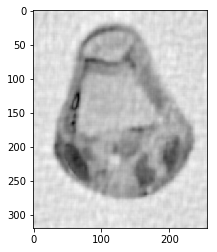

0.0030307309043202447


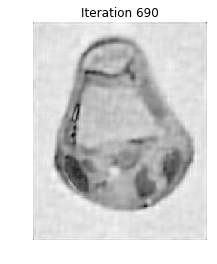

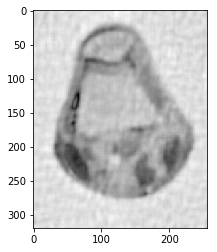

0.0030601217920834182


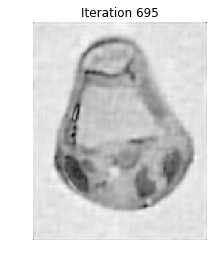

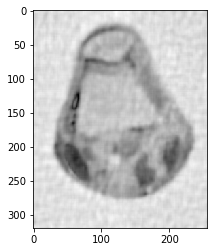

0.0031230628384856414


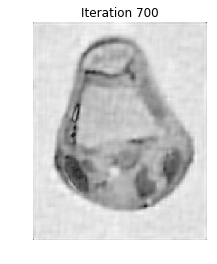

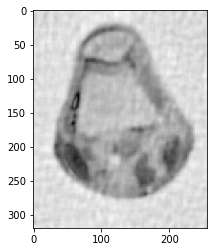

0.0030931162637404756


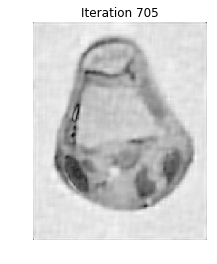

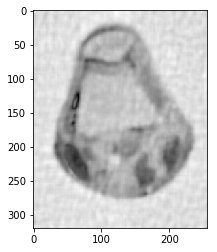

0.0030664776151449287


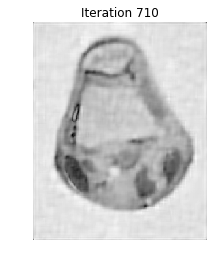

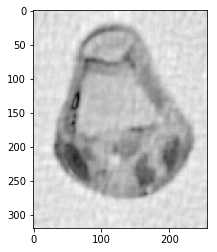

0.003029212658774641


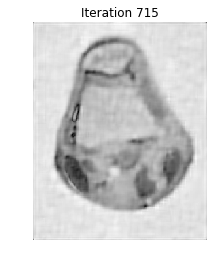

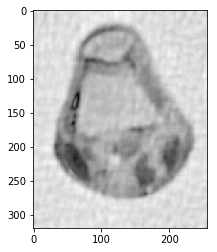

0.0030511784210927435


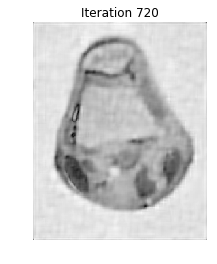

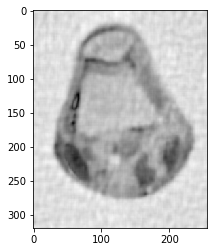

0.0030141334942997582


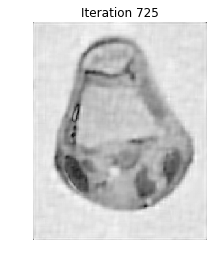

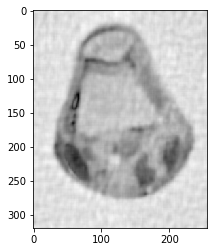

0.0030146446211032616


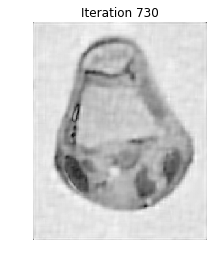

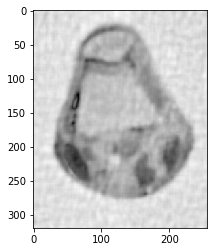

0.00305346469619281


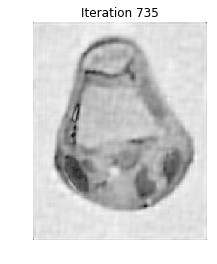

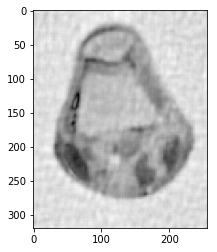

0.0030684688966323313


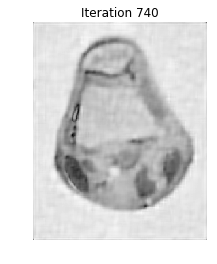

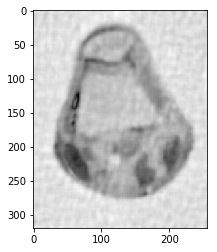

0.0029945937004670683


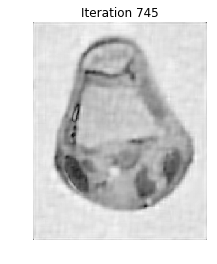

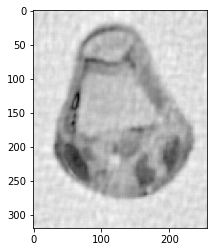

0.003040740561773823


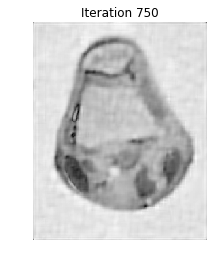

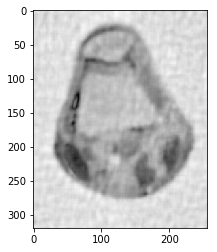

0.0030333721231076117


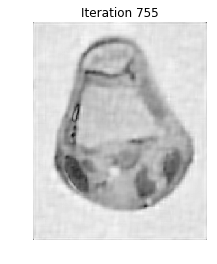

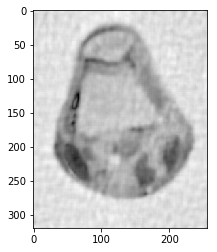

0.0029837727631107933


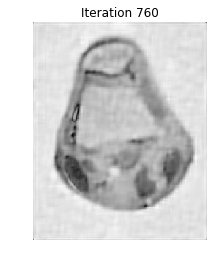

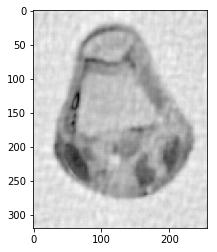

0.003016427591857891


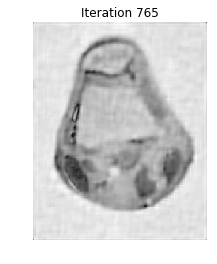

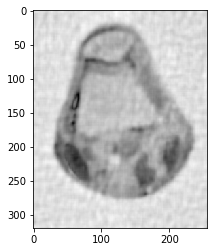

0.0032240745867155134


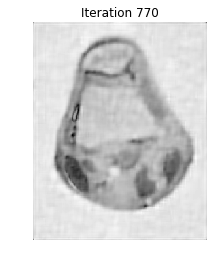

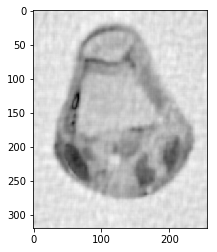

0.0029842076802219356


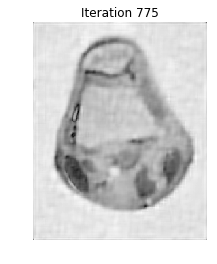

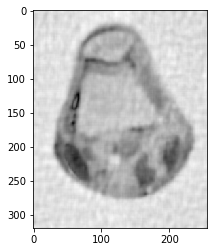

0.003025531576908249


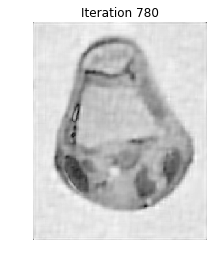

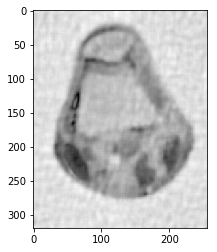

0.003038143142444755


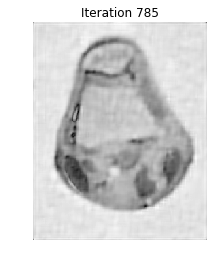

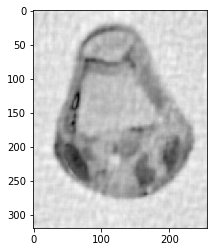

0.0030080192780690745


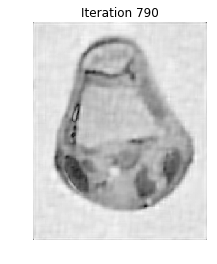

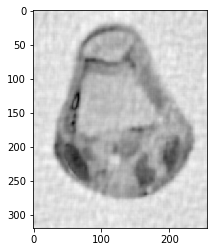

0.002980589098633469


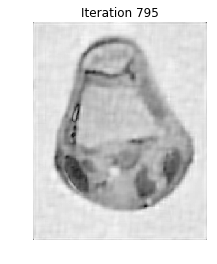

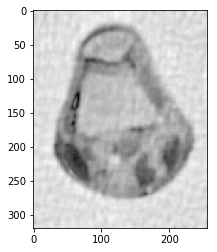

0.002967057911111956


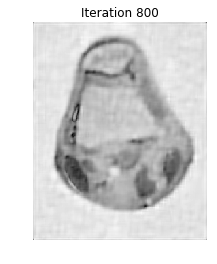

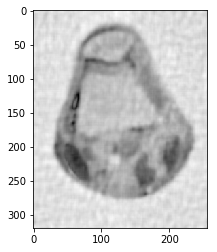

0.002965335631546681


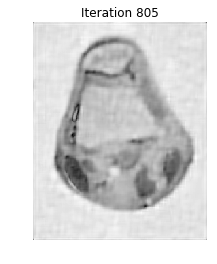

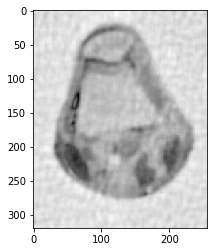

0.002958223425570305


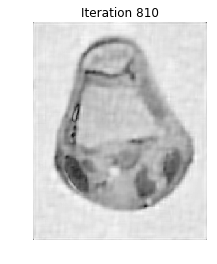

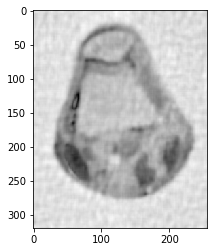

0.0029584901922116184


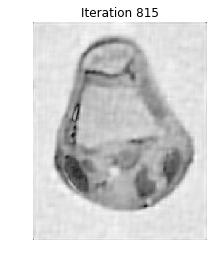

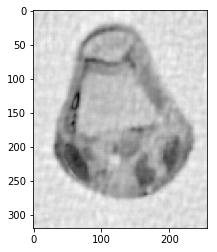

0.0029600382189765876


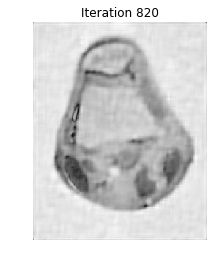

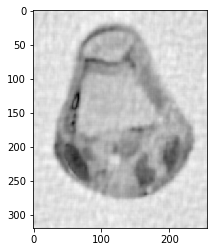

0.002998235986722879


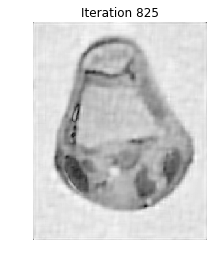

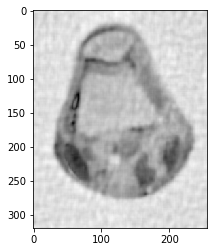

0.0030868952818528437


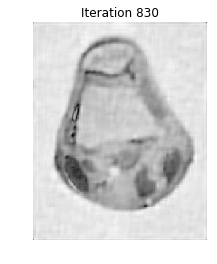

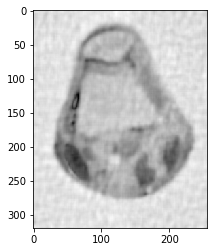

0.0029468519266518775


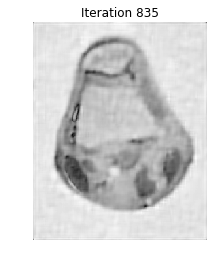

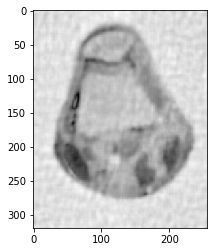

0.002998331381353064


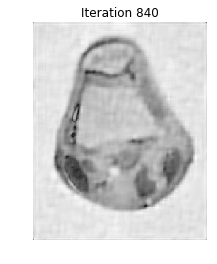

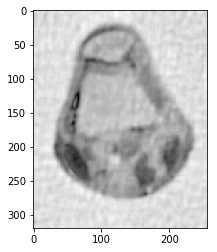

0.002972425627606381


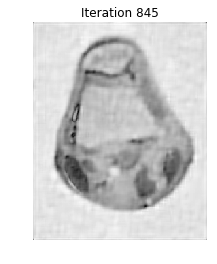

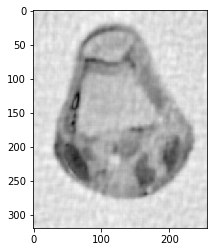

0.0029412602869999444


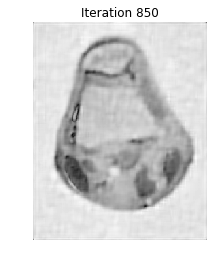

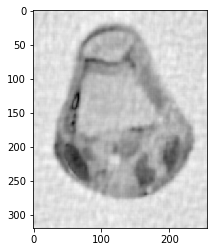

0.0029592886582792653


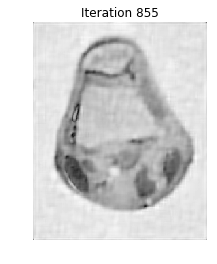

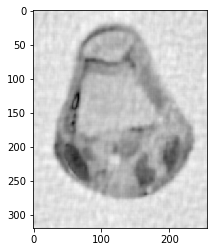

0.002934427853654443


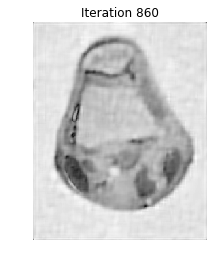

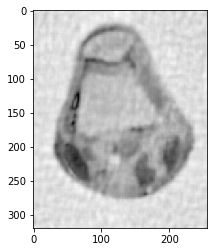

0.0029388822329922005


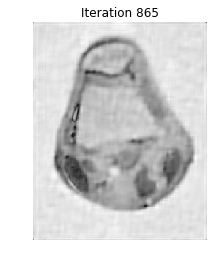

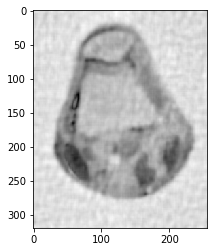

0.0029613846414078705


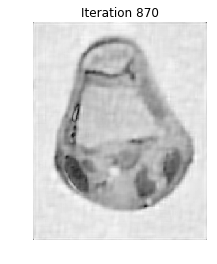

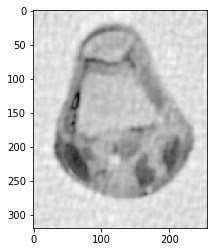

0.0029669407407520694


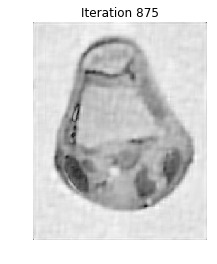

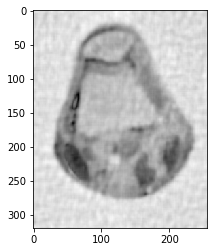

0.002919212462816745


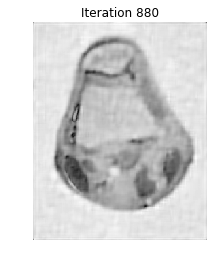

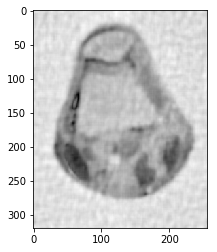

0.002931759181364843


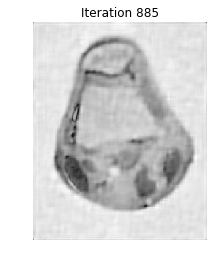

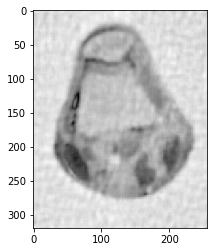

0.0030323409783531412


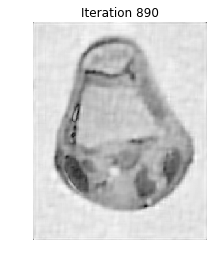

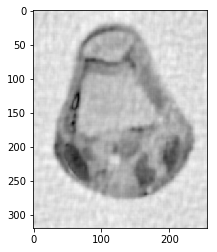

0.0031486302785273972


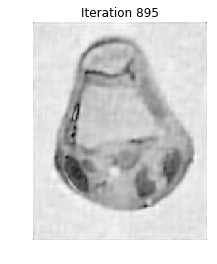

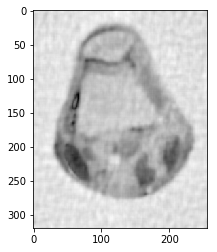

0.003088151974229974


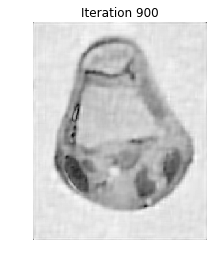

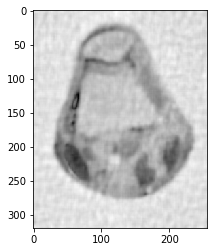

0.002981093983120255


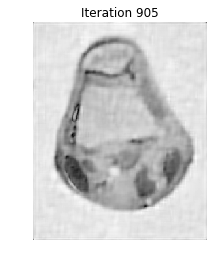

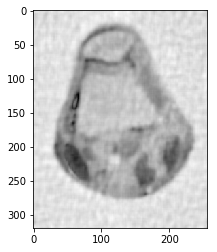

0.0029196488283340974


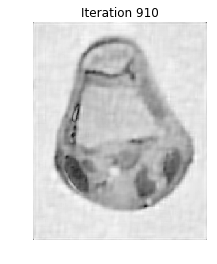

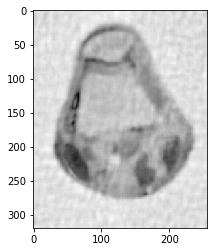

0.002906238445282474


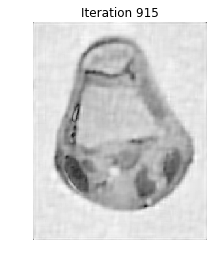

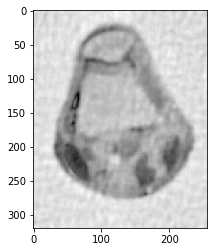

0.002909388126173737


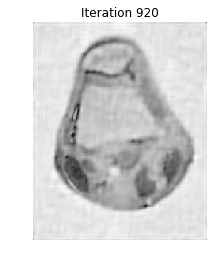

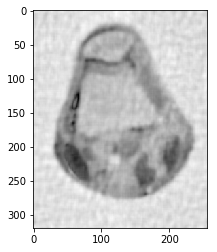

0.0029115703992842793


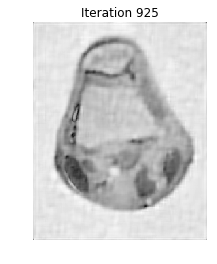

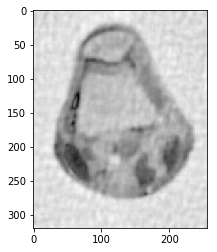

0.002899649028206278


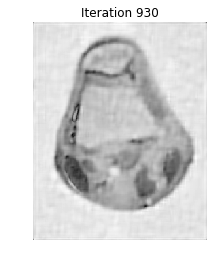

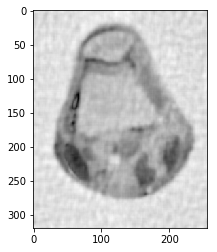

0.0028987733743799553


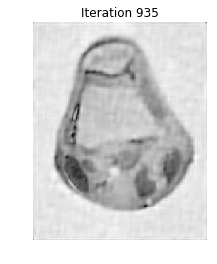

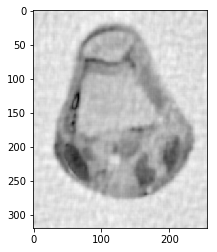

0.0028989678493749164


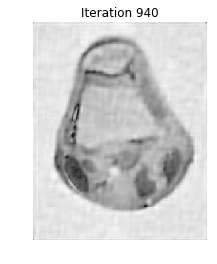

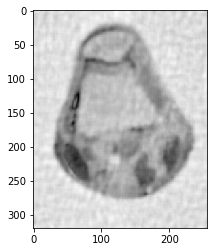

0.002904708071805233


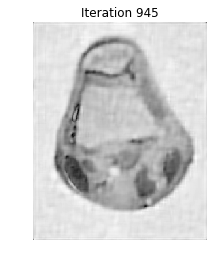

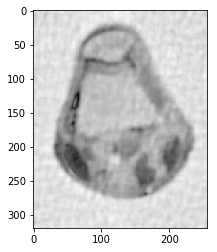

0.002976840300379522


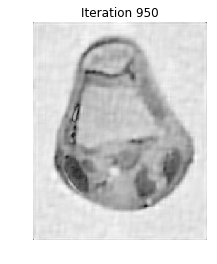

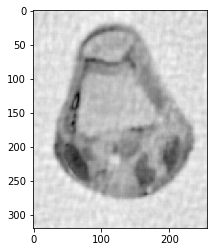

0.0030190478097532674


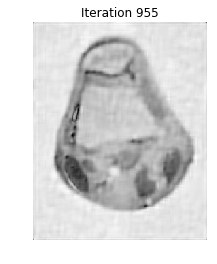

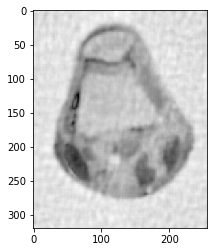

0.0029629509513734143


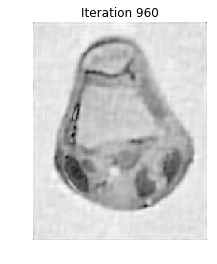

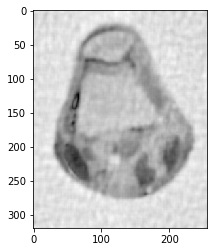

0.0028875368926205066


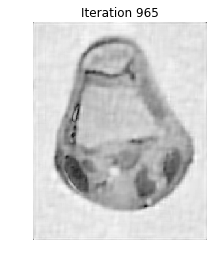

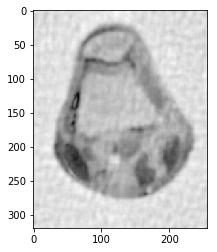

0.0029206988556828542


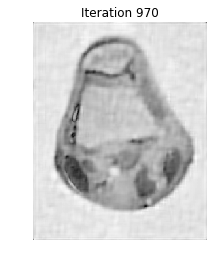

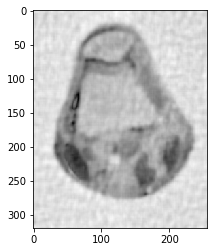

0.0029178524038966968


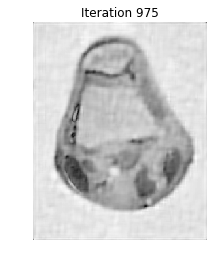

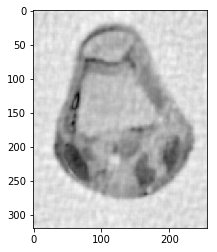

0.002878258954934496


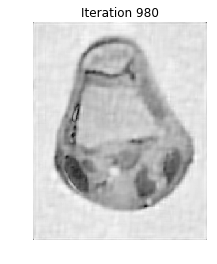

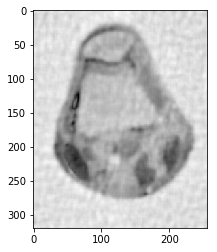

0.0028915418322543705


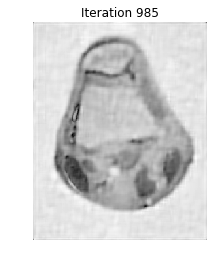

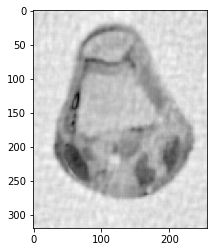

0.002875405888455607


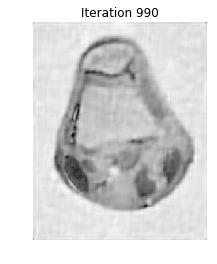

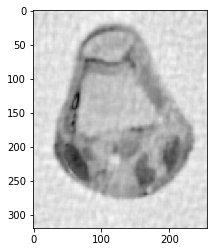

0.0028793850400191663


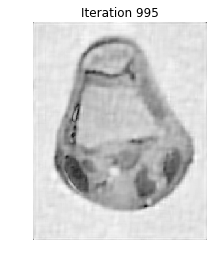

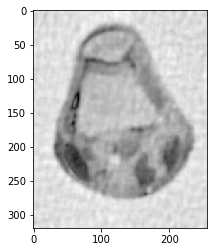

0.0028676937327475533


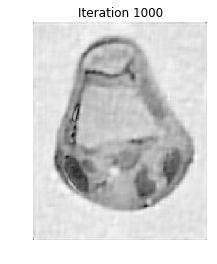

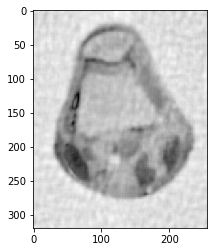

0.002862540191731493


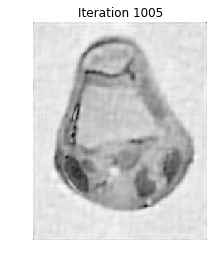

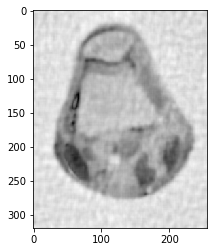

0.002865098711345657


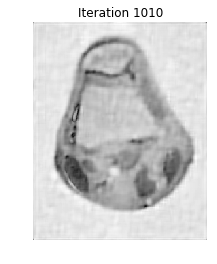

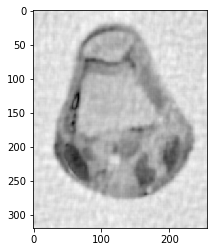

0.0030390858517629527


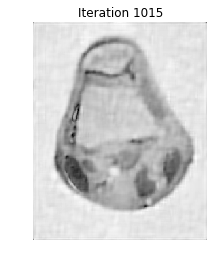

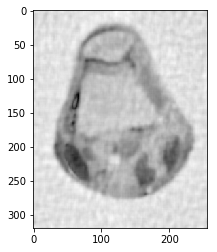

0.003173047137397457


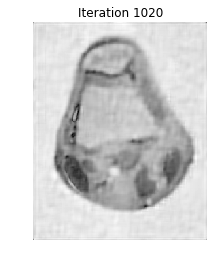

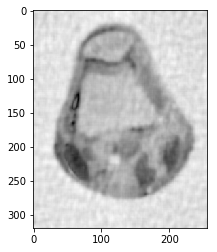

0.002986656795113316


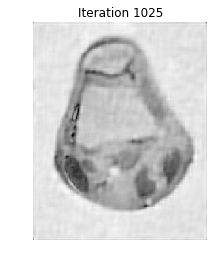

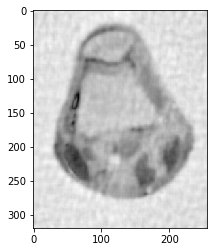

0.003114537183811524


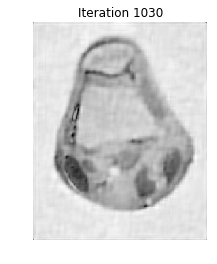

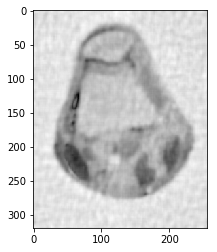

0.002887918781073415


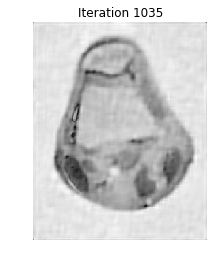

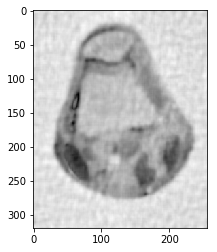

0.0029338944489958213


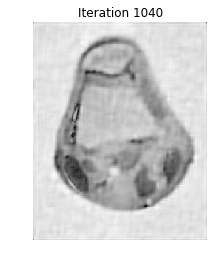

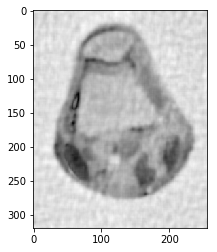

0.0028630809644108104


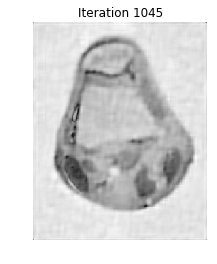

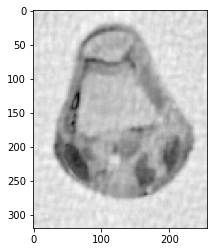

0.0028844001481701633


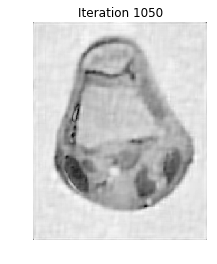

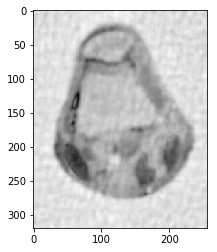

0.0028611053380951518


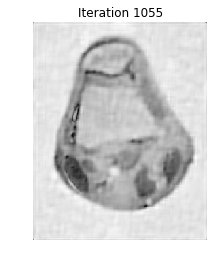

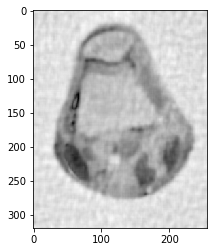

0.0028524135760000864


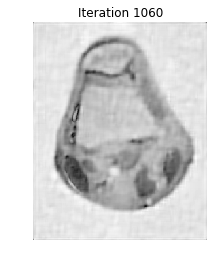

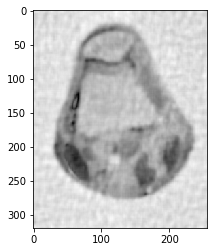

0.0028546649756214116


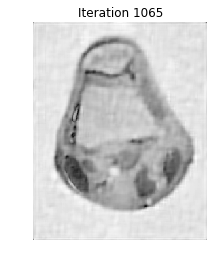

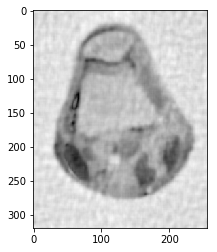

0.0028506663504083035


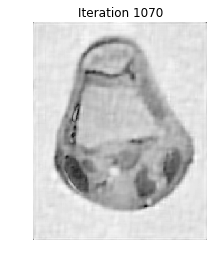

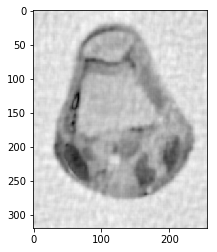

0.002845758239198112


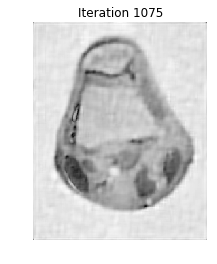

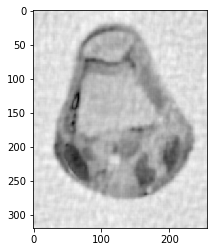

0.0028423111590798423


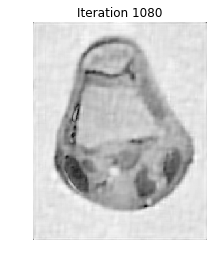

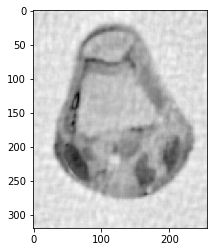

0.0028396597328552526


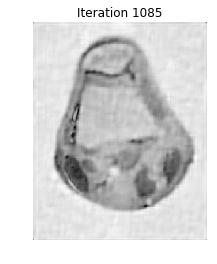

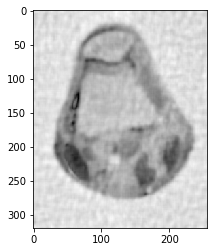

0.002838103564602478


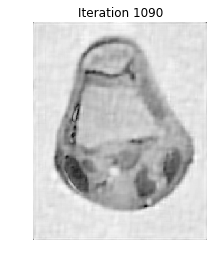

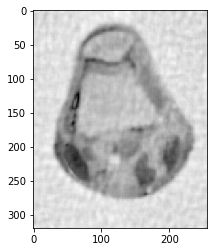

0.002836135492946385


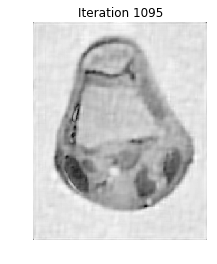

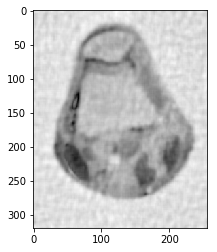

0.0028340706105032553


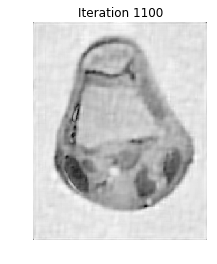

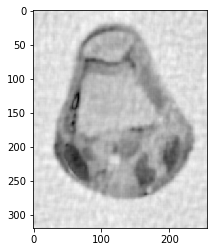

0.0028324623717642704


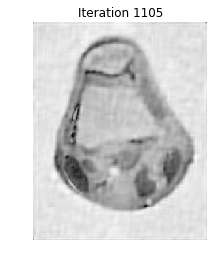

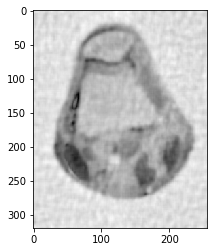

0.0028319561699485596


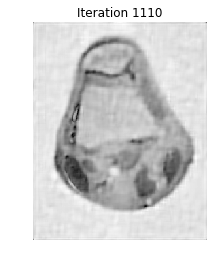

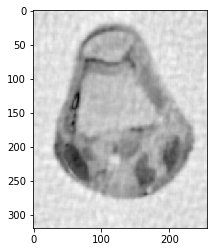

0.00282772694723755


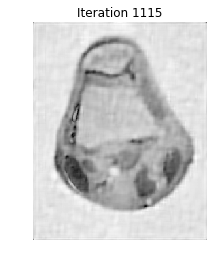

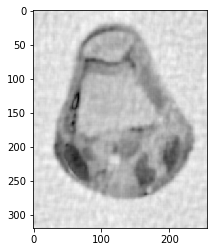

0.00282689238164559


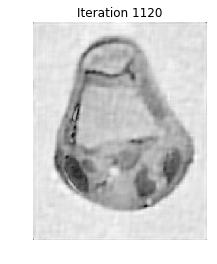

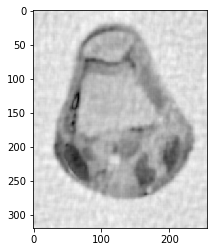

0.0028263155423446837


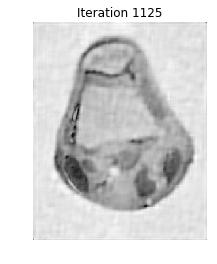

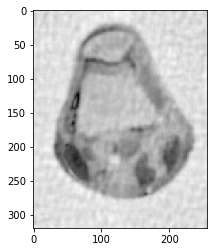

0.0028286647696708096


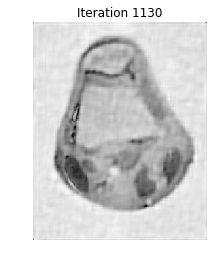

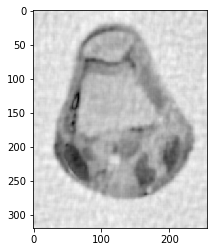

0.0028484876020158545


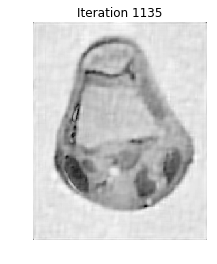

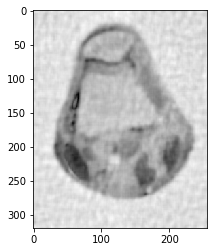

0.0028433194521130826


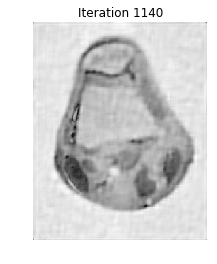

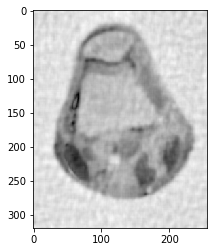

0.002827223301496139


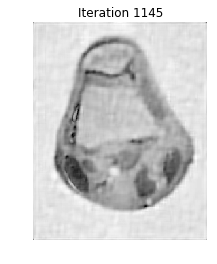

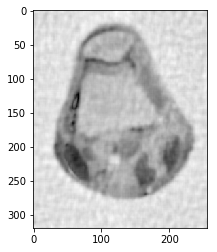

0.002820168032972911


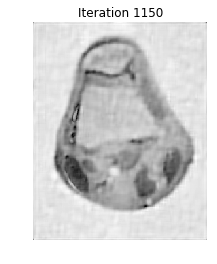

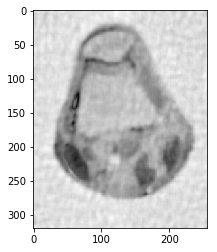

0.002843447814283305


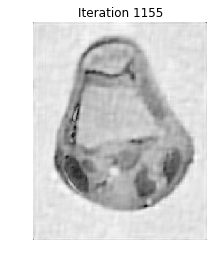

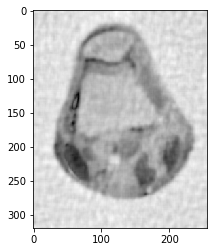

0.002883163703287857


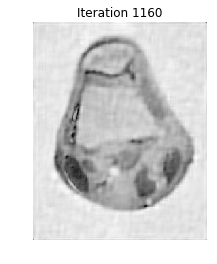

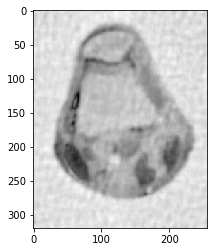

0.0028745734623332763


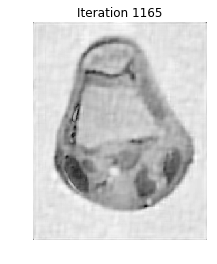

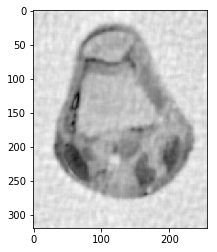

0.0028717672035942594


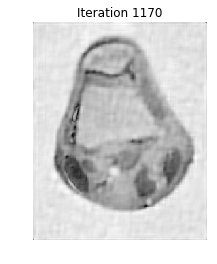

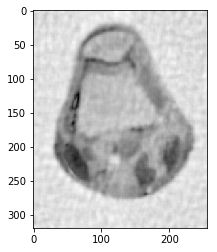

0.002840030961710871


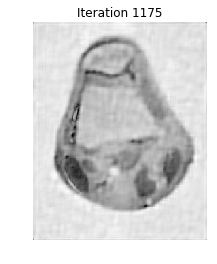

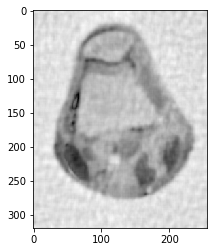

0.0028219997992993615


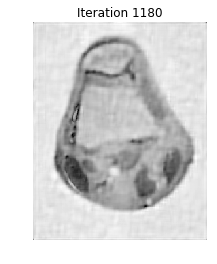

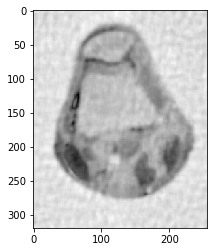

0.0028097989859171323


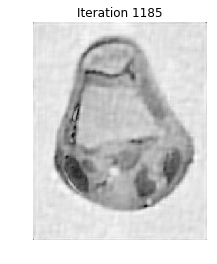

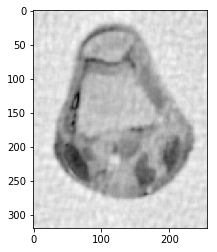

0.0028011146238617743


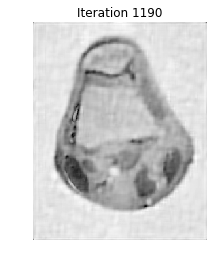

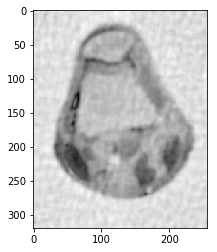

0.00280391070698143


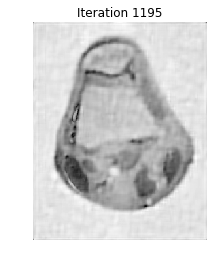

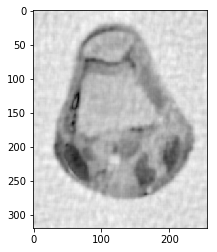

0.0028634354057351383


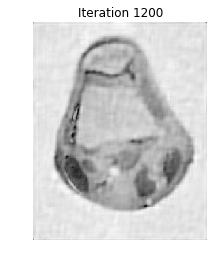

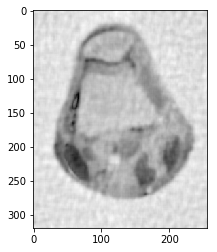

0.00317775702647686


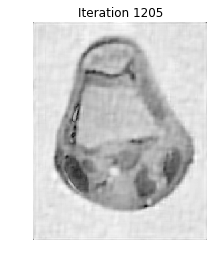

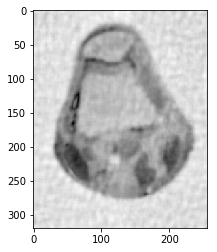

0.002994183155132041


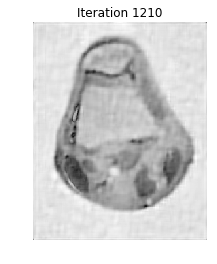

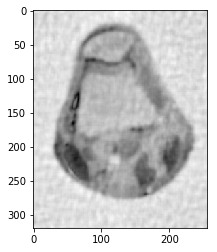

0.0028744322843127783


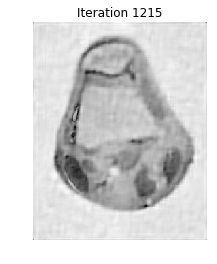

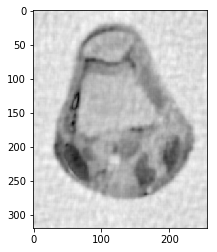

0.002831702195440663


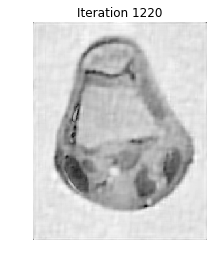

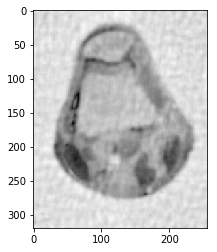

0.0028176436857188193


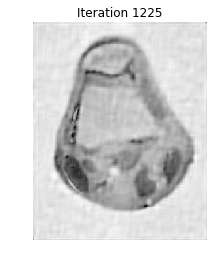

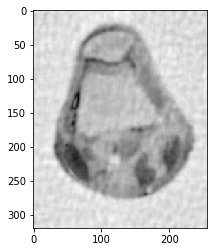

0.0028101504194224286


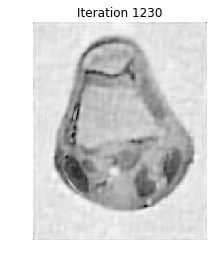

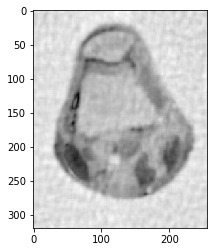

0.002801501356485992


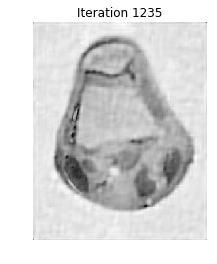

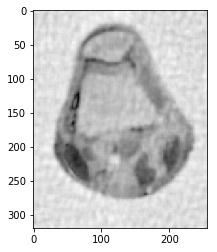

0.002792730541649643


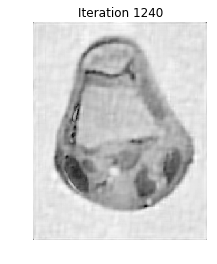

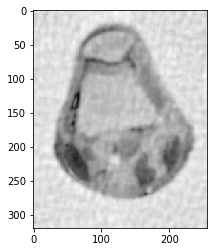

0.0027867341291149257


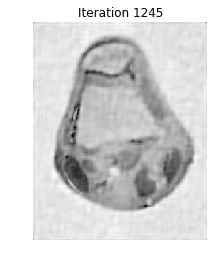

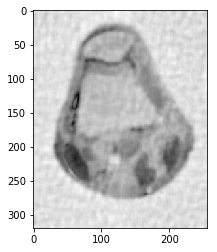

0.0027845522752852504


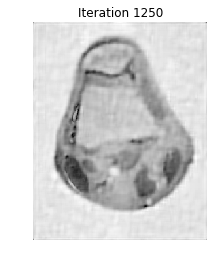

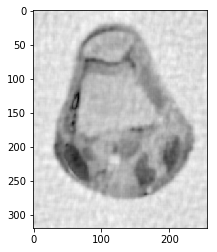

0.0027794458478019313


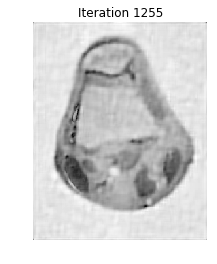

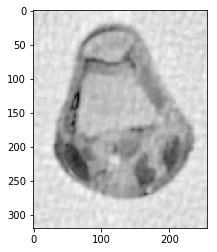

0.0027785796439729607


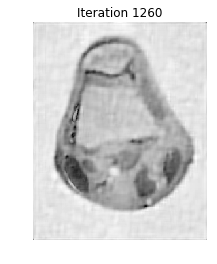

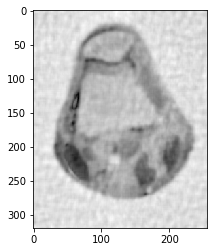

0.0027773905016412925


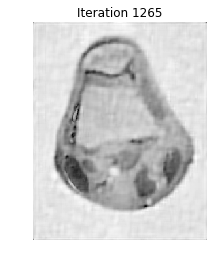

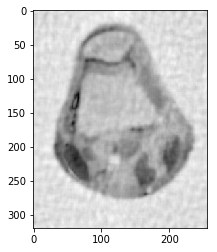

0.002780563391480363


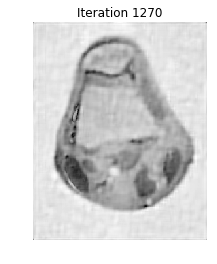

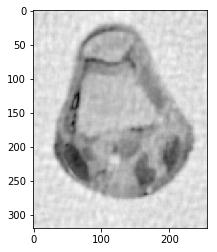

0.002791989799737331


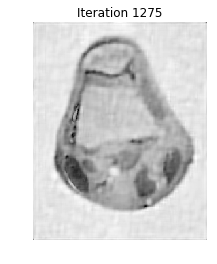

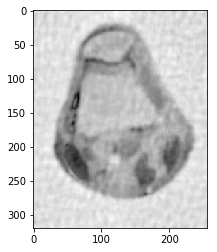

0.00283446176428562


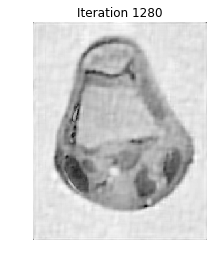

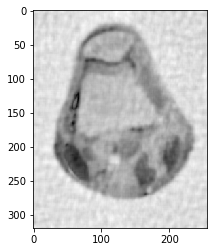

0.0027829099920794525


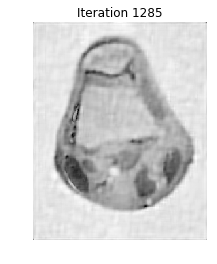

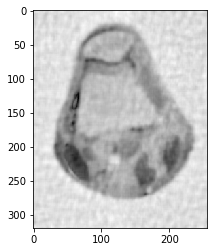

0.002790391396585208


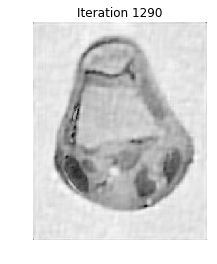

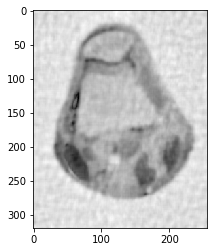

0.0027810761491025332


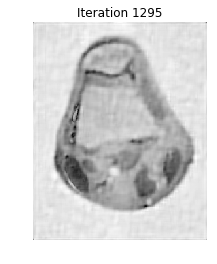

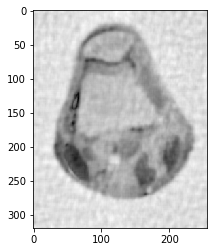

0.002773610972302063


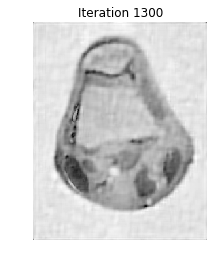

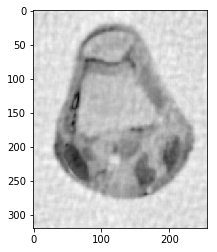

0.002784785982160125


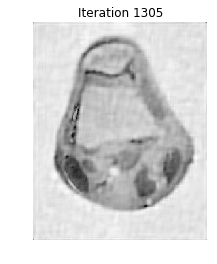

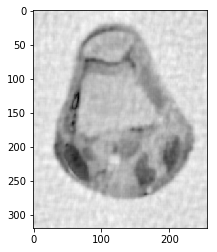

0.0027894133670802526


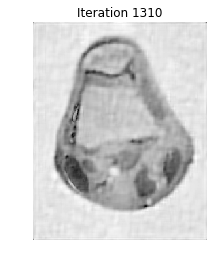

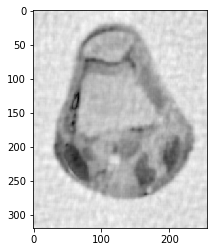

0.0027599940553618475


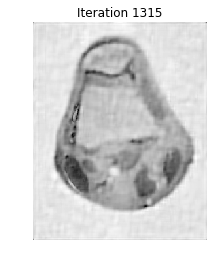

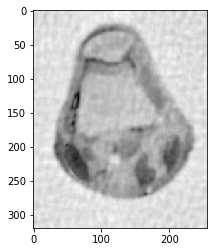

0.0027670987444361377


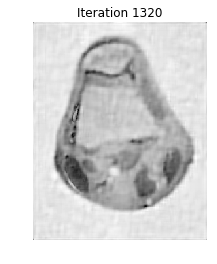

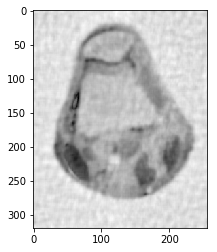

0.0027908685839663208


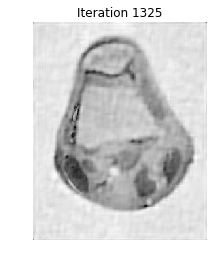

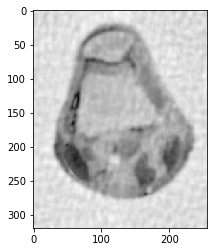

0.003089157426139628


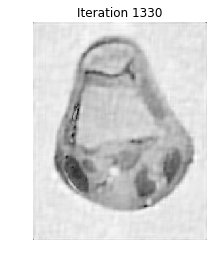

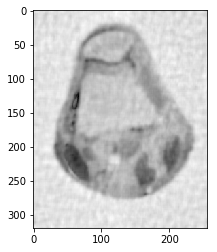

0.0028099994452103036


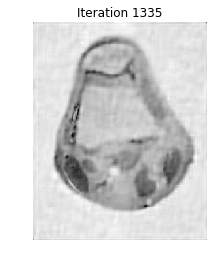

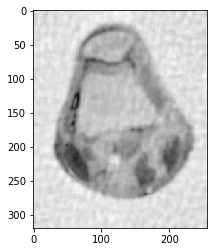

0.0028329905145722057


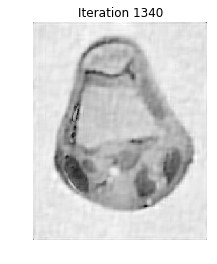

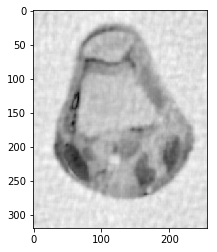

0.0028756356096503112


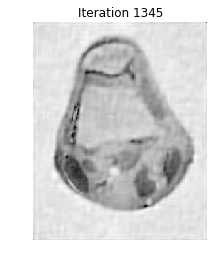

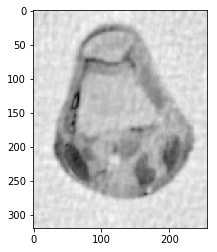

0.0027603680883046345


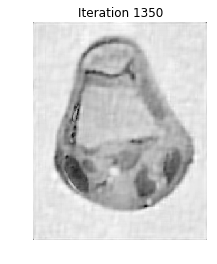

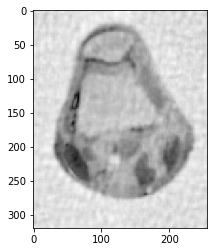

0.0027742604960847342


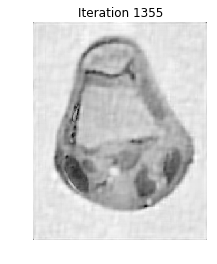

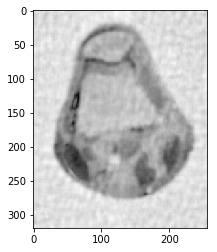

0.0027734197765242824


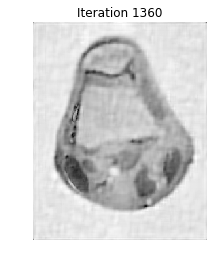

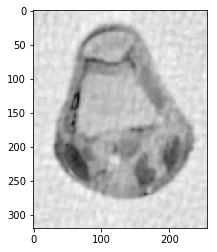

0.002747763585371847


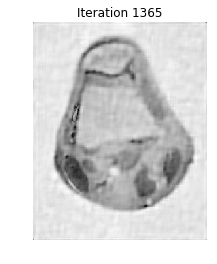

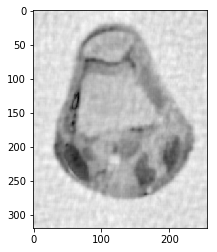

0.0027455063280707468


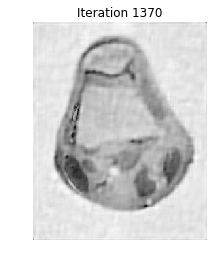

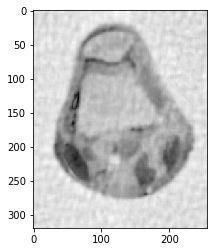

0.0027465295385046325


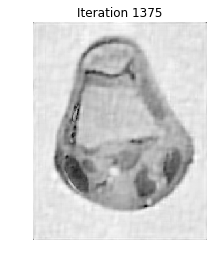

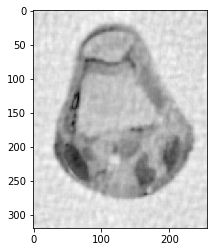

0.0027429224058085813


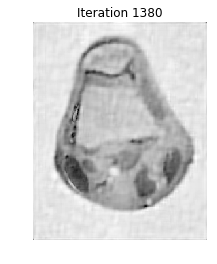

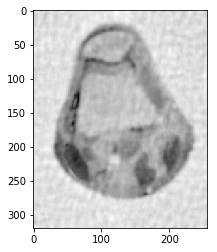

0.0027394582391043532


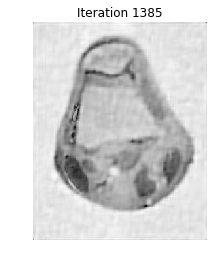

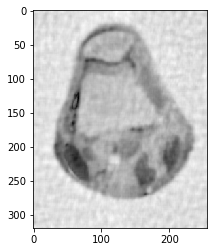

0.0027374721241345394


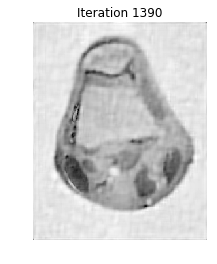

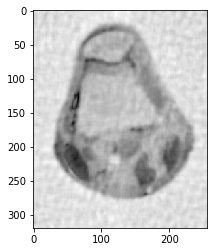

0.0027358355487225195


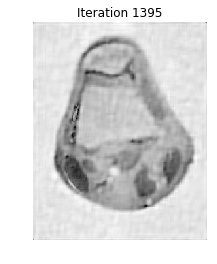

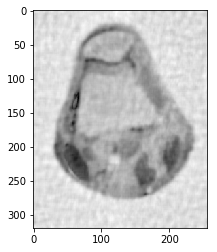

0.002734357763690691


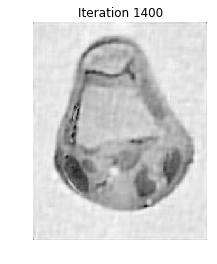

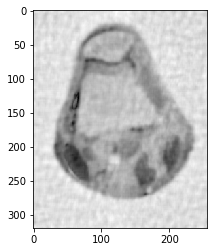

0.002732771526361464


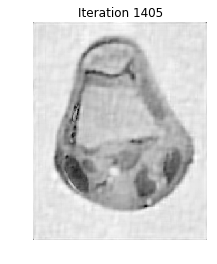

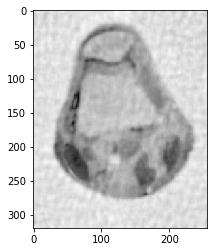

0.0027406843101621297


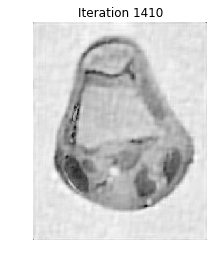

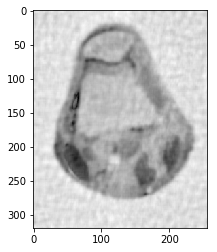

0.0027875559393766344


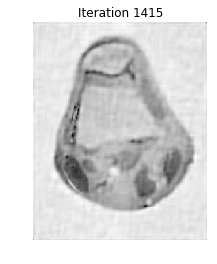

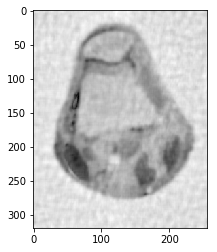

0.0027686944076589113


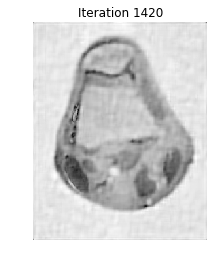

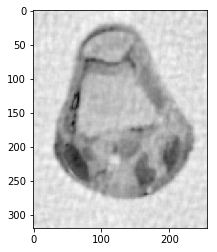

0.0027579849337648673


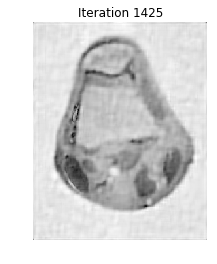

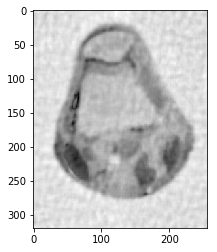

0.0027515808539873964


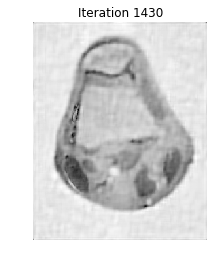

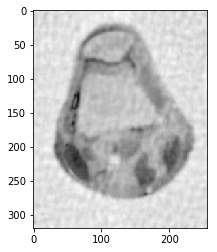

0.002735830863559623


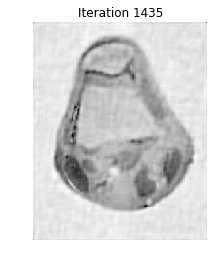

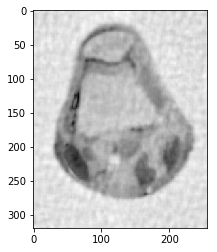

0.002735538622621242


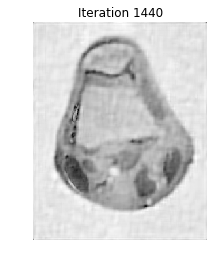

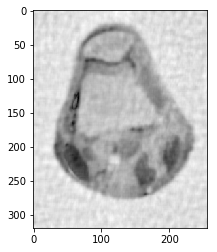

0.002725874924663509


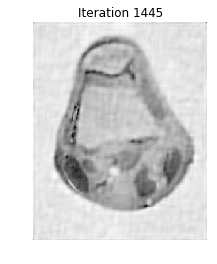

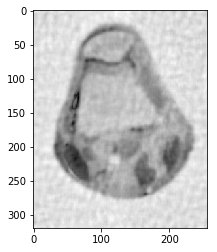

0.0027335091523510873


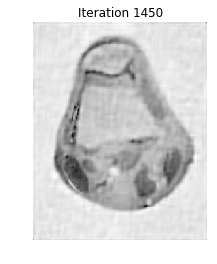

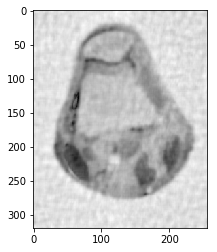

0.00274883380065155


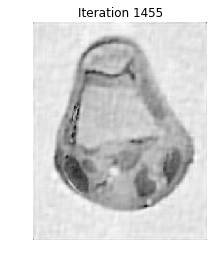

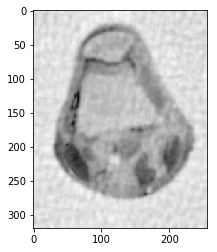

0.0027974609952498247


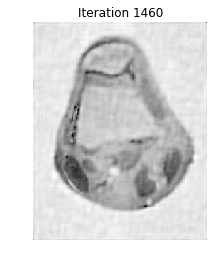

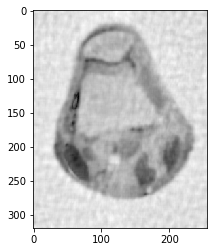

0.00277908316839967


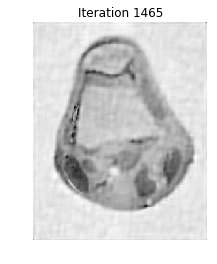

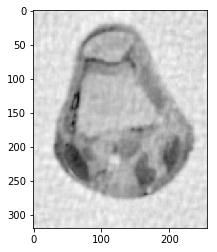

0.002764506695693105


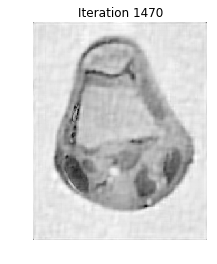

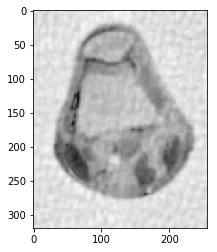

0.002744500333745348


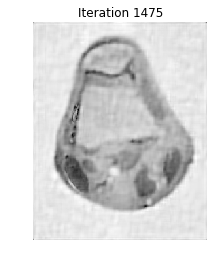

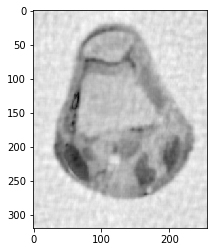

0.002719183149348243


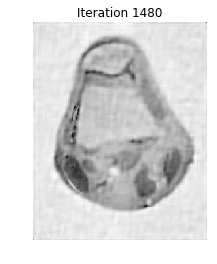

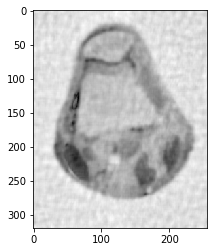

0.0027232697369464543


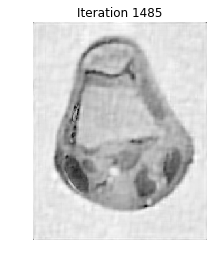

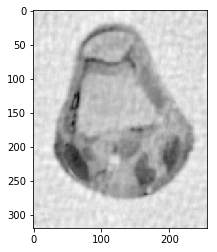

0.0027182814811928984


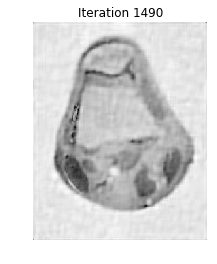

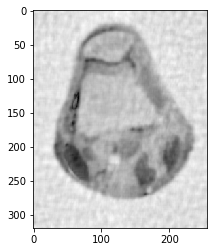

0.002717600739768672


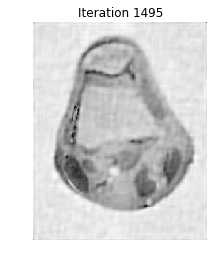

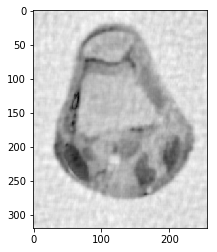

0.0027117209138945012


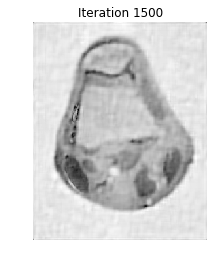

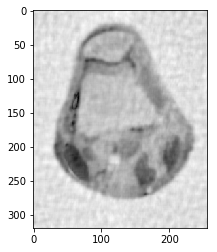

0.002710608300603694


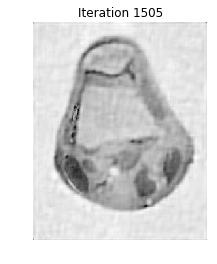

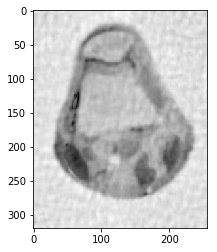

0.0027622215168534503


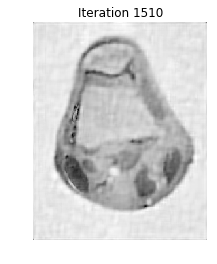

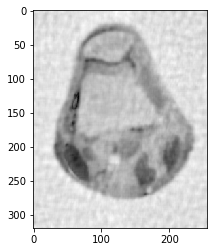

0.0037821404347559073


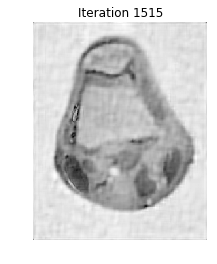

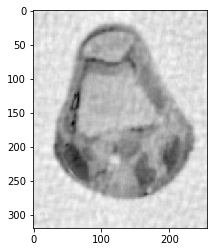

0.0030721796847784843


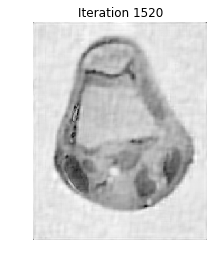

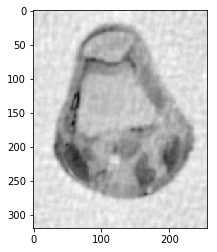

0.0031918296201488812


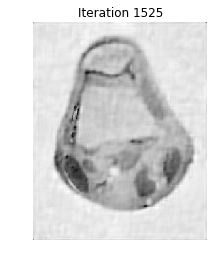

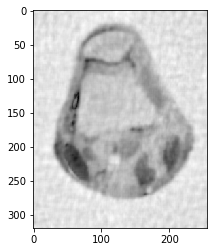

0.0030372148957715506


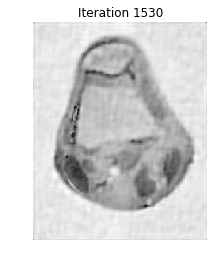

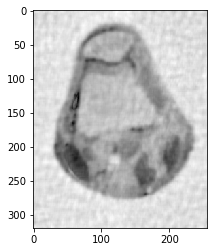

0.0028049962759922366


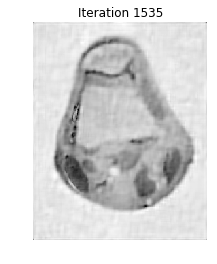

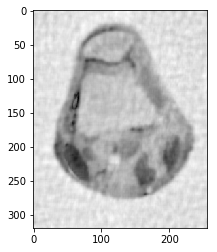

0.0027306616069193404


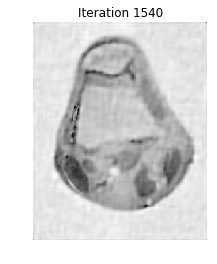

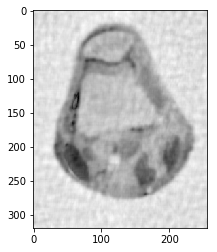

0.002716201352254888


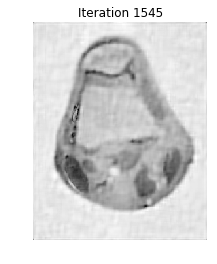

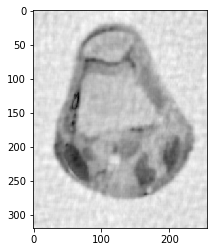

0.0027203769457944563


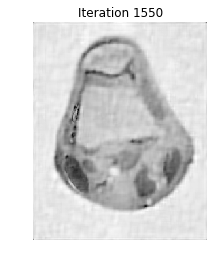

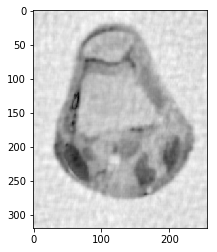

0.002731452298339934


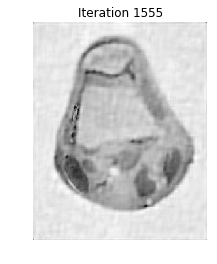

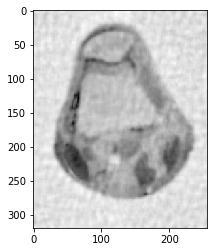

0.00272451146771674


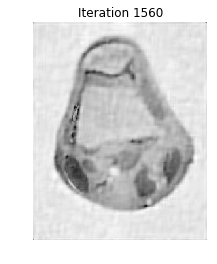

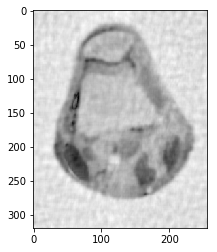

0.0027179099999372156


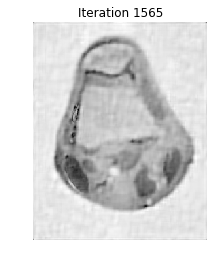

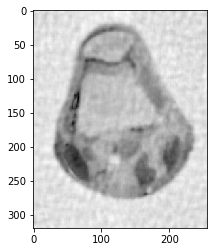

0.0027021047135750227


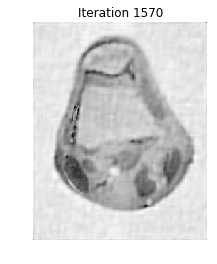

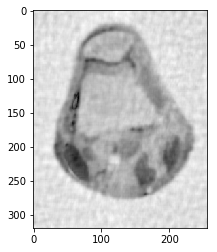

0.002701196419350777


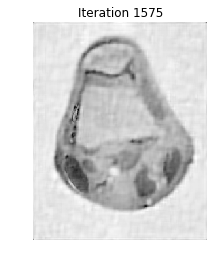

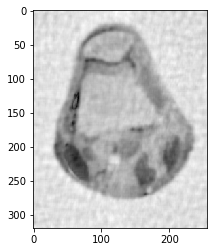

0.002703308496306452


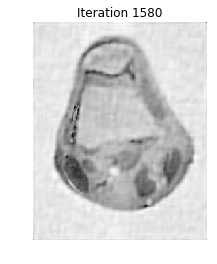

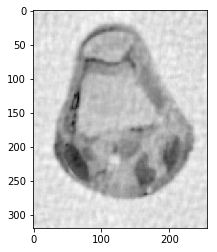

0.0026977108865821483


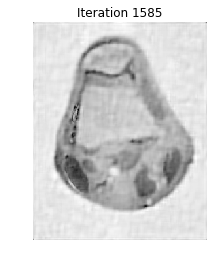

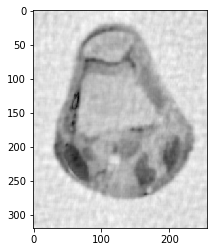

0.002697256532190975


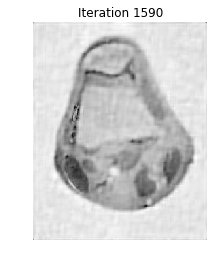

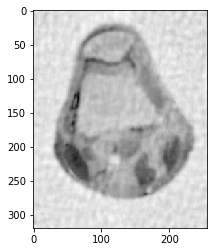

0.0026958224242442223


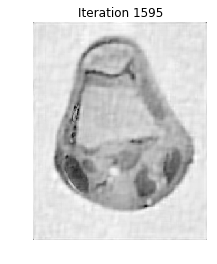

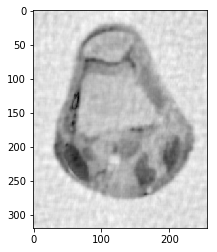

0.0026954691552107486


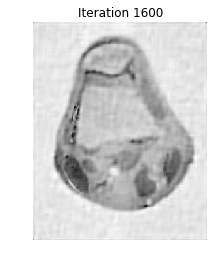

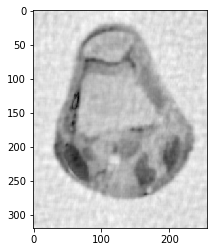

0.002693227009256216


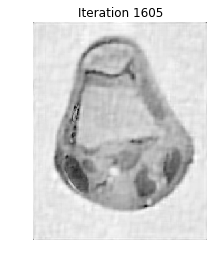

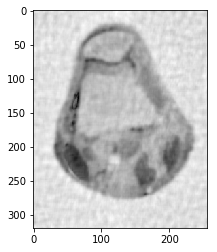

0.0026921284835146864


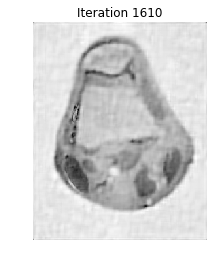

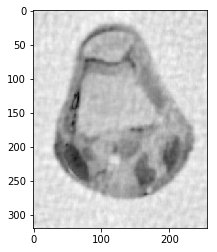

0.00269184205259343


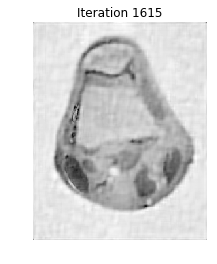

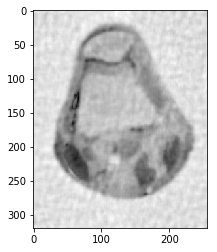

0.0026916563196055605


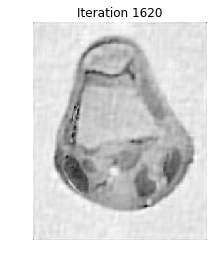

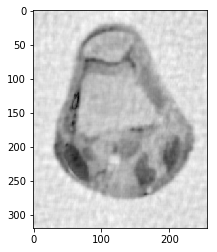

0.0026888492839904476


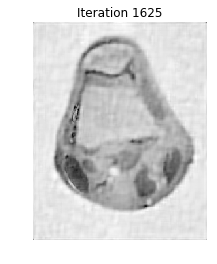

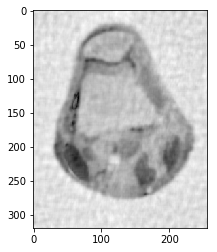

0.0026894058394666505


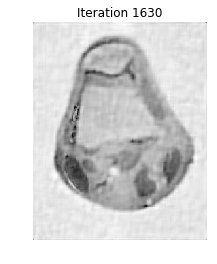

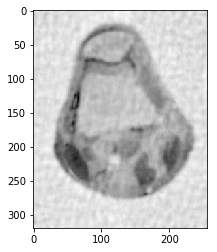

0.0026904855247335156


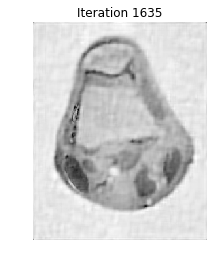

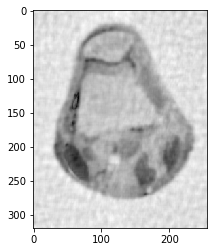

0.0026859473919858376


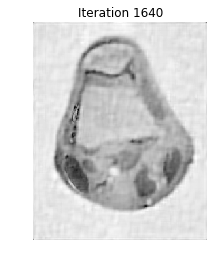

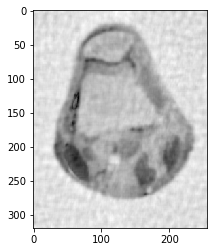

0.0026856978894329356


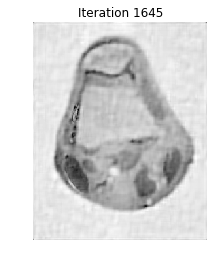

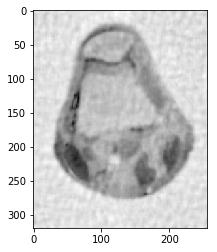

0.002691134401257663


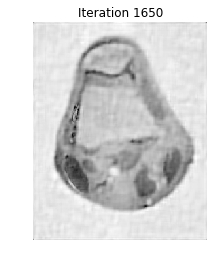

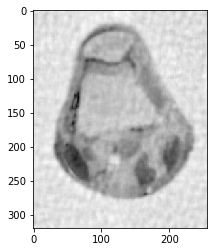

0.002695124077766973


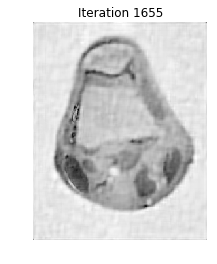

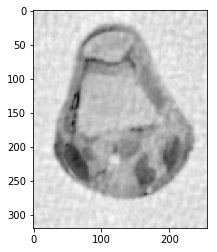

0.0026813393314378694


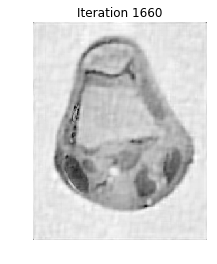

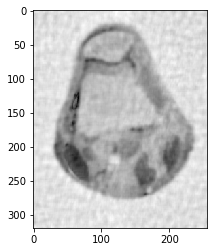

0.0026916935360770267


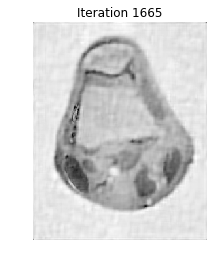

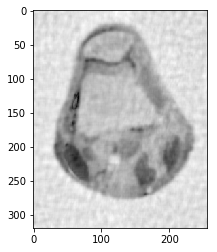

0.0026981402847444406


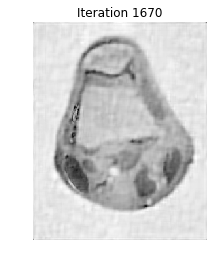

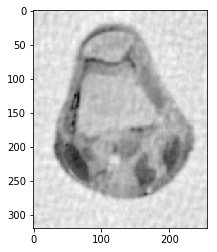

0.0026790716124757163


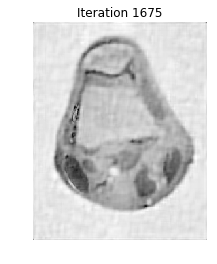

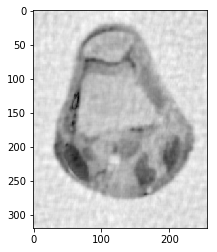

0.002696715751673621


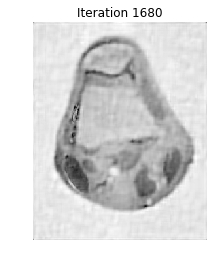

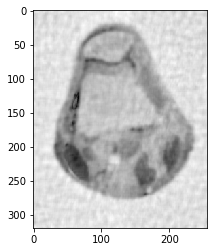

0.0026879972147935745


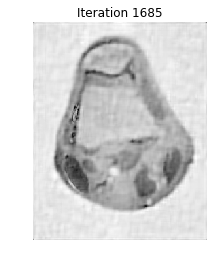

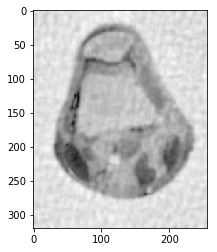

0.002682691397542133


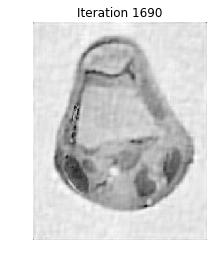

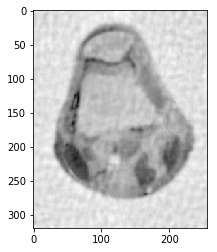

0.0026991810231528344


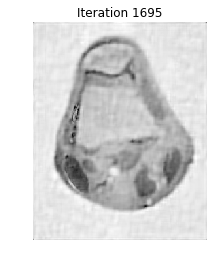

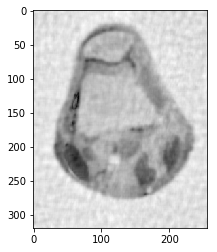

0.0026755874332815895


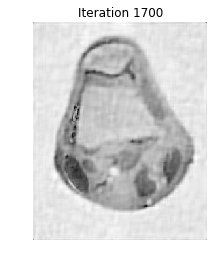

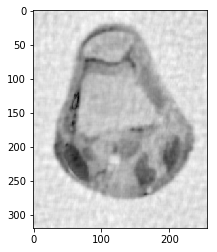

0.002689462169943135


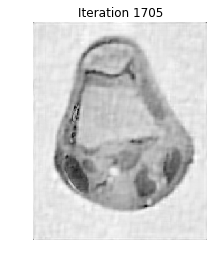

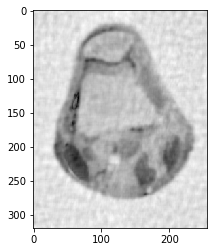

0.00269023341419189


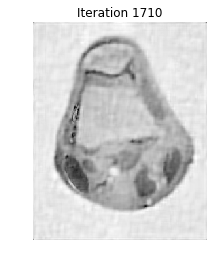

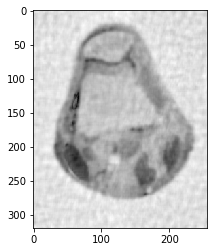

0.0026709760362906617


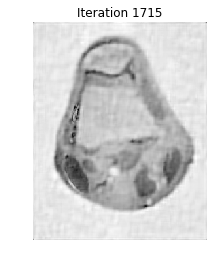

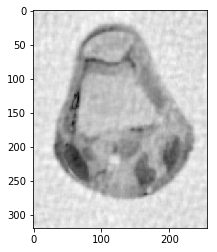

0.0026850917441993355


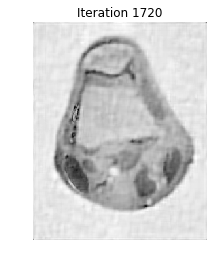

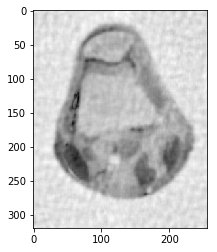

0.0026958872710999447


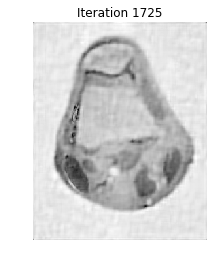

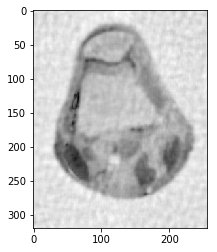

0.0026759109512603475


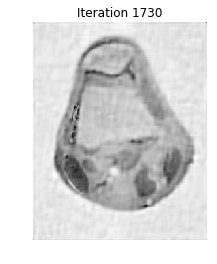

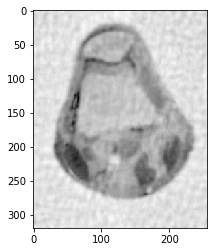

0.0026802245857812513


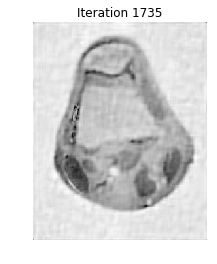

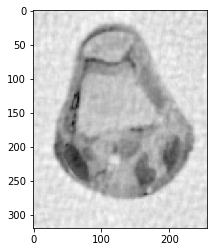

0.002702076313873919


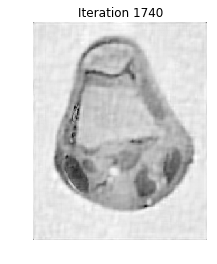

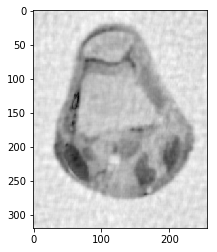

0.0026857836144860174


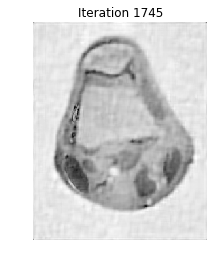

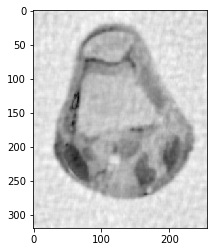

0.0026812463266488408


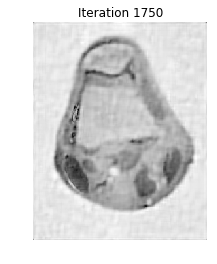

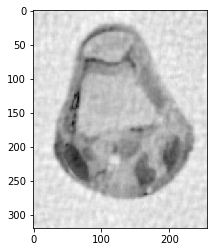

0.0026910850398766096


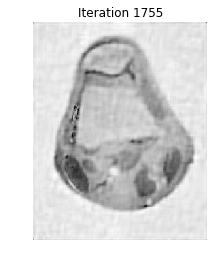

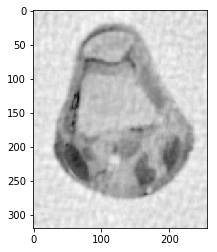

0.002666176618529782


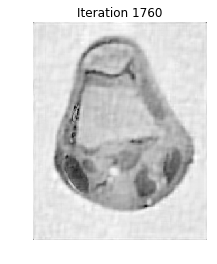

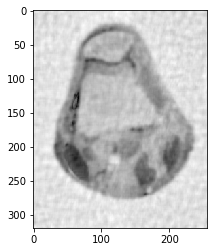

0.002683003440979198


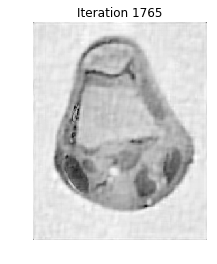

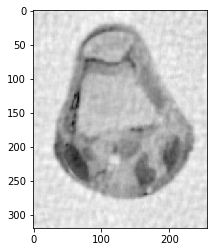

0.002700292230443647


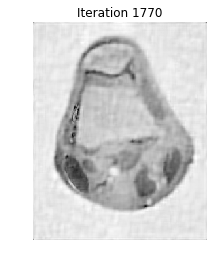

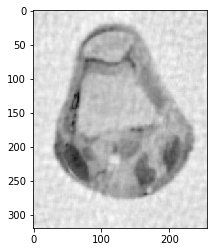

0.002676445302723836


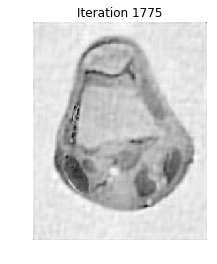

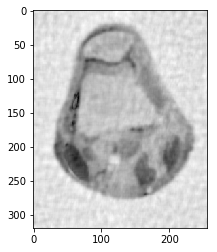

0.002680906325937691


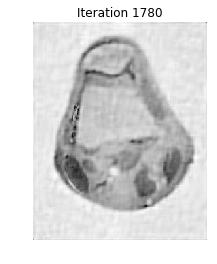

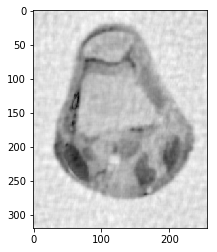

0.0026862699907439177


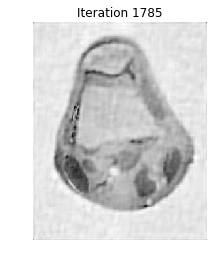

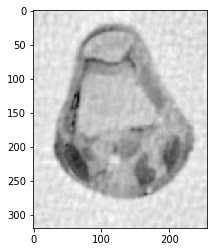

0.0026810257238190707


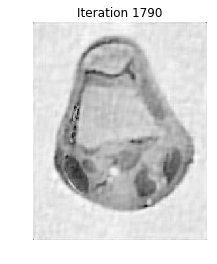

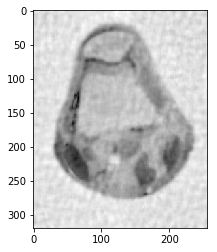

0.0026873905224552392


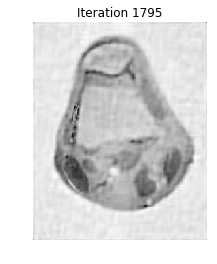

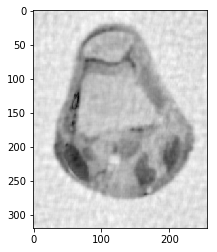

0.00267906736553136


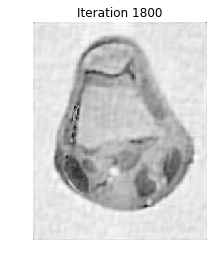

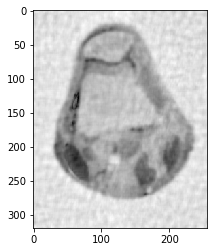

0.0026650542123732887


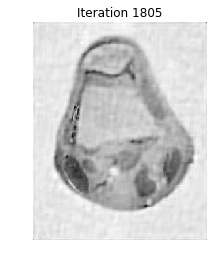

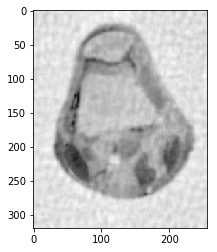

0.002667112149844265


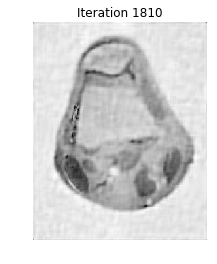

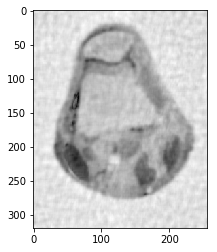

0.0028173561459570932


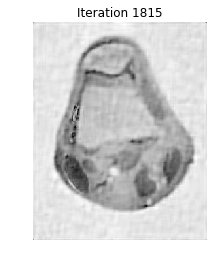

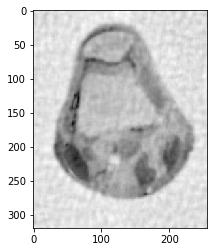

0.002999499944414101


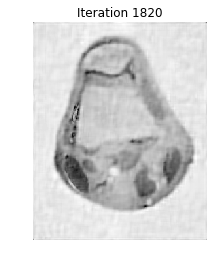

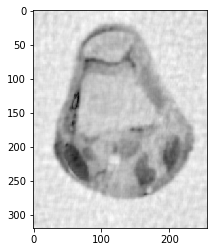

0.002766950327604081


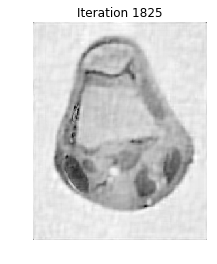

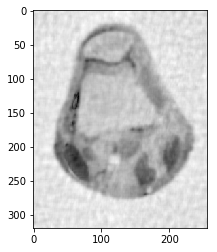

0.0027084100309131168


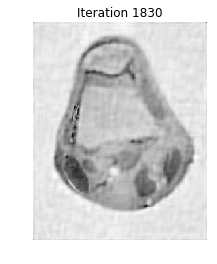

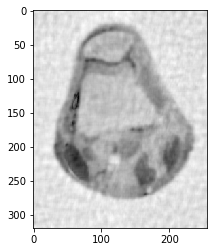

0.0027289313085279284


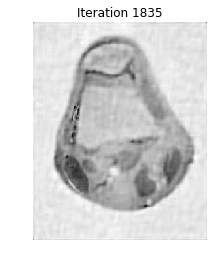

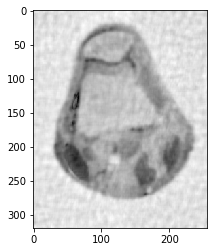

0.002662079870725079


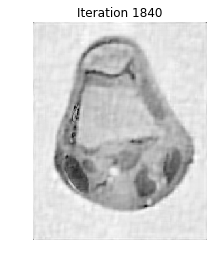

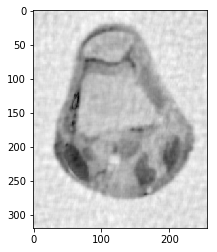

0.0026628127464083987


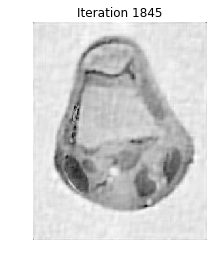

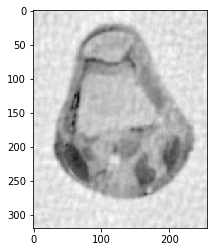

0.0026645698171939773


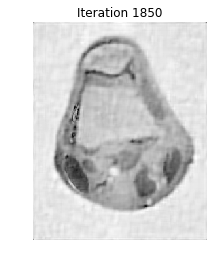

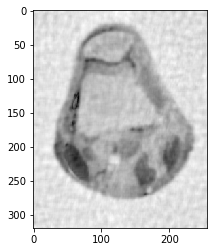

0.00265129859292505


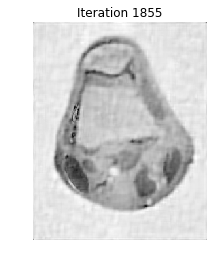

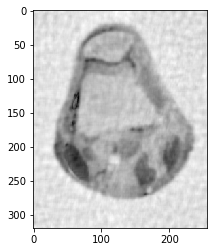

0.002647619805657384


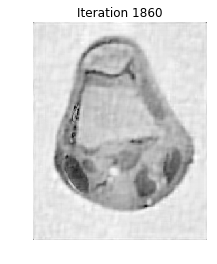

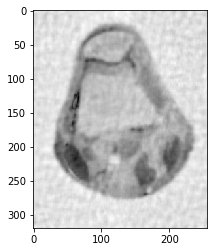

0.0026489289472763577


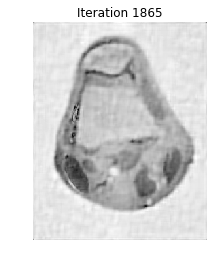

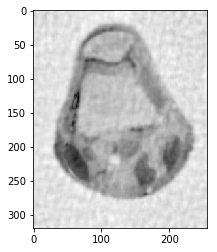

0.002648635928910151


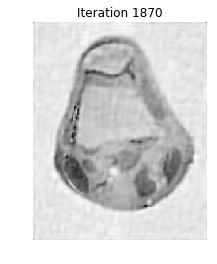

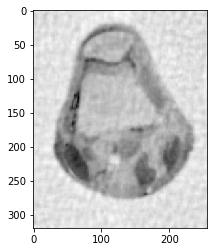

0.0026474609752533424


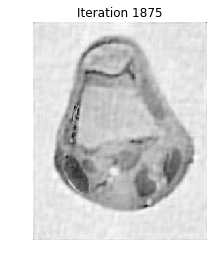

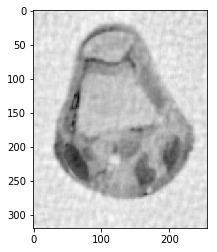

0.002645936979807857


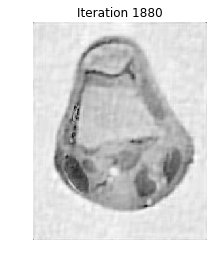

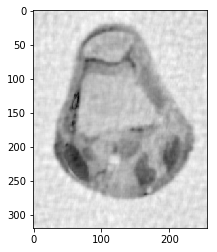

0.0026446378257682476


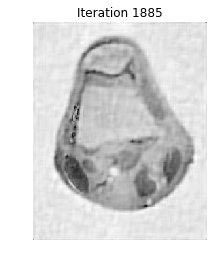

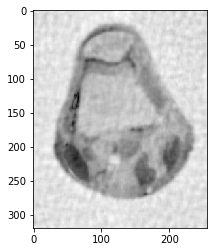

0.0026440826227946785


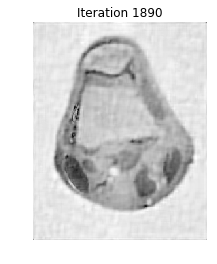

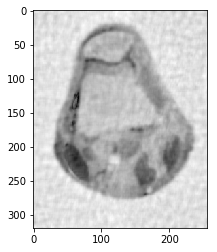

0.0026823647506733


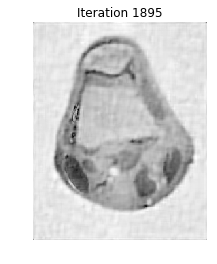

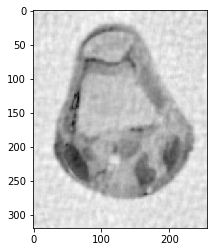

0.002851504374615949


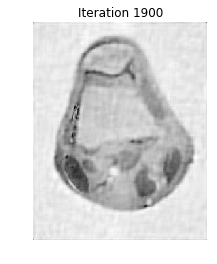

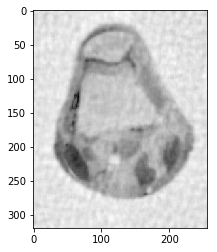

0.002728015177922997


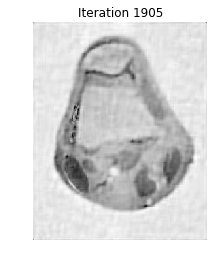

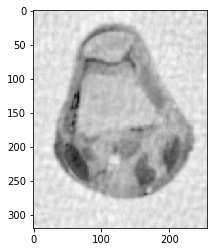

0.00265105300917081


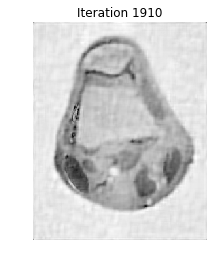

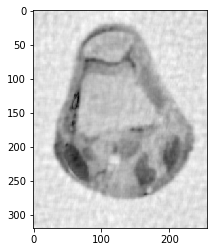

0.0026487933643804767


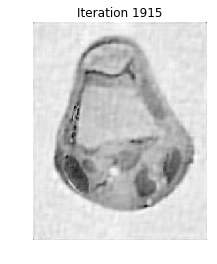

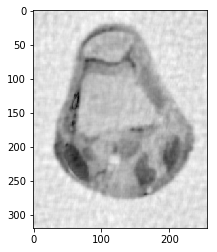

0.002670329981684624


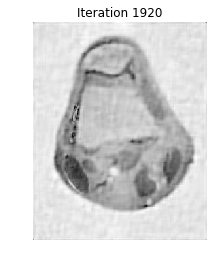

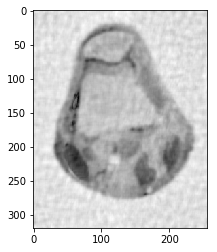

0.002669411268984872


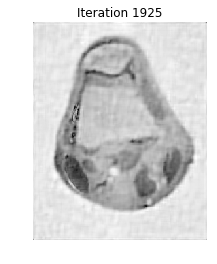

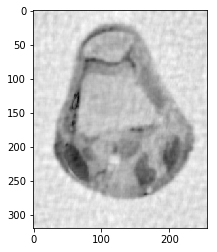

0.0026519067602055373


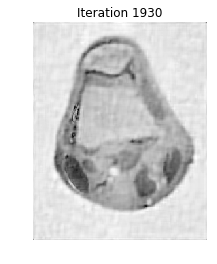

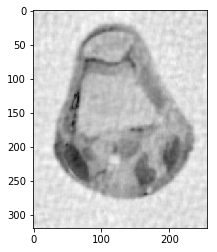

0.0026408127691534707


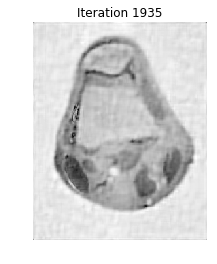

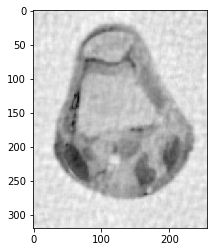

0.002640222921472733


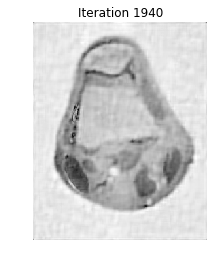

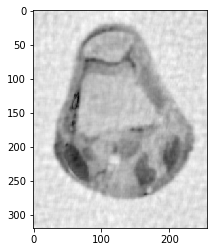

0.0026413909219908252


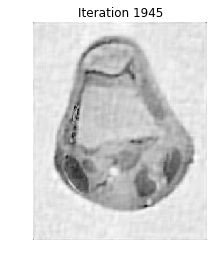

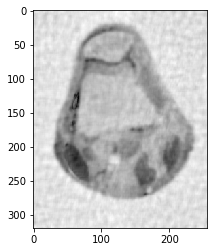

0.002637600025189878


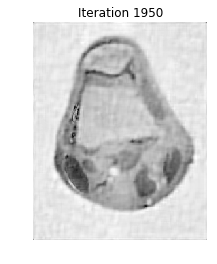

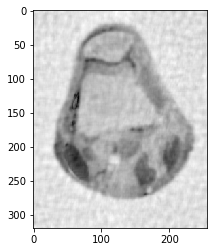

0.002637807139402891


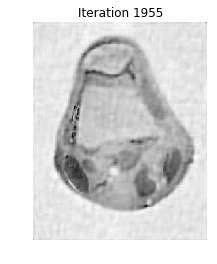

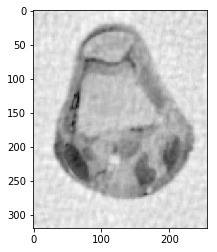

0.0026389930730938782


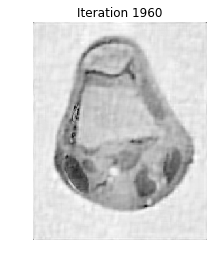

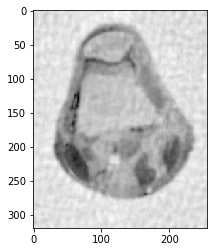

0.0026651696907320443


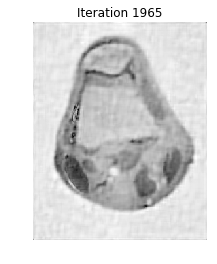

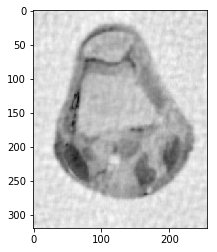

0.0026889380546067224


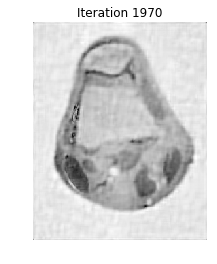

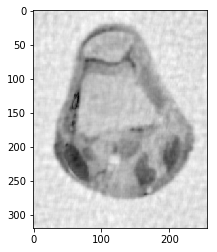

0.0026398252420752125


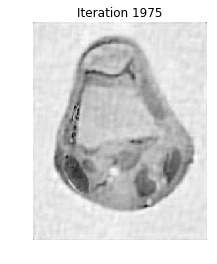

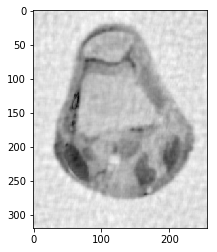

0.0026577850675292966


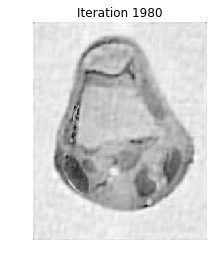

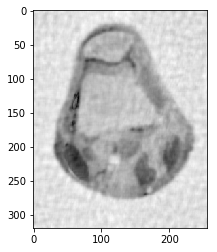

0.0026467609819722008


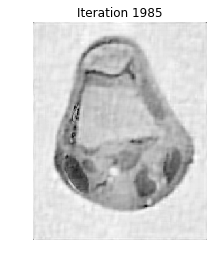

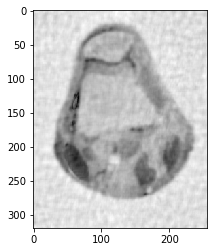

0.0026373113365878156


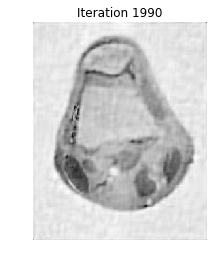

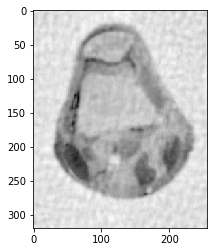

0.002648235688198236


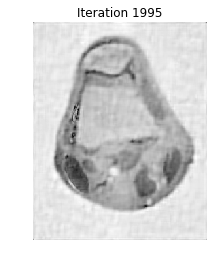

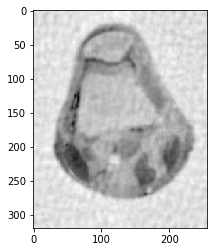

0.0026313369947483824


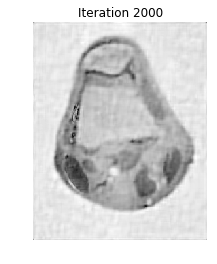

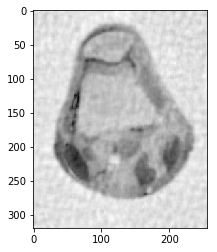

0.0026399527943842213


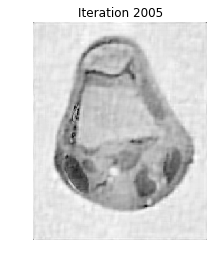

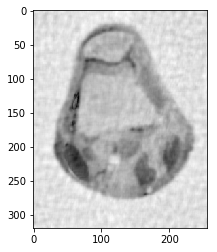

0.0026416016283281507


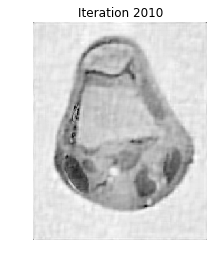

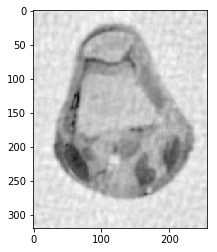

0.0029121809693098783


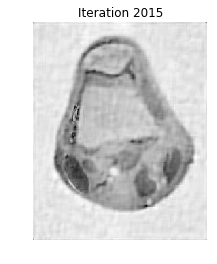

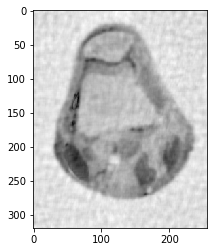

0.002675250601137871


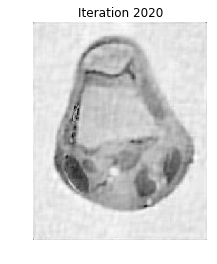

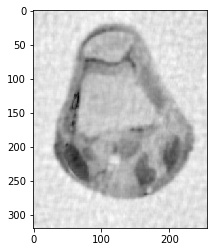

0.002689447977690503


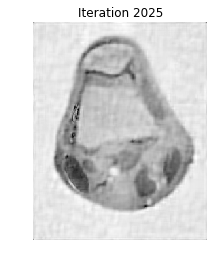

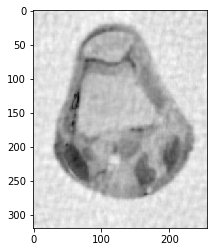

0.0027659994139160827


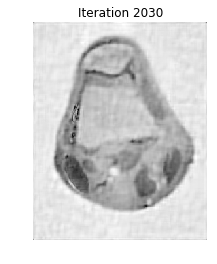

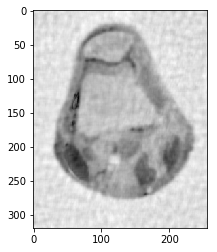

0.0027024164282866575


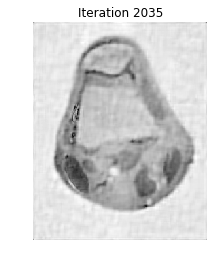

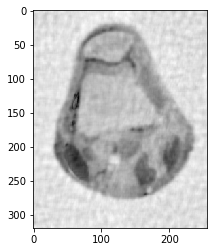

0.002631516839519014


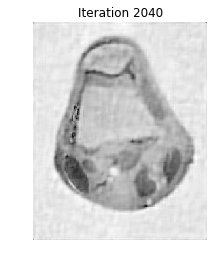

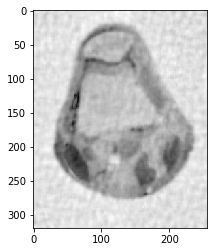

0.00265477284120355


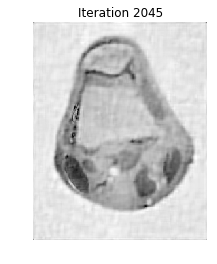

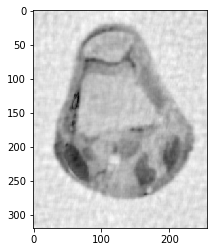

0.002642847998085762


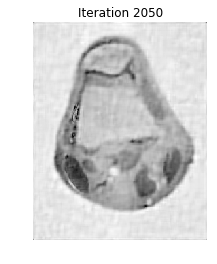

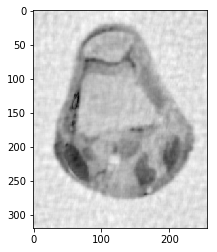

0.0026271539691876686


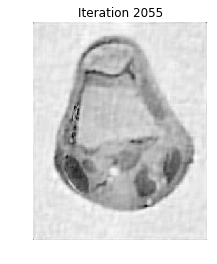

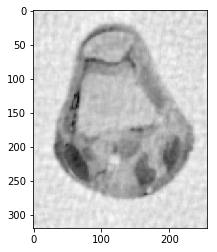

0.002627870039942478


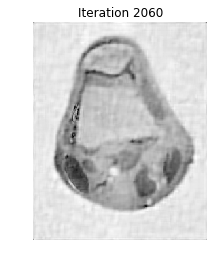

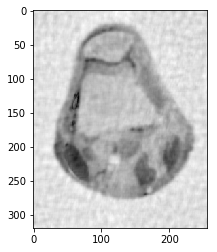

0.002628985465609644


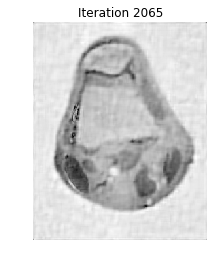

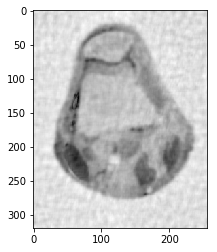

0.0026286196969945367


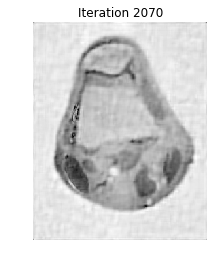

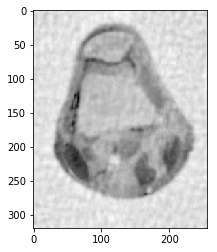

0.0026286447688581532


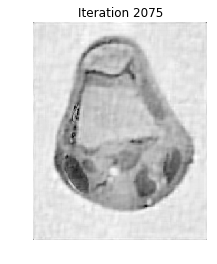

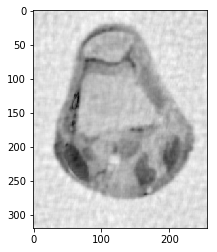

0.002628010911433527


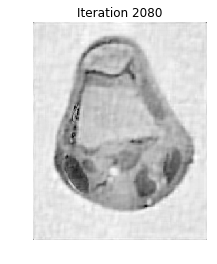

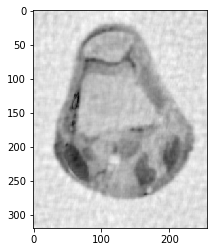

0.0026314926232866476


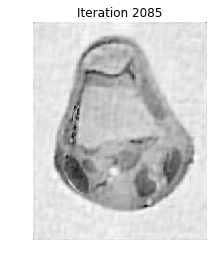

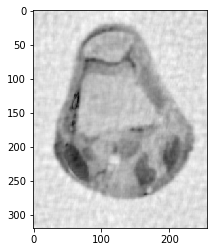

0.002633572844757499


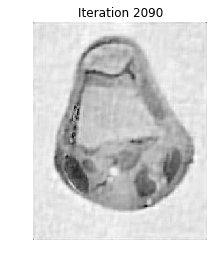

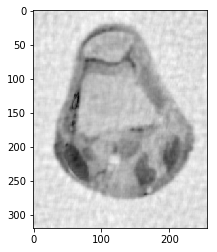

0.002624360720665248


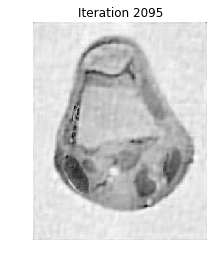

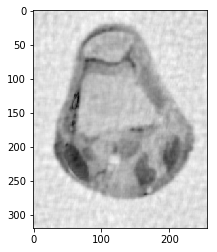

0.002622311690609897


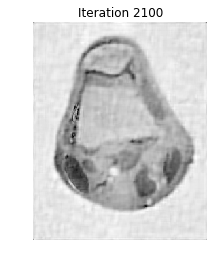

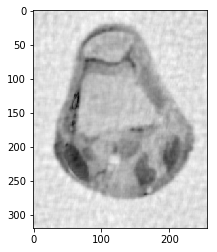

0.002633954755018667


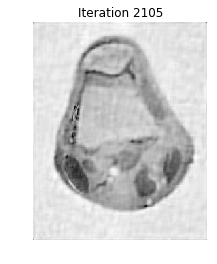

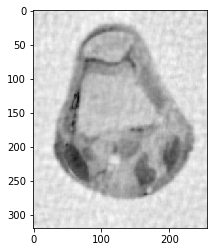

0.0026515549684521305


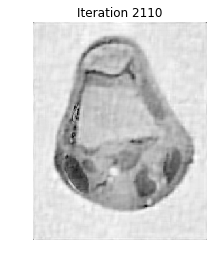

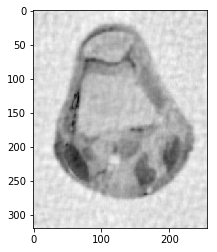

0.0026221980843109485


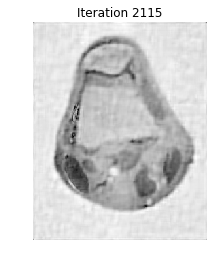

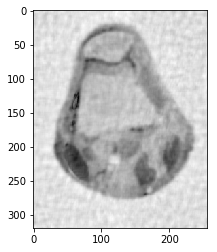

0.0026410485132846106


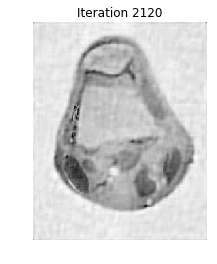

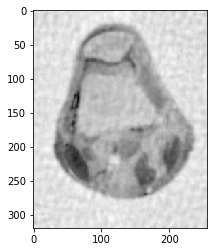

0.0026174995624433767


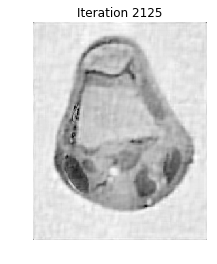

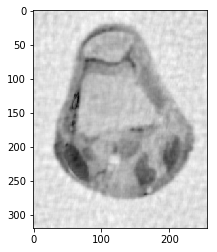

0.0026366429878848393


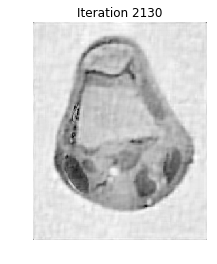

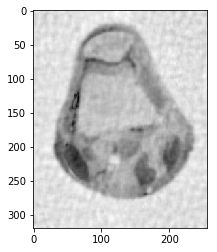

0.002614748032216255


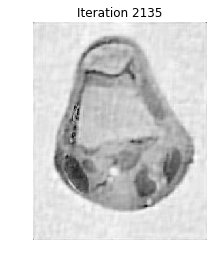

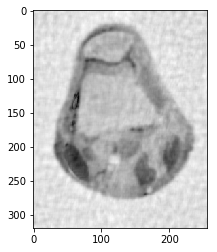

0.002624958763274271


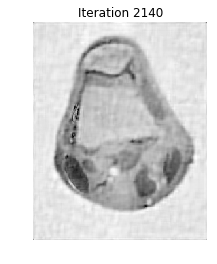

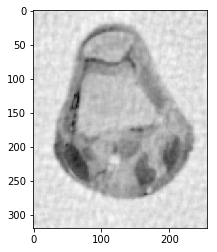

0.002619226126618866


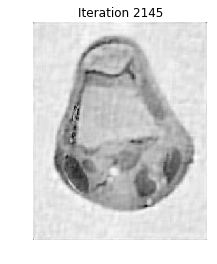

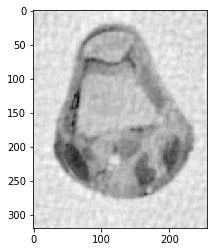

0.0026177271426730147


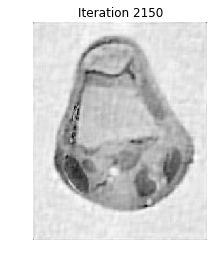

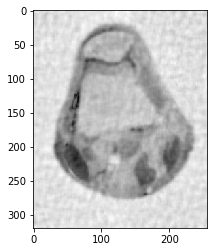

0.002645295931412486


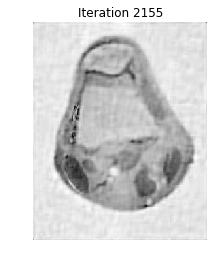

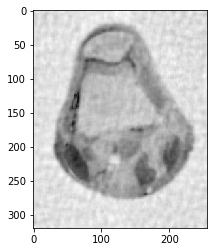

0.0026637772034693507


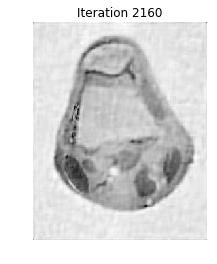

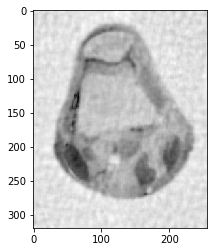

0.002769302774924634


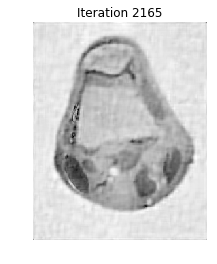

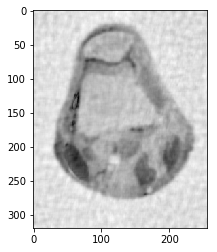

0.0027323240001208083


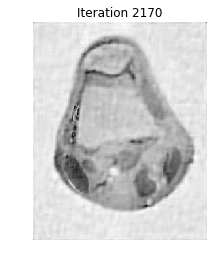

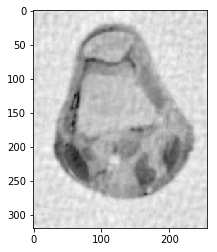

0.0026971955994395625


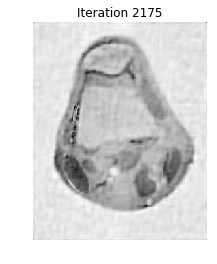

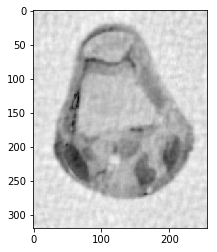

0.002657592898017121


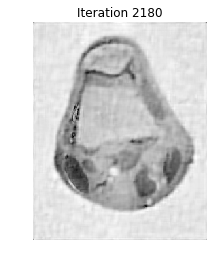

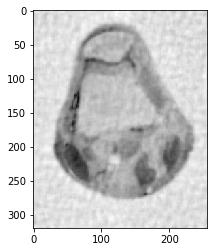

0.0026418304488031747


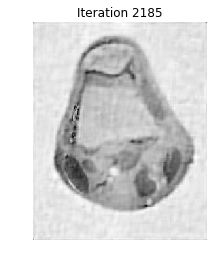

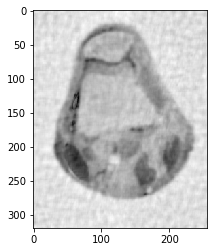

0.002629647561549635


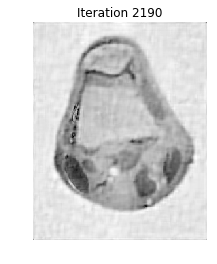

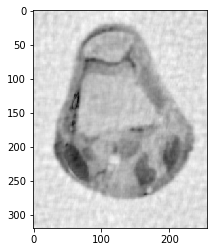

0.0026196441432939726


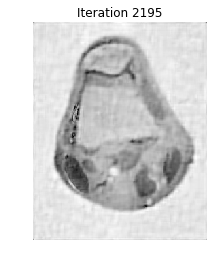

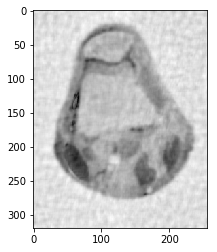

0.002618790972034254


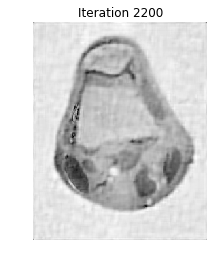

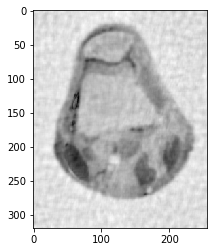

0.0026383497541469145


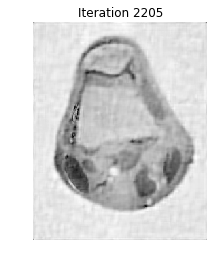

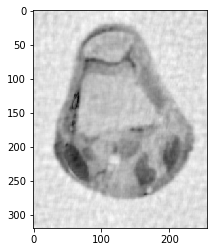

0.0027367086684277923


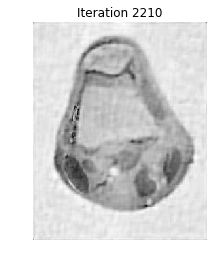

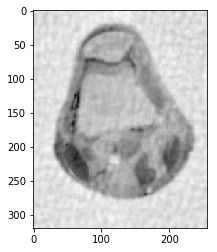

0.002602859672856132


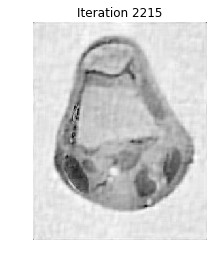

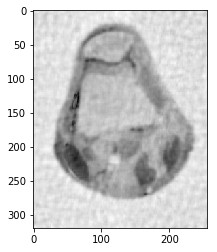

0.002646344821900689


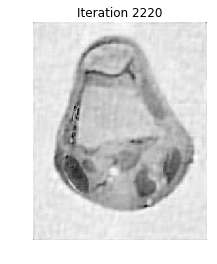

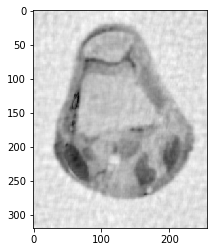

0.002630037746853911


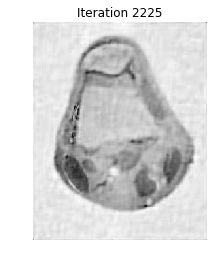

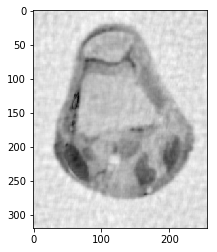

0.0026224780412977865


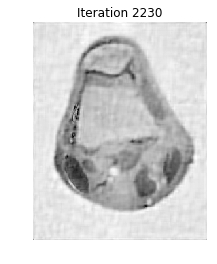

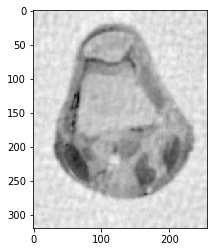

0.0026232382816274414


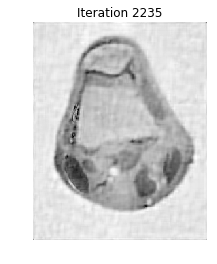

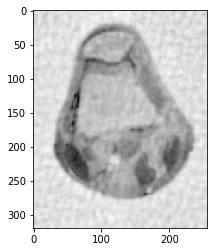

0.002605834328362339


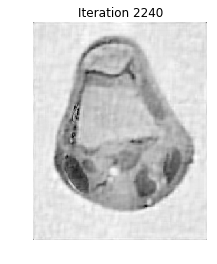

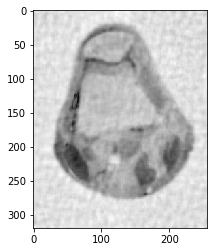

0.002601869822302329


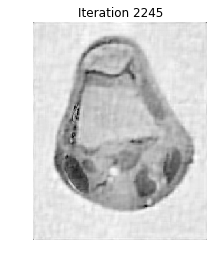

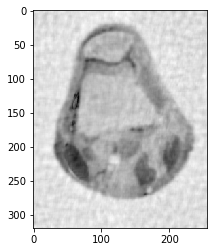

0.0026044007121257826


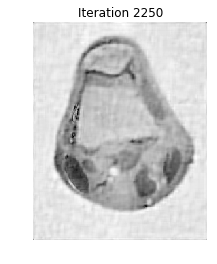

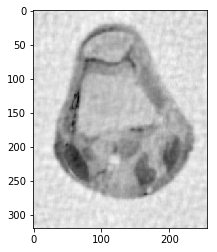

0.0026035964663090948


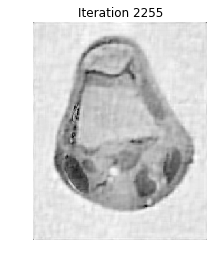

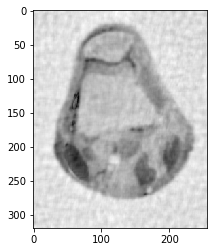

0.0026040505956569818


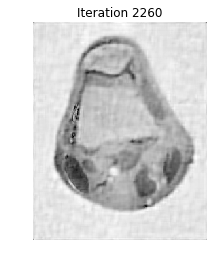

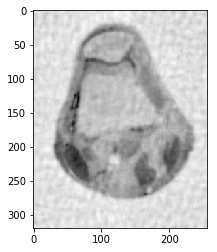

0.002649000595684043


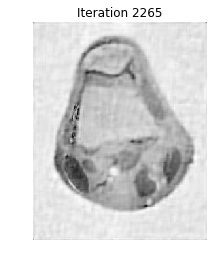

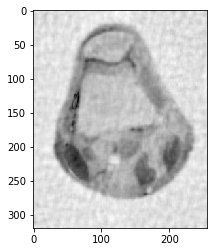

0.002874122132990303


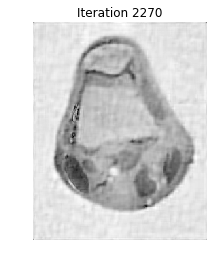

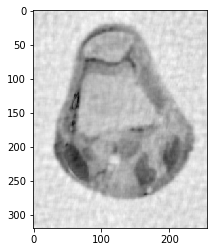

0.002698795073023795


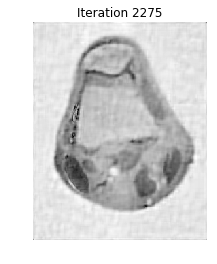

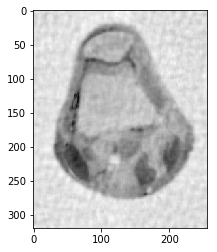

0.002654939788952531


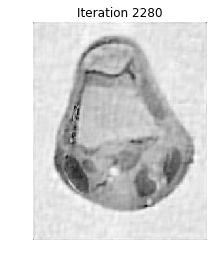

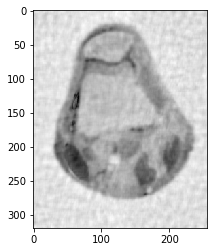

0.002632572299107126


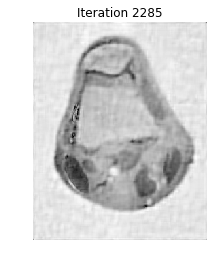

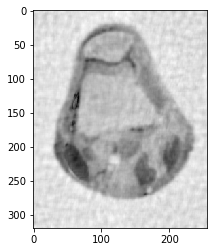

0.002618956990962753


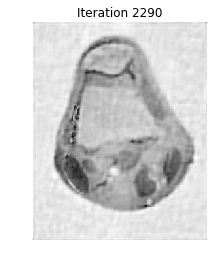

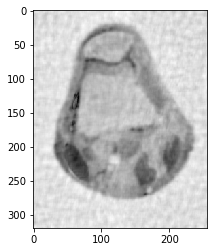

0.0026111890962528


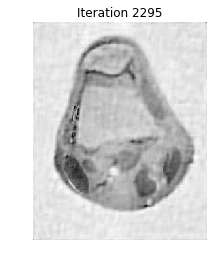

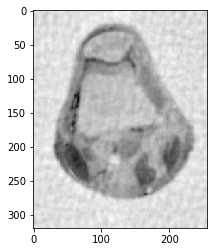

0.002602352110056065


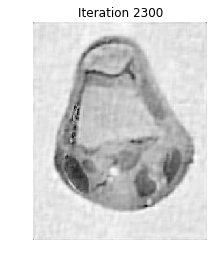

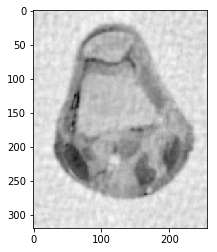

0.0025965490082158573


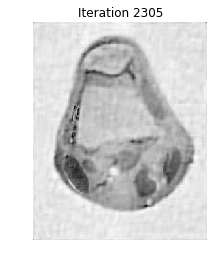

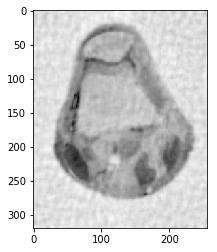

0.002594690428244732


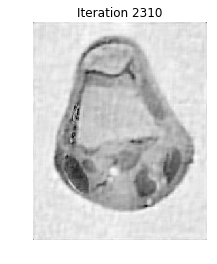

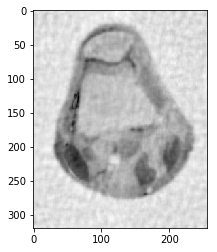

0.00259622712274123


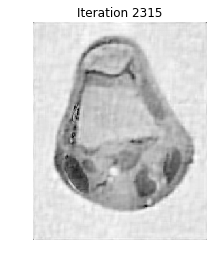

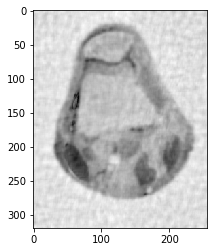

0.0026058830584434253


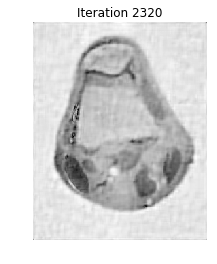

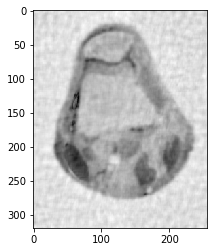

0.00262226098042742


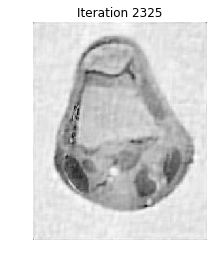

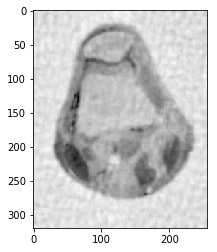

0.0026254409003974724


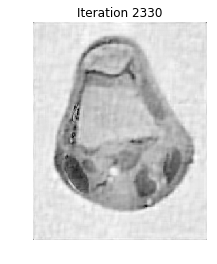

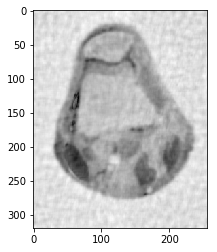

0.0025989749439731076


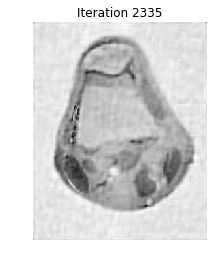

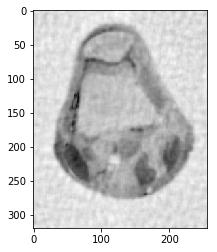

0.0026135908807802797


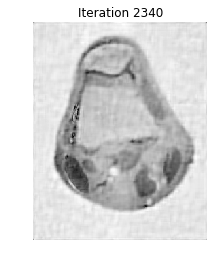

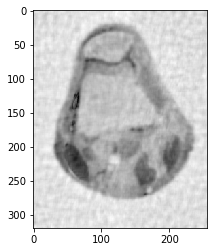

0.0026016822195181785


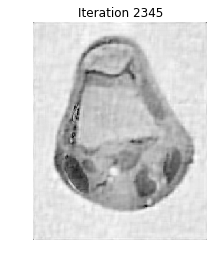

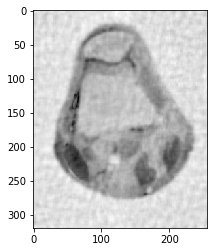

0.002602475737301158


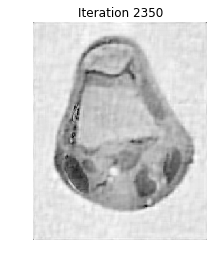

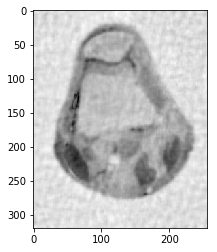

0.002610680064985972


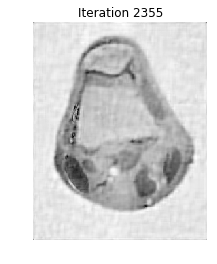

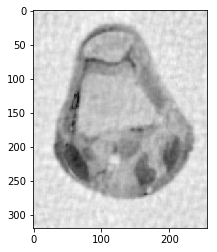

0.0026347313670267276


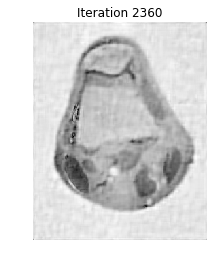

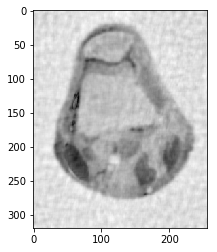

0.002591264293095925


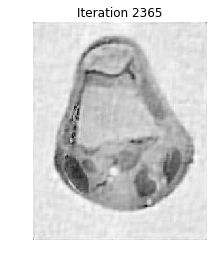

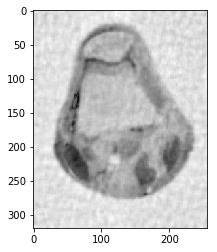

0.0026203921566439947


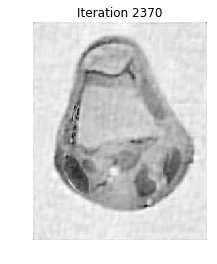

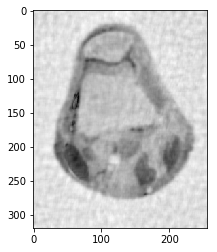

0.0025891247890668326


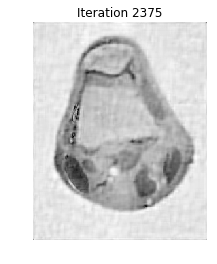

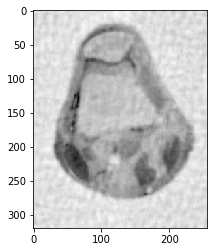

0.0026112440450591677


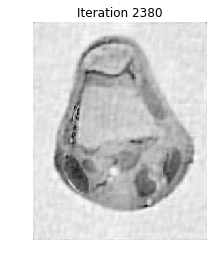

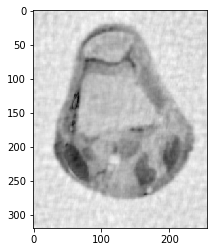

0.002639575856530227


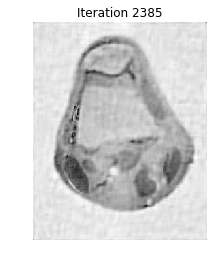

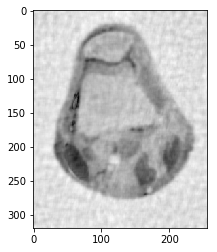

0.0036070665711487927


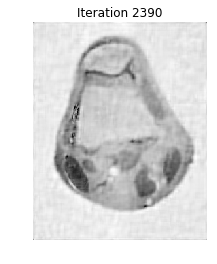

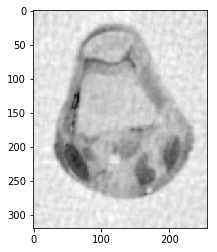

0.0033383888253262946


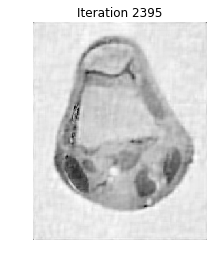

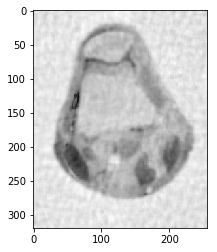

0.002723621771846818


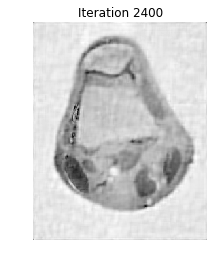

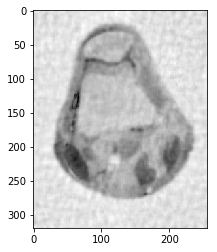

0.002735272392989459


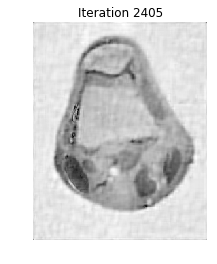

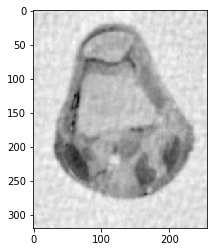

0.00262980157254935


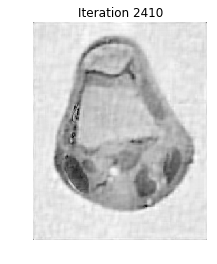

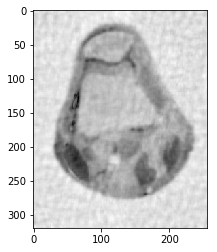

0.002687993560009064


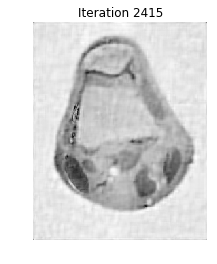

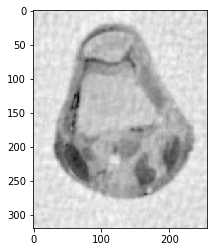

0.0025925120675648074


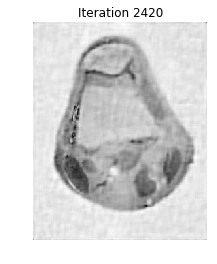

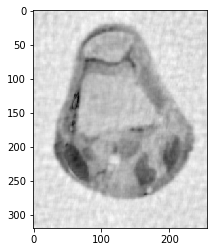

0.002609369338790897


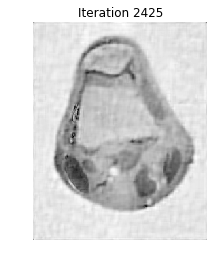

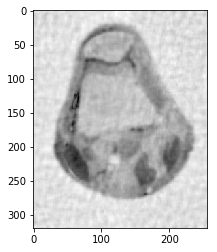

0.002587217754361261


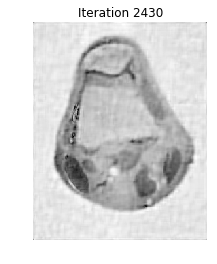

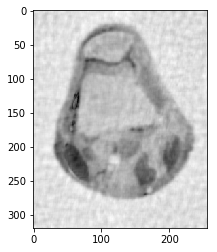

0.0025918497601335245


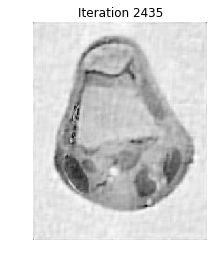

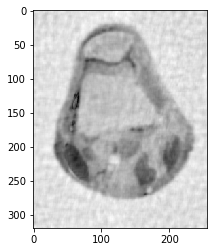

0.0025865632309464443


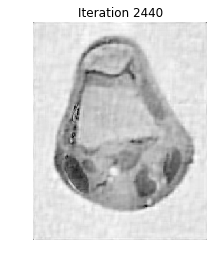

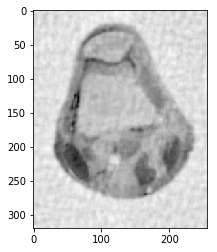

0.002589431869782518


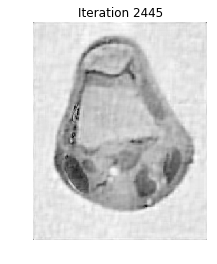

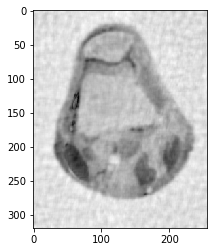

0.002585872124378112


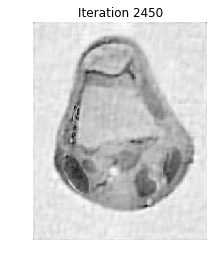

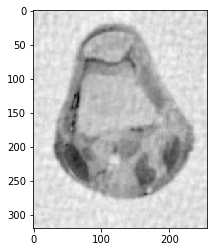

0.0025849050954163838


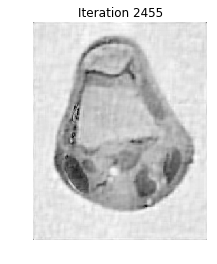

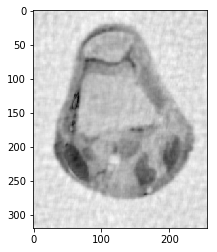

0.002584819838038224


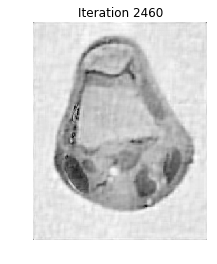

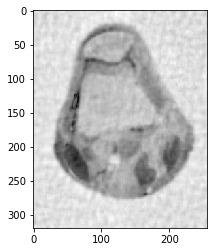

0.0025874083418794104


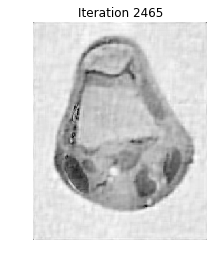

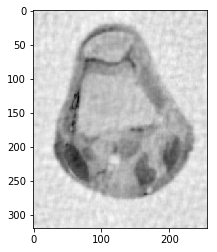

0.0025915275097565457


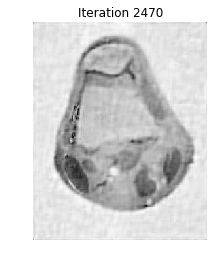

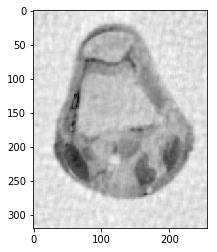

0.00258990748737301


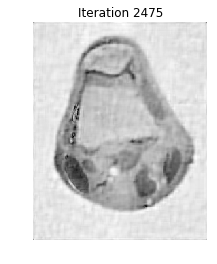

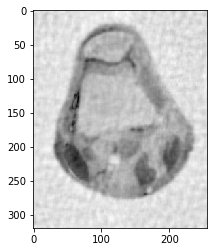

0.0025834414172689517


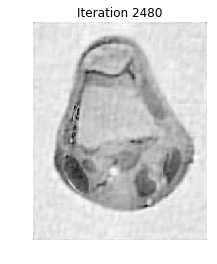

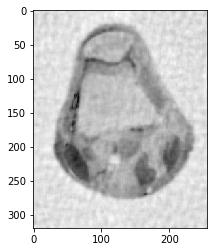

0.002584725945723652


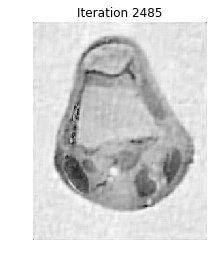

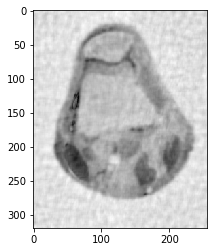

0.00260171967961867


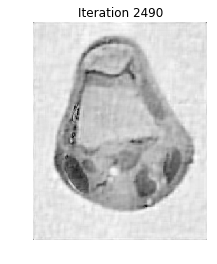

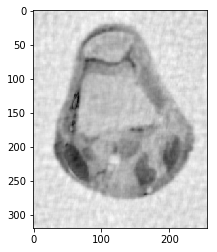

0.002620691945602007


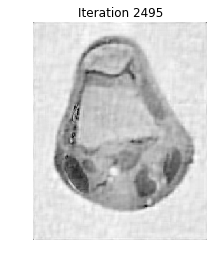

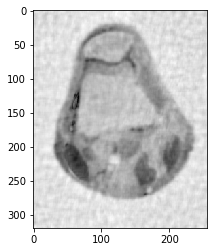

0.002580752716536899


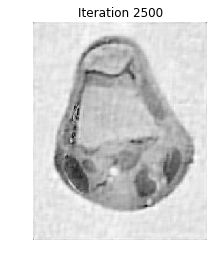

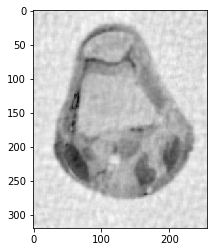

In [34]:
trials = 1
all_results = [] # same image, diff image, 2 diff, 4 diff
for i in range(trials):
    noisy = np.random.random(size=(320, 256, 2)) * 2 - 1
    test_noise = np.random.random(size=(320, 256, 2)) * 2 - 1
    epochs = 5
    iters = 500

    batch_size = 1
    print('start 1')
    noise = np.array([noisy for _ in range(batch_size)])
    jit_sched = [0.1 if k < iters // 2 else 0.01 for k in range(iters)]
    
    normalized_img = get_batch_normalized_2chan([100])
    normalized_img_sub = get_subsampled_normalized_2chan2(get_image_normalized_2chan(100), 4)
    normalized_img_sub = np.array([normalized_img_sub])
    
    
    autoencoder = define_network_4_2chan(verbose=True)
    autoencoder.compile(Adam(1e-3), loss = recon_loss_L1_2chan_fixed3)
    results, losses, new_noise = train_network_2chan(autoencoder, noise, normalized_img_sub, epochs, iters, normalized_img, [L1_loss, L2_loss], jitter_schedule=jit_sched, plot=True, batch_size=batch_size)
    all_results.append(losses)

    del autoencoder
    gc.collect()

#     print("start 2")
#     noise = np.array([noisy for _ in range(batch_size)])
#     jit_sched = [0.1 if k < iters // 2 else 0.01 for k in range(iters)]
    
#     normalized_img = get_batch_normalized_2chan([100])
#     normalized_new_img = get_subsampled_normalized_2chan(get_image_normalized_2chan(100), 4)
#     autoencoder = define_network_4_2chan(verbose=False)
#     autoencoder.compile(Adam(1e-3), loss = recon_loss_L2_2chan_fixed3 )
#     results, losses, new_noise = train_network_2chan(autoencoder, noise, normalized_img, epochs, iters, normalized_img, [L1_loss, L2_loss], jitter_schedule=jit_sched, plot=False, batch_size=batch_size)
#     all_results.append(losses)
    
#     del autoencoder
#     gc.collect()

In [10]:
np.save("fixed_results7" , all_results)

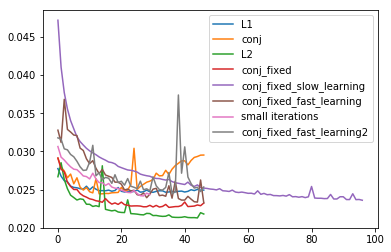

In [52]:
plt.plot(losses1[0][3:] , label = "L1")
plt.plot(losses2[0][3:] , label = "conj")
plt.plot(losses3[0][3:] , label = "L2")
plt.plot(losses4[0][3:] , label = "conj_fixed")
plt.plot(losses5[0][3:] , label = "conj_fixed_slow_learning")
plt.plot(losses6[0][3:] , label = "conj_fixed_fast_learning")
plt.plot(losses7[0][20:] , label = "small iterations")
plt.plot(losses8[0][3:] , label = "conj_fixed_fast_learning2")
#plt.plot(losses9[0] , label = "conj_fixed_fast_learning2")
#plt.plot(all_results, label = "conj_fixed_fast_learning2")

plt.legend()

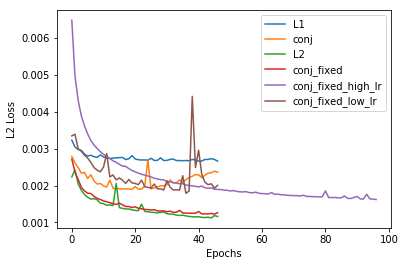

In [63]:
plt.plot(losses1[1][3:] , label = "L1")
plt.plot(losses2[1][3:] , label = "conj")
plt.plot(losses3[1][3:] , label = "L2")
plt.plot(losses4[1][3:] , label = "conj_fixed")
plt.plot(losses5[1][3:] , label = "conj_fixed_high_lr")
#plt.plot(losses6[1][3:] , label = "conj_fixed_fast_learning")
#plt.plot(losses7[1][20:] , label = "small iterations")
plt.plot(losses8[1][3:] , label = "conj_fixed_low_lr")
plt.xlabel("Epochs")
plt.ylabel("L2 Loss")
plt.legend()

In [71]:
losses = all_results[0]


In [38]:
losses1 = np.load("all_results.npy")[0]
losses2 = np.load("all_results2.npy")[0]
losses3 = np.load("all_results3.npy")[0]
losses4 = np.load("all_results4.npy")[0]
losses5 = np.load("all_Results5.npy")[0]
losses6 = np.load("all_Results6.npy")[0]
losses7 = np.load("all_Results7.npy")[0]
losses8 = np.load("all_Results8.npy")[0]
losses9 = np.load("all_Results9.npy")[0]

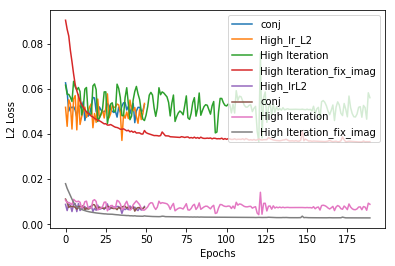

In [21]:
plt.plot(fixed_losses1[0] , label = "conj")
plt.plot(fixed_losses3[0] , label = "High_lr_L2")

# plt.plot(losses9[0] , label = "L2")
plt.plot(fixed_losses5[0][10:] , label = "High Iteration")
plt.plot(fixed_losses6[0][10:] , label = "High Iteration_fix_imag")

plt.plot(fixed_losses3[1] , label = "High_lrL2")
plt.plot(fixed_losses1[1] , label = "conj")
# plt.plot(losses9[1] , label = "L2")
plt.plot(fixed_losses5[1][10:], label= "High Iteration")
plt.plot(fixed_losses6[1][10:] , label = "High Iteration_fix_imag")


plt.xlabel("Epochs")
plt.ylabel("L2 Loss")
plt.legend()

In [15]:
fixed_losses1 = np.load("fixed_results1.npy")[0]
fixed_losses2 = np.load("fixed_results2.npy")[0]
fixed_losses3 = np.load("fixed_results3.npy")[0]
fixed_losses4 = np.load("fixed_results4.npy")[0]
fixed_losses5 = np.load("fixed_results5.npy")[0]
fixed_losses6 = np.load("fixed_results6.npy")[0]


0.022402901464975616
0.0013084419167872056


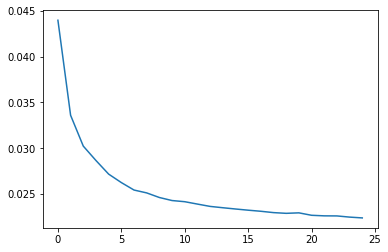

In [68]:
plt.plot(losses1[0] , label = "fixed")
print(min(losses1[0]))
print(min(losses1[1]))

start  0


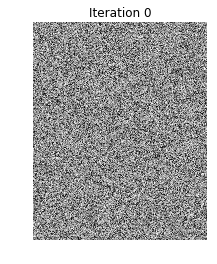

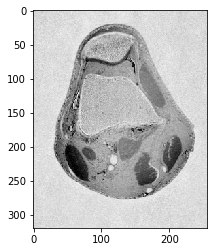

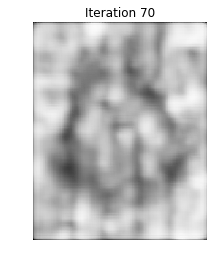

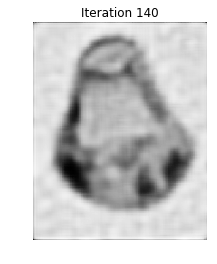

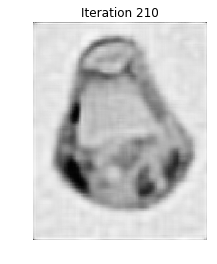

...

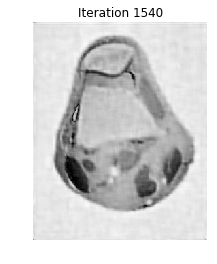

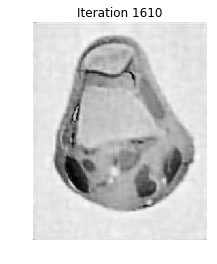

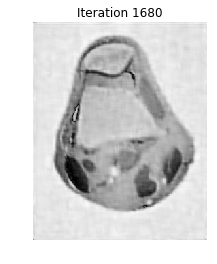

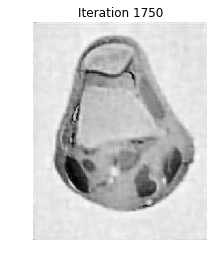

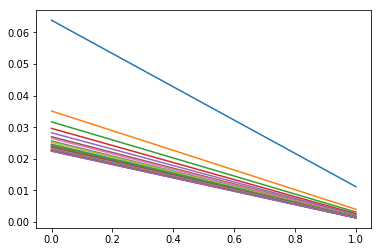

In [90]:
trials = 1
all_results = [[] for i in range(4)] # same image, diff image, 2 diff, 4 diff
for i in range(trials):
    noisy = np.random.random(size=(320, 256, 2)) * 2 - 1
    test_noise = np.random.random(size=(320, 256, 2)) * 2 - 1
    epochs = 5#70
    epochs1 = 70
    iters1 = 25
    iters = 25#50

    batch_size = 1
    print('start ' , i)
    noise = np.array([noisy for _ in range(batch_size)])
    jit_sched = [0.1 if k < iters // 2 else 0.01 for k in range(iters1)]
    
    normalized_img = get_batch_normalized_2chan([100])
    normalized_new_img = get_subsampled_normalized_2chan(get_image_normalized_2chan(100), 4)
    
    autoencoder = define_network_4_2chan(verbose=False)
    autoencoder.compile(Adam(1e-3), loss = recon_loss_L2_2chan)
    results, losses1, new_noise = train_network_2chan(autoencoder, noise, normalized_img, epochs1, iters1, normalized_img, [L1_loss , L2_loss], jitter_schedule=jit_sched, plot=True, batch_size=batch_size)
    plt.plot(losses1)
    
#     normalized_img = get_batch_normalized_2chan([100])
#     normalized_new_img = get_subsampled_normalized_2chan(get_image_normalized_2chan(100), 4)
    
#     autoencoder = define_network_4_2chan(verbose=False)
#     autoencoder.compile(Adam(1e-3), loss = recon_loss_L1_2chan)
#     results, losses2, new_noise = train_network_2chan(autoencoder, noise, normalized_img, epochs1, iters1, normalized_img, [L1_loss , L2_loss], jitter_schedule=jit_sched, plot=True, batch_size=batch_size)
#     plt.plot(losses2)
    
    
    
#     autoencoder.compile(Adam(1e-3), loss = recon_loss_L1_2chan)
#     jit_sched = [0.1 if k < iters // 2 else 0.01 for k in range(iters)]
#     normalized_img = get_image_normalized_2chan(100)
#     results, losses, _ = train_network_2chan(autoencoder, test_noise, normalized_new_img, epochs, iters, normalized_img, [L1_loss, L2_loss], jitter_schedule=jit_sched, plot=False)
  

#     autoencoder.compile(Adam(1e-4), loss = recon_loss_L1_2chan)
#     results, losses, _ = train_network_2chan(autoencoder, test_noise, normalized_new_img, epochs, iters, normalized_img, [L1_loss, L2_loss], jitter_schedule=jit_sched, plot=False)
#     all_results[0].append((results, losses))
    
    del autoencoder
    gc.collect()


0.022407507248262768
0.0013264260191624727


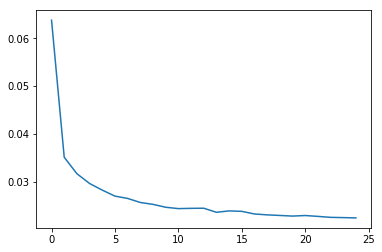

In [91]:
plt.plot(losses1[0] , label = "fixed")
print(min(losses1[0]))
print(min(losses1[1]))

In [18]:
def define_unet_4(verbose=False):
    inputs = Input((320, 256, 1))
    conv1 = Convolution2D(8, 3, padding = 'same', activation='relu', kernel_initializer='he_normal')(inputs)
    pool1 = MaxPooling2D(padding='same')(conv1)
    conv2 = Convolution2D(8, 3, padding = 'same', activation='relu', kernel_initializer='he_normal')(pool1)
    conv3 = Convolution2D(16, 3, padding = 'same', activation='relu', kernel_initializer='he_normal')(conv2)
    pool2 = MaxPooling2D(padding='same')(conv3)
    conv4 = Convolution2D(16, 3, padding = 'same', activation='relu', kernel_initializer='he_normal')(pool2)
    conv5 = Convolution2D(32, 3, padding = 'same', activation='relu', kernel_initializer='he_normal')(conv4)
    pool3 = MaxPooling2D(padding='same')(conv5)
    conv6 = Convolution2D(32, 3, padding = 'same', activation='relu', kernel_initializer='he_normal')(pool3)
    conv7 = Convolution2D(64, 3, padding = 'same', activation='relu', kernel_initializer='he_normal')(conv6)
    pool3 = MaxPooling2D(padding='same')(conv7)
    conv8 = Convolution2D(64, 3, padding = 'same', activation='relu', kernel_initializer='he_normal')(pool3)
    flat1 = Flatten()(conv8)
    dense1 = Dense(((320 // (2**4)) * (256 // (2**4))), activation = 'tanh')(flat1)
    dense1 = Reshape(((320 // (2**4)), (256 // (2**4)), 1))(dense1)
    conv9 = Convolution2D(128, 3, padding = 'same', activation='relu', kernel_initializer='he_normal')(dense1)
    conv10 = Convolution2D(128, 1, padding = 'same', activation='relu', kernel_initializer='he_normal')(conv9)
    ups1 = UpSampling2D()(conv10)
    conv11 = Convolution2D(64, 3, padding = 'same', activation='relu', kernel_initializer='he_normal')(ups1)
    merge1 = concatenate([conv11, conv7], axis = 3)
    conv12 = Convolution2D(64, 1, padding = 'same', activation='relu', kernel_initializer='he_normal')(merge1)
    ups2 = UpSampling2D()(conv12)
    conv13 = Convolution2D(32, 3, padding = 'same', activation='relu', kernel_initializer='he_normal')(ups2)
    merge2 = concatenate([conv13, conv5], axis = 3)
    conv14 = Convolution2D(32, 1, padding = 'same', activation='relu', kernel_initializer='he_normal')(merge2)
    ups3 = UpSampling2D()(conv14)
    conv15 = Convolution2D(16, 3, padding = 'same', activation='relu', kernel_initializer='he_normal')(ups3)
    merge3 = concatenate([conv15, conv3], axis = 3)
    conv16 = Convolution2D(16, 1, padding = 'same', activation='relu', kernel_initializer='he_normal')(merge3)
    ups4 = UpSampling2D()(conv16)
    conv17 = Convolution2D(1, 3, padding = 'same', activation='tanh', kernel_initializer='he_normal')(ups4)

    model = Model(inputs=inputs, outputs=conv17)
    if verbose:
        model.summary()
    return model